In [1]:
# Imp libs:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re

# Spliting data
from sklearn.model_selection import train_test_split,GridSearchCV

# Removing warnings
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [2]:
# storing file locations in variables

file1 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\01_District_wise_crimes_committed_IPC_2001_2012.csv'
file2 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\02_01_District_wise_crimes_committed_against_SC_2001_2012.csv'
file3 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\02_District_wise_crimes_committed_against_ST_2001_2012.csv'
file4 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\03_District_wise_crimes_committed_against_children_2001_2012.csv'
file5 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\08_01_Juvenile_apprehended_state_IPC_2001_2010.csv'
file6 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv'
file7 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\13_Police_killed_or_injured_on_duty2001_2010.csv'
file8 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\17_Case_reported_and_value_of_property_taken_away_by_place_of_occurrence_2001_2012.csv'
file9 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\17_Crime_by_place_of_occurrence_2001_2012.csv'
file10 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\35_Human_rights_violation_by_police_2001_2010.csv'
file11 = r'E:\DS Course Related\Capstone Project\India_Crime - Copy\42_District_wise_crimes_committed_against_women_2001_2012.csv'

# reading datasets

df1_ipc = pd.read_csv(file1)
df2_sc = pd.read_csv(file2)
df3_st  =pd.read_csv(file3)
df4_child = pd.read_csv(file4)
df5_juv = pd.read_csv(file5)
df6_prop_stolen = pd.read_csv(file6)
df7_police = pd.read_csv(file7)
df8_propval = pd.read_csv(file8)
df9_place = pd.read_csv(file9)
df10_hrvio = pd.read_csv(file10)
df11_women = pd.read_csv(file11)

df_list = [df1_ipc,df2_sc,df3_st,df4_child,df5_juv,df6_prop_stolen,df7_police,df8_propval,df9_place,df10_hrvio,df11_women]

In [3]:
for i in df_list:
    print('Column names in dataframe:', i.columns,'\n')
    print('Number of columns: ', len(i.columns),'\n\n')

Column names in dataframe: Index(['STATE/UT', 'DISTRICT', 'YEAR', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY',
       'PREPARATION AND ASSEMBLY FOR DACOITY', 'ROBBERY', 'BURGLARY', 'THEFT',
       'AUTO THEFT', 'OTHER THEFT', 'RIOTS', 'CRIMINAL BREACH OF TRUST',
       'CHEATING', 'COUNTERFIETING', 'ARSON', 'HURT/GREVIOUS HURT',
       'DOWRY DEATHS', 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY',
       'INSULT TO MODESTY OF WOMEN', 'CRUELTY BY HUSBAND OR HIS RELATIVES',
       'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
       'CAUSING DEATH BY NEGLIGENCE', 'OTHER IPC CRIMES', 'TOTAL IPC CRIMES'],
      dtype='object') 

Number of columns:  33 


Column names in dataframe: Index(['STATE/UT', 'DISTRICT', 'Year', 'Murder', 'Rape',
       'Kidnapping and Abdu

# Data Analysis

In [8]:
crimes = df1_ipc.columns[3:]

# District_wise_crimes_committed_IPC

In [9]:
states = ['ANDHRA PRADESH', 'ARUNACHAL PRADESH', 'ASSAM', 'BIHAR',
       'CHHATTISGARH', 'GOA', 'GUJARAT', 'HARYANA', 'HIMACHAL PRADESH',
       'JAMMU & KASHMIR', 'JHARKHAND', 'KARNATAKA', 'KERALA',
       'MADHYA PRADESH', 'MAHARASHTRA', 'MANIPUR', 'MEGHALAYA', 'MIZORAM',
       'NAGALAND', 'ODISHA', 'PUNJAB', 'RAJASTHAN', 'SIKKIM',
       'TAMIL NADU', 'TRIPURA', 'UTTAR PRADESH', 'UTTARAKHAND',
       'WEST BENGAL', 'A & N ISLANDS', 'CHANDIGARH', 'D & N HAVELI',
       'DAMAN & DIU', 'DELHI UT', 'LAKSHADWEEP', 'PUDUCHERRY']

# For ipc crimes:

ipc_crimes = pd.DataFrame()

for i in states:
    crimes_by_city = df1_ipc[df1_ipc['STATE/UT']== i]
    data = crimes_by_city.describe().T
    print('IPC crimes For city: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    ipc_crimes[i] = data[['max']]
    print('\n\n\n')    

IPC crimes For city:  ANDHRA PRADESH 

                                                         max
TOTAL IPC CRIMES                                    192522.0
HURT/GREVIOUS HURT                                   56768.0
OTHER IPC CRIMES                                     48087.0
THEFT                                                28267.0
OTHER THEFT                                          19439.0
CAUSING DEATH BY NEGLIGENCE                          14085.0
CRUELTY BY HUSBAND OR HIS RELATIVES                  13389.0
CHEATING                                             11002.0
BURGLARY                                              9050.0
AUTO THEFT                                            8966.0
ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MOD...    5147.0
INSULT TO MODESTY OF WOMEN                            4562.0
RIOTS                                                 3001.0
MURDER                                                2808.0
ATTEMPT TO MURDER                             

In [10]:
ipc_crimes.T.head()

,YEAR,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,KIDNAPPING AND ABDUCTION OF OTHERS,...,ARSON,HURT/GREVIOUS HURT,DOWRY DEATHS,ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY,INSULT TO MODESTY OF WOMEN,CRUELTY BY HUSBAND OR HIS RELATIVES,IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES,CAUSING DEATH BY NEGLIGENCE,OTHER IPC CRIMES,TOTAL IPC CRIMES
ANDHRA PRADESH,2012.0,2808.0,2229.0,171.0,1442.0,1.0,1442.0,2154.0,1612.0,701.0,...,1176.0,56768.0,613.0,5147.0,4562.0,13389.0,7.0,14085.0,48087.0,192522.0
ARUNACHAL PRADESH,2012.0,83.0,53.0,6.0,59.0,0.0,59.0,93.0,60.0,34.0,...,34.0,526.0,1.0,84.0,6.0,26.0,0.0,110.0,717.0,2439.0
ASSAM,2012.0,1426.0,670.0,117.0,1721.0,5.0,1716.0,3812.0,3360.0,626.0,...,2830.0,6676.0,175.0,1840.0,20.0,6407.0,3.0,3022.0,27077.0,77682.0
BIHAR,2012.0,3948.0,5452.0,396.0,1555.0,1.0,1555.0,4807.0,3789.0,2416.0,...,865.0,45827.0,1413.0,999.0,53.0,3686.0,83.0,5877.0,56508.0,146614.0
CHHATTISGARH,2012.0,1169.0,825.0,51.0,1053.0,0.0,1053.0,472.0,365.0,107.0,...,335.0,11105.0,128.0,1763.0,182.0,980.0,2.0,2907.0,25223.0,57218.0


In [11]:
ipc_crimes.T.columns[0]

'YEAR'

In [12]:
ipc_crimes.T['YEAR'].unique()

array([2012.])

# District_wise_crimes_committed_against_SC

In [13]:
# For sc crimes:

sc_crimes = pd.DataFrame()

for i in states:
    sc_by_city = df2_sc[df2_sc['STATE/UT'] == i]
    data = sc_by_city.describe().T
    print('Crimes against Sc in city: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    sc_crimes[i] = data[['max']]
    print('\n\n\n')

Crimes against Sc in city:  ANDHRA PRADESH 

                                         max
Year                                  2012.0
Other Crimes Against SCs              1874.0
Prevention of atrocities (POA) Act    1737.0
Hurt                                   722.0
Protection of Civil Rights (PCR) Act   459.0
Rape                                   131.0
Murder                                  64.0
Kidnapping and Abduction                28.0
Arson                                   20.0
Robbery                                 15.0
Dacoity                                  3.0




Crimes against Sc in city:  ARUNACHAL PRADESH 

                                         max
Year                                  2012.0
Murder                                   1.0
Robbery                                  1.0
Rape                                     0.0
Kidnapping and Abduction                 0.0
Dacoity                                  0.0
Arson                                    0.0
Hur

In [14]:
sc_crimes.T.head()

,Year,Murder,Rape,Kidnapping and Abduction,Dacoity,Robbery,Arson,Hurt,Prevention of atrocities (POA) Act,Protection of Civil Rights (PCR) Act,Other Crimes Against SCs
ANDHRA PRADESH,2012.0,64.0,131.0,28.0,3.0,15.0,20.0,722.0,1737.0,459.0,1874.0
ARUNACHAL PRADESH,2012.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
ASSAM,2012.0,21.0,16.0,27.0,5.0,11.0,7.0,114.0,2.0,1.0,103.0
BIHAR,2012.0,46.0,39.0,29.0,7.0,17.0,47.0,539.0,4436.0,113.0,661.0
CHHATTISGARH,2012.0,25.0,77.0,10.0,1.0,5.0,5.0,102.0,164.0,22.0,383.0


# District_wise_crimes_committed_against_ST

In [15]:
states = df3_st['STATE/UT'].unique()

In [16]:
# For st crimes:

st_crimes = pd.DataFrame()

for i in states:
    st_by_city = df3_st[df3_st['STATE/UT'] == i]
    data = st_by_city.describe().T
    print('Crimes against St in city: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    st_crimes[i] = data[['max']]
    print('\n\n\n')

Crimes against St in city:  ANDHRA PRADESH 

                                         max
Year                                  2012.0
Other Crimes Against STs               425.0
Prevention of atrocities (POA) Act     326.0
Hurt                                   134.0
Rape                                    60.0
Protection of Civil Rights (PCR) Act    39.0
Murder                                  16.0
Kidnapping Abduction                    10.0
Arson                                    4.0
Robbery                                  1.0
Dacoity                                  0.0




Crimes against St in city:  ARUNACHAL PRADESH 

                                         max
Year                                  2012.0
Other Crimes Against STs                57.0
Hurt                                    38.0
Kidnapping Abduction                    10.0
Rape                                     9.0
Murder                                   4.0
Robbery                                  2.0
Ars

In [17]:
st_crimes.T.head()

,Year,Murder,Rape,Kidnapping Abduction,Dacoity,Robbery,Arson,Hurt,Protection of Civil Rights (PCR) Act,Prevention of atrocities (POA) Act,Other Crimes Against STs
ANDHRA PRADESH,2012.0,16.0,60.0,10.0,0.0,1.0,4.0,134.0,39.0,326.0,425.0
ARUNACHAL PRADESH,2012.0,4.0,9.0,10.0,1.0,2.0,2.0,38.0,0.0,0.0,57.0
ASSAM,2012.0,26.0,24.0,24.0,5.0,14.0,9.0,71.0,1.0,1.0,71.0
BIHAR,2012.0,5.0,9.0,3.0,0.0,2.0,2.0,19.0,8.0,118.0,27.0
CHHATTISGARH,2012.0,32.0,118.0,14.0,9.0,7.0,10.0,109.0,3.0,221.0,363.0


# District_wise_crimes_committed_against_children:

In [18]:
# For child crimes:

child_crimes = pd.DataFrame()

for i in states:
    x = df4_child[df4_child['STATE/UT'] == i]
    data = x.describe().T
    print('Crimes against child in city: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    child_crimes[i] = data[['max']]
    print('\n\n\n')

Crimes against child in city:  ANDHRA PRADESH 

                                      max
Total                              2274.0
Year                               2012.0
Kidnapping and Abduction            781.0
Rape                                646.0
Other Crimes                        633.0
Murder                              119.0
Procuration of minor girls          106.0
Exposure and abandonment             99.0
Prohibition of child marriage act    29.0
Abetment of suicide                  21.0
Selling of girls for prostitution    11.0
Buying of girls for prostitution      9.0
Foeticide                             7.0




Crimes against child in city:  ARUNACHAL PRADESH 

                                      max
Year                               2012.0
Total                                39.0
Kidnapping and Abduction             27.0
Rape                                 20.0
Other Crimes                          3.0
Murder                                0.0
Foeticide      

In [19]:
child_crimes.T.head()

,Year,Murder,Rape,Kidnapping and Abduction,Foeticide,Abetment of suicide,Exposure and abandonment,Procuration of minor girls,Buying of girls for prostitution,Selling of girls for prostitution,Prohibition of child marriage act,Other Crimes,Total
ANDHRA PRADESH,2012.0,119.0,646.0,781.0,7.0,21.0,99.0,106.0,9.0,11.0,29.0,633.0,2274.0
ARUNACHAL PRADESH,2012.0,0.0,20.0,27.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,39.0
ASSAM,2012.0,15.0,156.0,68.0,1.0,5.0,0.0,142.0,0.0,3.0,1.0,147.0,392.0
BIHAR,2012.0,202.0,137.0,2546.0,5.0,0.0,1.0,183.0,2.0,10.0,16.0,42.0,2894.0
CHHATTISGARH,2012.0,69.0,519.0,283.0,21.0,10.0,17.0,15.0,0.0,1.0,26.0,978.0,1881.0


# Juvenile_apprehended_state_IPC

In [20]:
states = df5_juv['STATE/UT'].unique()
states

array(['Andhra Pradesh', 'Arunachal Pradesh', 'Assam', 'Bihar',
       'Chhattisgarh', 'Goa', 'Gujarat', 'Haryana', 'Himachal Pradesh',
       'Jammu & Kashmir', 'Jharkhand', 'Karnataka', 'Kerala',
       'Madhya Pradesh', 'Maharashtra', 'Manipur', 'Meghalaya', 'Mizoram',
       'Nagaland', 'Odisha', 'Punjab', 'Rajasthan', 'Sikkim',
       'Tamil Nadu', 'Tripura', 'Uttar Pradesh', 'Uttarakhand',
       'West Bengal', 'A&N Islands', 'Chandigarh', 'D&N Haveli',
       'Daman & Diu', 'Delhi UT', 'Lakshadweep', 'Puducherry'],
      dtype=object)

In [21]:
df5_juv.head()

,STATE/UT,Year,CRIME,Boys 7-12 Years,Girls 7-12 Years,Boys 12-16 Years,Girls 12-16 Years,Boys 16-18 Years,Girls 16-18 Years,Total for boys all Age Groups,Total for girls all Age Groups,Grand total
0,Andhra Pradesh,2001,Murder,3,0,7,0,5,0,15,0,15
1,Andhra Pradesh,2001,Attempt to Commit Murder,2,0,0,0,11,0,13,0,13
2,Andhra Pradesh,2001,C H Not amounting to Murder,0,0,0,0,0,0,0,0,0
3,Andhra Pradesh,2001,Rape,2,0,15,0,2,1,19,1,20
4,Andhra Pradesh,2001,Custodial Rape,0,0,0,0,0,0,0,0,0


In [22]:
# For juvinile crimes:

juv_crimes = pd.DataFrame()

for i in states:
    x = df5_juv[df5_juv['STATE/UT'] == i]
    data = x.describe().T
    print('Juvenile_apprehended_state_IPC in city: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    juv_crimes[i] = data[['max']]
    print('\n\n\n')

Juvenile_apprehended_state_IPC in city:  Andhra Pradesh 

                                   max
Year                            2010.0
Grand total                     1863.0
Total for boys all Age Groups   1806.0
Boys 16-18 Years                1216.0
Boys 12-16 Years                 734.0
Total for girls all Age Groups   171.0
Girls 16-18 Years                129.0
Boys 7-12 Years                  112.0
Girls 12-16 Years                 37.0
Girls 7-12 Years                   5.0




Juvenile_apprehended_state_IPC in city:  Arunachal Pradesh 

                                   max
Year                            2010.0
Grand total                      196.0
Total for boys all Age Groups    195.0
Boys 16-18 Years                 100.0
Boys 12-16 Years                  88.0
Boys 7-12 Years                   18.0
Total for girls all Age Groups     6.0
Girls 16-18 Years                  5.0
Girls 7-12 Years                   1.0
Girls 12-16 Years                  1.0




Juvenile_appreh

In [23]:
juv_crimes.T.head()

,Year,Boys 7-12 Years,Girls 7-12 Years,Boys 12-16 Years,Girls 12-16 Years,Boys 16-18 Years,Girls 16-18 Years,Total for boys all Age Groups,Total for girls all Age Groups,Grand total
Andhra Pradesh,2010.0,112.0,5.0,734.0,37.0,1216.0,129.0,1806.0,171.0,1863.0
Arunachal Pradesh,2010.0,18.0,1.0,88.0,1.0,100.0,5.0,195.0,6.0,196.0
Assam,2010.0,124.0,14.0,396.0,60.0,484.0,81.0,1004.0,151.0,1155.0
Bihar,2010.0,14.0,3.0,258.0,16.0,1195.0,75.0,1349.0,80.0,1396.0
Chhattisgarh,2010.0,133.0,47.0,1317.0,62.0,1456.0,56.0,2737.0,123.0,2860.0


# Property_stolen_and_recovered_nature_of_property:

In [24]:
# For prop_stolen crimes:

areas = df6_prop_stolen['Area_Name'].unique()

prop_stolen_crimes = pd.DataFrame()

for i in areas:
    x = df6_prop_stolen[df6_prop_stolen['Area_Name'] == i]
    data = x.describe().T
    print('prop_stolen Crimes in area: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    prop_stolen_crimes[i] = data[['max']]
    print('\n\n\n')

prop_stolen Crimes in area:  Andaman & Nicobar Islands 

                                     max
Value_of_Property_Stolen     261703281.0
Value_of_Property_Recovered    6081185.0
Year                              2010.0
Cases_Property_Stolen              238.0
Cases_Property_Recovered           112.0




prop_stolen Crimes in area:  Andhra Pradesh 

                                      max
Value_of_Property_Stolen     1.533055e+09
Value_of_Property_Recovered  7.250797e+08
Cases_Property_Stolen        3.640700e+04
Cases_Property_Recovered     1.984800e+04
Year                         2.010000e+03




prop_stolen Crimes in area:  Arunachal Pradesh 

                                     max
Value_of_Property_Stolen     246090594.0
Value_of_Property_Recovered  168882335.0
Year                              2010.0
Cases_Property_Stolen              949.0
Cases_Property_Recovered           401.0




prop_stolen Crimes in area:  Assam 

                                     max
Value_of_Prope

In [25]:
prop_stolen_crimes.T.head()

,Year,Cases_Property_Recovered,Cases_Property_Stolen,Value_of_Property_Recovered,Value_of_Property_Stolen
Andaman & Nicobar Islands,2010.0,112.0,238.0,6081185.0,2.617033e+08
Andhra Pradesh,2010.0,19848.0,36407.0,725079668.0,1.533055e+09
Arunachal Pradesh,2010.0,401.0,949.0,168882335.0,2.460906e+08
Assam,2010.0,3857.0,17809.0,181939717.0,5.254641e+08
Bihar,2010.0,3414.0,23314.0,74962835.0,5.479247e+08


# For crimes against police:

In [26]:
# For prop_stolen crimes:

areas = df7_police['Area_Name'].unique()

police_crimes = pd.DataFrame()

for i in areas:
    x = df7_police[df7_police['Area_Name'] == i]
    data = x.describe().T
    print('Crimes against police in area: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    police_crimes[i] = data[['max']]
    print('\n\n\n')

Crimes against police in area:  Andaman & Nicobar Islands 

                                                      max
Year                                               2010.0
Police_Injured_By_Criminals                           6.0
Police_Injured_Total_Policemen                        6.0
Police_Killed_In_Accidents                            3.0
Police_Killed_Total_Policemen                         3.0
Police_Killed_By_Criminals                            1.0
Police_Injured_By_Riotous_Mobs                        0.0
Police_Injured_In_Accidents                           0.0
Police_Injured_In_Dacoity_OperationsOther_raids       0.0
Police_Injured_In_TerroristsExtremists_Operations     0.0
Police_Injured_On_Border_Duties                       0.0
Police_Killed_By_Riotous_Mobs                         0.0
Police_Killed_In_Dacoity_OperationsOther_raids        0.0
Police_Killed_In_TerroristsExtremists_Operations      0.0
Police_Killed_On_Border_Duties                        0.0




Crimes a

In [27]:
police_crimes.T.head()

,Year,Police_Injured_By_Criminals,Police_Injured_By_Riotous_Mobs,Police_Injured_In_Accidents,Police_Injured_In_Dacoity_OperationsOther_raids,Police_Injured_In_TerroristsExtremists_Operations,Police_Injured_On_Border_Duties,Police_Injured_Total_Policemen,Police_Killed_By_Criminals,Police_Killed_By_Riotous_Mobs,Police_Killed_In_Accidents,Police_Killed_In_Dacoity_OperationsOther_raids,Police_Killed_In_TerroristsExtremists_Operations,Police_Killed_On_Border_Duties,Police_Killed_Total_Policemen
Andaman & Nicobar Islands,2010.0,6.0,0.0,0.0,0.0,0.0,0.0,6.0,1.0,0.0,3.0,0.0,0.0,0.0,3.0
Andhra Pradesh,2010.0,22.0,133.0,121.0,28.0,45.0,1.0,286.0,4.0,4.0,53.0,4.0,31.0,1.0,70.0
Arunachal Pradesh,2010.0,5.0,10.0,0.0,15.0,1.0,0.0,16.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
Assam,2010.0,9.0,22.0,10.0,4.0,41.0,17.0,55.0,5.0,9.0,6.0,12.0,24.0,2.0,34.0
Bihar,2010.0,16.0,22.0,27.0,7.0,19.0,13.0,50.0,15.0,5.0,13.0,3.0,17.0,12.0,38.0


# For value_of_property_taken_away_by_place_of_occurrence crimes:

In [28]:
# For value_of_property_taken_away_by_place_of_occurrence crimes:

states = df8_propval['STATE/UT'].unique()

propval_crimes = pd.DataFrame()

for i in states:
    x = df8_propval[df8_propval['STATE/UT'] == i]
    data = x.describe().T
    print('value_of_property_taken_away_by_place_of_occurrence in area: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    propval_crimes[i] = data[['max']]
    print('\n\n\n')

value_of_property_taken_away_by_place_of_occurrence in area:  Andhra Pradesh 

                                                             max
Theft (Section 379-382 IPC) - Value Of Property...  1.213433e+09
Burglary(Section 449-452, 454, 455, 457-460 IPC...  5.846936e+08
Dacoity (Section 395-398 IPC) - Value Of Proper...  1.187485e+08
Robbery(Section 392-394, 397, 398 IPC) - Value ...  8.313000e+07
Theft (Section 379-382 IPC) - Number of cases r...  2.826700e+04
Burglary(Section 449-452, 454, 455, 457-460 IPC...  9.050000e+03
YEAR                                                2.012000e+03
Robbery(Section 392-394, 397, 398 IPC) - Number...  7.940000e+02
Dacoity (Section 395-398 IPC) - Number of cases...  2.500000e+02




value_of_property_taken_away_by_place_of_occurrence in area:  Arunachal Pradesh 

                                                            max
Dacoity (Section 395-398 IPC) - Value Of Proper...  217041067.0
Burglary(Section 449-452, 454, 455, 457-460 IPC...  15972

In [29]:
propval_crimes.T.head()

,YEAR,Dacoity (Section 395-398 IPC) - Number of cases registered,Dacoity (Section 395-398 IPC) - Value Of Property Stolen (in rupees),"Robbery(Section 392-394, 397, 398 IPC) - Number of cases registered","Robbery(Section 392-394, 397, 398 IPC) - Value Of Property Stolen (in rupees)","Burglary(Section 449-452, 454, 455, 457-460 IPC) - Number of cases registered","Burglary(Section 449-452, 454, 455, 457-460 IPC) - Value Of Property Stolen (in rupees)",Theft (Section 379-382 IPC) - Number of cases registered,Theft (Section 379-382 IPC) - Value Of Property Stolen (in rupees)
Andhra Pradesh,2012.0,250.0,118748535.0,794.0,83129996.0,9050.0,584693596.0,28267.0,1.213433e+09
Arunachal Pradesh,2012.0,37.0,217041067.0,96.0,8708070.0,263.0,159726496.0,531.0,1.597262e+08
Assam,2012.0,532.0,49749892.0,907.0,27004505.0,3825.0,88774425.0,9394.0,3.633586e+08
Bihar,2012.0,1319.0,83753630.0,2986.0,99789799.0,3758.0,61398610.0,17667.0,4.987565e+08
Chhattisgarh,2012.0,204.0,42282293.0,554.0,35695139.0,4144.0,114358196.0,6079.0,2.476637e+08


# For Crime_by_place_of_occurrence:

In [30]:
# For Crime_by_place_of_occurrence:

states = df9_place['STATE/UT'].unique()

place_crimes = pd.DataFrame()

for i in states:
    x = df9_place[df9_place['STATE/UT'] == i]
    data = x.describe().T
    print('Crime_by_place_of_occurrence in area: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    place_crimes[i] = data[['max']]
    print('\n\n\n')

Crime_by_place_of_occurrence in area:  ANDHRA PRADESH 

                                          max
TOTAL - Theft                         28267.0
OTHER PLACES - Theft                  14693.0
RESIDENTIAL PREMISES - Theft           9766.0
TOTAL - Burglary                       9050.0
RESIDENTIAL PREMISES - Burglary        6504.0
COMMERCIAL ESTABLISHMENTS - Theft      3445.0
YEAR                                   2012.0
OTHER PLACES - Burglary                1762.0
RAILWAYS - Theft                       1685.0
COMMERCIAL ESTABLISHMENTS - Burglary   1330.0
HIGHWAYS - Theft                        842.0
TOTAL - Robbery                         794.0
OTHER PLACES - Robbery                  331.0
RESIDENTIAL PREMISES - Robbery          262.0
TOTAL - Dacoity                         250.0
HIGHWAYS - Robbery                      172.0
HIGHWAYS - Burglary                     172.0
RESIDENTIAL PREMISES - Dacoity          120.0
RIVER and SEA - Theft                   110.0
RIVER and SEA - Burglary

In [31]:
place_crimes.T.head()

,YEAR,RESIDENTIAL PREMISES - Dacoity,RESIDENTIAL PREMISES - Robbery,RESIDENTIAL PREMISES - Burglary,RESIDENTIAL PREMISES - Theft,HIGHWAYS - Dacoity,HIGHWAYS - Robbery,HIGHWAYS - Burglary,HIGHWAYS - Theft,RIVER and SEA - Dacoity,...,COMMERCIAL ESTABLISHMENTS - Burglary,COMMERCIAL ESTABLISHMENTS - Theft,OTHER PLACES - Dacoity,OTHER PLACES - Robbery,OTHER PLACES - Burglary,OTHER PLACES - Theft,TOTAL - Dacoity,TOTAL - Robbery,TOTAL - Burglary,TOTAL - Theft
ANDHRA PRADESH,2012.0,120.0,262.0,6504.0,9766.0,59.0,172.0,172.0,842.0,2.0,...,1330.0,3445.0,77.0,331.0,1762.0,14693.0,250.0,794.0,9050.0,28267.0
ARUNACHAL PRADESH,2012.0,19.0,75.0,195.0,297.0,5.0,15.0,3.0,23.0,0.0,...,84.0,99.0,18.0,41.0,89.0,249.0,37.0,96.0,263.0,531.0
ASSAM,2012.0,381.0,337.0,2166.0,4265.0,49.0,136.0,157.0,385.0,6.0,...,674.0,1257.0,108.0,646.0,2105.0,5401.0,532.0,907.0,3825.0,9394.0
BIHAR,2012.0,833.0,436.0,3077.0,6740.0,207.0,1396.0,147.0,650.0,1.0,...,330.0,1918.0,210.0,1084.0,753.0,7354.0,1319.0,2986.0,3758.0,17667.0
CHHATTISGARH,2012.0,78.0,74.0,3336.0,1623.0,24.0,115.0,234.0,144.0,2.0,...,511.0,571.0,89.0,403.0,604.0,3985.0,204.0,554.0,4144.0,6079.0


# For Human_rights_violation_by_police:

In [32]:
# For Human_rights_violation_by_police:

Area_Name = df10_hrvio['Area_Name'].unique()

hrvio_crimes = pd.DataFrame()

for i in Area_Name:
    x = df10_hrvio[df10_hrvio['Area_Name'] == i]
    data = x.describe().T
    print('Human_rights_violation_by_police in area: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    hrvio_crimes[i] = data[['max']]
    print('\n\n\n')

Human_rights_violation_by_police in area:  Andhra Pradesh 

                                                   max
Year                                            2010.0
Cases_Registered_under_Human_Rights_Violations    45.0
Policemen_Chargesheeted                           29.0
Policemen_Convicted                                2.0




Human_rights_violation_by_police in area:  Arunachal Pradesh 

                                                   max
Year                                            2010.0
Cases_Registered_under_Human_Rights_Violations    11.0
Policemen_Chargesheeted                            6.0
Policemen_Convicted                                0.0




Human_rights_violation_by_police in area:  Assam 

                                                   max
Year                                            2010.0
Cases_Registered_under_Human_Rights_Violations    96.0
Policemen_Chargesheeted                            2.0
Policemen_Convicted                             

In [33]:
hrvio_crimes.T.head()

,Year,Cases_Registered_under_Human_Rights_Violations,Policemen_Chargesheeted,Policemen_Convicted
Andhra Pradesh,2010.0,45.0,29.0,2.0
Arunachal Pradesh,2010.0,11.0,6.0,0.0
Assam,2010.0,96.0,2.0,0.0
Bihar,2010.0,9.0,5.0,4.0
Chandigarh,2009.0,1.0,0.0,0.0


# For District_wise_crimes_committed_against_women:

In [34]:
# For District_wise_crimes_committed_against_women:

states = df11_women['STATE/UT'].unique()

women_crimes = pd.DataFrame()

for i in states:
    x = df11_women[df11_women['STATE/UT'] == i]
    data = x.describe().T
    print('District_wise_crimes_committed_against_women in area: ', i,'\n')
    print(data[['max']].sort_values(by='max',ascending=False))
    women_crimes[i] = data[['max']]
    print('\n\n\n')

District_wise_crimes_committed_against_women in area:  ANDHRA PRADESH 

                                                        max
Cruelty by Husband or his Relatives                 13389.0
Assault on women with intent to outrage her mod...   5147.0
Insult to modesty of Women                           4562.0
Year                                                 2012.0
Kidnapping and Abduction                             1612.0
Rape                                                 1442.0
Dowry Deaths                                          613.0
Importation of Girls                                    7.0




District_wise_crimes_committed_against_women in area:  ARUNACHAL PRADESH 

                                                       max
Year                                                2012.0
Assault on women with intent to outrage her mod...    84.0
Kidnapping and Abduction                              60.0
Rape                                                  59.0
Cruelty by Hus

In [35]:
women_crimes.T.head()

,Year,Rape,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls
ANDHRA PRADESH,2012.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0
ARUNACHAL PRADESH,2012.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0
ASSAM,2012.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0
BIHAR,2012.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0
CHHATTISGARH,2012.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0


# Merging all Crimes dataframes together:

In [36]:
corrected_state_names = []

for i in hrvio_crimes.columns:
    corrected_state_names.append(i.upper())

hrvio_crimes.columns = corrected_state_names

hrvio_crimes.T.sort_index(axis=0)

,Year,Cases_Registered_under_Human_Rights_Violations,Policemen_Chargesheeted,Policemen_Convicted
ANDHRA PRADESH,2010.0,45.0,29.0,2.0
ARUNACHAL PRADESH,2010.0,11.0,6.0,0.0
ASSAM,2010.0,96.0,2.0,0.0
BIHAR,2010.0,9.0,5.0,4.0
CHANDIGARH,2009.0,1.0,0.0,0.0
CHHATTISGARH,2010.0,233.0,67.0,54.0
DAMAN & DIU,2003.0,0.0,0.0,0.0
DELHI,2009.0,6.0,7.0,NaN
GOA,2010.0,1.0,1.0,NaN
GUJARAT,2010.0,21.0,20.0,0.0


In [37]:
corrected_state_names = []

for i in police_crimes.columns:
    corrected_state_names.append(i.upper())

police_crimes.columns = corrected_state_names

police_crimes.T.sort_index(axis=0).head()

,Year,Police_Injured_By_Criminals,Police_Injured_By_Riotous_Mobs,Police_Injured_In_Accidents,Police_Injured_In_Dacoity_OperationsOther_raids,Police_Injured_In_TerroristsExtremists_Operations,Police_Injured_On_Border_Duties,Police_Injured_Total_Policemen,Police_Killed_By_Criminals,Police_Killed_By_Riotous_Mobs,Police_Killed_In_Accidents,Police_Killed_In_Dacoity_OperationsOther_raids,Police_Killed_In_TerroristsExtremists_Operations,Police_Killed_On_Border_Duties,Police_Killed_Total_Policemen
ANDAMAN & NICOBAR ISLANDS,2010.0,6.0,0.0,0.0,0.0,0.0,0.0,6.0,1.0,0.0,3.0,0.0,0.0,0.0,3.0
ANDHRA PRADESH,2010.0,22.0,133.0,121.0,28.0,45.0,1.0,286.0,4.0,4.0,53.0,4.0,31.0,1.0,70.0
ARUNACHAL PRADESH,2010.0,5.0,10.0,0.0,15.0,1.0,0.0,16.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
ASSAM,2010.0,9.0,22.0,10.0,4.0,41.0,17.0,55.0,5.0,9.0,6.0,12.0,24.0,2.0,34.0
BIHAR,2010.0,16.0,22.0,27.0,7.0,19.0,13.0,50.0,15.0,5.0,13.0,3.0,17.0,12.0,38.0


In [38]:
corrected_state_names

['ANDAMAN & NICOBAR ISLANDS',
 'ANDHRA PRADESH',
 'ARUNACHAL PRADESH',
 'ASSAM',
 'BIHAR',
 'CHANDIGARH',
 'CHHATTISGARH',
 'DADRA & NAGAR HAVELI',
 'DAMAN & DIU',
 'DELHI',
 'GOA',
 'GUJARAT',
 'HARYANA',
 'HIMACHAL PRADESH',
 'JAMMU & KASHMIR',
 'JHARKHAND',
 'KARNATAKA',
 'KERALA',
 'LAKSHADWEEP',
 'MADHYA PRADESH',
 'MAHARASHTRA',
 'MANIPUR',
 'MEGHALAYA',
 'MIZORAM',
 'NAGALAND',
 'ODISHA',
 'PUDUCHERRY',
 'PUNJAB',
 'RAJASTHAN',
 'SIKKIM',
 'TAMIL NADU',
 'TRIPURA',
 'UTTAR PRADESH',
 'UTTARAKHAND',
 'WEST BENGAL']

In [39]:
corrected_state_names = []

for i in prop_stolen_crimes.columns:
    corrected_state_names.append(i.upper())

prop_stolen_crimes.columns = corrected_state_names

prop_stolen_crimes.T.sort_index(axis=0)

,Year,Cases_Property_Recovered,Cases_Property_Stolen,Value_of_Property_Recovered,Value_of_Property_Stolen
ANDAMAN & NICOBAR ISLANDS,2010.0,112.0,238.0,6.081185e+06,2.617033e+08
ANDHRA PRADESH,2010.0,19848.0,36407.0,7.250797e+08,1.533055e+09
ARUNACHAL PRADESH,2010.0,401.0,949.0,1.688823e+08,2.460906e+08
ASSAM,2010.0,3857.0,17809.0,1.819397e+08,5.254641e+08
BIHAR,2010.0,3414.0,23314.0,7.496284e+07,5.479247e+08
CHANDIGARH,2010.0,849.0,2529.0,5.220391e+07,1.204376e+08
CHHATTISGARH,2010.0,3792.0,11111.0,1.440469e+08,4.729642e+08
DADRA & NAGAR HAVELI,2010.0,69.0,154.0,3.892481e+07,6.187516e+08
DAMAN & DIU,2010.0,44.0,144.0,7.758679e+06,4.659750e+07
DELHI,2010.0,10505.0,28118.0,2.445795e+08,7.785717e+09


In [40]:
dataset_of_crimes_by_states = [ipc_crimes,sc_crimes,st_crimes,child_crimes,juv_crimes,prop_stolen_crimes,police_crimes,propval_crimes,place_crimes,hrvio_crimes,women_crimes]

juv_crimes.columns = child_crimes.columns
women_crimes.columns = child_crimes.columns
# place_crimes.columns = child_crimes.columns
# hrvio_crimes.columns = child_crimes.columns
propval_crimes.columns = child_crimes.columns

In [112]:
mer_df = pd.merge(ipc_crimes.T,sc_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,st_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,child_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,juv_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,prop_stolen_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,police_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,place_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,hrvio_crimes.T, left_index=True, right_index=True,how='outer')
mer_df = pd.merge(mer_df,women_crimes.T, left_index=True, right_index=True,how='outer')

crimes_in_states = mer_df.T

In [113]:
crimes_in_states.drop(columns=['TOTAL (UTs)','TOTAL (STATES)','TOTAL (ALL-INDIA)','DADRA & NAGAR HAVELI','ANDAMAN & NICOBAR ISLANDS'],axis=1,inplace=True)

In [114]:
crimes_in_states

,A & N ISLANDS,ANDHRA PRADESH,ARUNACHAL PRADESH,ASSAM,BIHAR,CHANDIGARH,CHHATTISGARH,D & N HAVELI,DAMAN & DIU,DELHI,...,ODISHA,PUDUCHERRY,PUNJAB,RAJASTHAN,SIKKIM,TAMIL NADU,TRIPURA,UTTAR PRADESH,UTTARAKHAND,WEST BENGAL
YEAR_x,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,NaN,...,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0
MURDER,21.0,2808.0,83.0,1426.0,3948.0,31.0,1169.0,14.0,12.0,NaN,...,1548.0,37.0,907.0,1461.0,21.0,1949.0,254.0,7601.0,316.0,2398.0
ATTEMPT TO MURDER,19.0,2229.0,53.0,670.0,5452.0,44.0,825.0,5.0,7.0,NaN,...,1879.0,43.0,1045.0,2043.0,16.0,2962.0,87.0,7964.0,279.0,2854.0
CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,4.0,171.0,6.0,117.0,396.0,10.0,51.0,1.0,1.0,NaN,...,188.0,16.0,216.0,104.0,8.0,44.0,8.0,1616.0,60.0,931.0
RAPE,24.0,1442.0,59.0,1721.0,1555.0,33.0,1053.0,7.0,5.0,NaN,...,1458.0,13.0,680.0,2049.0,34.0,737.0,238.0,2042.0,148.0,2363.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Dowry Deaths,2.0,613.0,1.0,175.0,1413.0,10.0,128.0,1.0,1.0,143.0,...,525.0,6.0,166.0,514.0,1.0,243.0,37.0,2322.0,94.0,593.0
Assault on women with intent to outrage her modesty,31.0,5147.0,84.0,1840.0,999.0,45.0,1763.0,11.0,4.0,868.0,...,4187.0,89.0,427.0,2878.0,40.0,2022.0,384.0,3455.0,153.0,3345.0
Insult to modesty of Women,10.0,4562.0,6.0,20.0,53.0,28.0,182.0,2.0,1.0,225.0,...,458.0,39.0,199.0,56.0,14.0,1718.0,9.0,4970.0,306.0,556.0
Cruelty by Husband or his Relatives,26.0,13389.0,26.0,6407.0,3686.0,112.0,980.0,5.0,5.0,1985.0,...,2638.0,19.0,1293.0,13312.0,7.0,1976.0,937.0,8566.0,463.0,19865.0


In [115]:
crimes_in_states.fillna(0, inplace=True)

In [116]:
crimes_in_states['DELHI/UT'] = crimes_in_states['DELHI'] + crimes_in_states['DELHI UT']

In [117]:
crimes_in_states.drop(columns=['DELHI','DELHI UT'],axis=1,inplace=True)

In [118]:
cols_to_drop = crimes_in_states.filter(regex='^(Year|YEAR)').columns

# drop the selected columns from the dataframe
crimes_in_states.drop(cols_to_drop, axis=1, inplace=True)

crimes_in_states

,A & N ISLANDS,ANDHRA PRADESH,ARUNACHAL PRADESH,ASSAM,BIHAR,CHANDIGARH,CHHATTISGARH,D & N HAVELI,DAMAN & DIU,GOA,...,PUDUCHERRY,PUNJAB,RAJASTHAN,SIKKIM,TAMIL NADU,TRIPURA,UTTAR PRADESH,UTTARAKHAND,WEST BENGAL,DELHI/UT
YEAR_x,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,...,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0,2012.0
MURDER,21.0,2808.0,83.0,1426.0,3948.0,31.0,1169.0,14.0,12.0,53.0,...,37.0,907.0,1461.0,21.0,1949.0,254.0,7601.0,316.0,2398.0,565.0
ATTEMPT TO MURDER,19.0,2229.0,53.0,670.0,5452.0,44.0,825.0,5.0,7.0,35.0,...,43.0,1045.0,2043.0,16.0,2962.0,87.0,7964.0,279.0,2854.0,530.0
CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,4.0,171.0,6.0,117.0,396.0,10.0,51.0,1.0,1.0,11.0,...,16.0,216.0,104.0,8.0,44.0,8.0,1616.0,60.0,931.0,94.0
RAPE,24.0,1442.0,59.0,1721.0,1555.0,33.0,1053.0,7.0,5.0,55.0,...,13.0,680.0,2049.0,34.0,737.0,238.0,2042.0,148.0,2363.0,706.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Dowry Deaths,2.0,613.0,1.0,175.0,1413.0,10.0,128.0,1.0,1.0,3.0,...,6.0,166.0,514.0,1.0,243.0,37.0,2322.0,94.0,593.0,143.0
Assault on women with intent to outrage her modesty,31.0,5147.0,84.0,1840.0,999.0,45.0,1763.0,11.0,4.0,49.0,...,89.0,427.0,2878.0,40.0,2022.0,384.0,3455.0,153.0,3345.0,868.0
Insult to modesty of Women,10.0,4562.0,6.0,20.0,53.0,28.0,182.0,2.0,1.0,16.0,...,39.0,199.0,56.0,14.0,1718.0,9.0,4970.0,306.0,556.0,225.0
Cruelty by Husband or his Relatives,26.0,13389.0,26.0,6407.0,3686.0,112.0,980.0,5.0,5.0,24.0,...,19.0,1293.0,13312.0,7.0,1976.0,937.0,8566.0,463.0,19865.0,1985.0


In [194]:
index_values = crimes_in_states.T.index.values

print(index_values)

['A & N ISLANDS' 'ANDHRA PRADESH' 'ARUNACHAL PRADESH' 'ASSAM' 'BIHAR'
 'CHANDIGARH' 'CHHATTISGARH' 'D & N HAVELI' 'DAMAN & DIU' 'GOA' 'GUJARAT'
 'HARYANA' 'HIMACHAL PRADESH' 'JAMMU & KASHMIR' 'JHARKHAND' 'KARNATAKA'
 'KERALA' 'LAKSHADWEEP' 'MADHYA PRADESH' 'MAHARASHTRA' 'MANIPUR'
 'MEGHALAYA' 'MIZORAM' 'NAGALAND' 'ODISHA' 'PUDUCHERRY' 'PUNJAB'
 'RAJASTHAN' 'SIKKIM' 'TAMIL NADU' 'TRIPURA' 'UTTAR PRADESH' 'UTTARAKHAND'
 'WEST BENGAL' 'DELHI/UT']


In [120]:
crimes_in_states_transposed = crimes_in_states.T

In [121]:
crimes_in_states_transposed['State/UT'] = index_values

In [122]:
crimes_in_states.shape

(141, 35)

In [123]:
crimes_in_states_transposed

,YEAR_x,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,KIDNAPPING AND ABDUCTION OF OTHERS,...,Policemen_Convicted,Year_y,Rape_y,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,State/UT
A & N ISLANDS,2012.0,21.0,19.0,4.0,24.0,0.0,24.0,17.0,14.0,4.0,...,0.0,2012.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0,A & N ISLANDS
ANDHRA PRADESH,2012.0,2808.0,2229.0,171.0,1442.0,1.0,1442.0,2154.0,1612.0,701.0,...,2.0,2012.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0,ANDHRA PRADESH
ARUNACHAL PRADESH,2012.0,83.0,53.0,6.0,59.0,0.0,59.0,93.0,60.0,34.0,...,0.0,2012.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0,ARUNACHAL PRADESH
ASSAM,2012.0,1426.0,670.0,117.0,1721.0,5.0,1716.0,3812.0,3360.0,626.0,...,0.0,2012.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0,ASSAM
BIHAR,2012.0,3948.0,5452.0,396.0,1555.0,1.0,1555.0,4807.0,3789.0,2416.0,...,4.0,2012.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0,BIHAR
CHANDIGARH,2012.0,31.0,44.0,10.0,33.0,0.0,33.0,87.0,66.0,21.0,...,0.0,2012.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0,CHANDIGARH
CHHATTISGARH,2012.0,1169.0,825.0,51.0,1053.0,0.0,1053.0,472.0,365.0,107.0,...,54.0,2012.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0,CHHATTISGARH
D & N HAVELI,2012.0,14.0,5.0,1.0,7.0,0.0,7.0,18.0,14.0,8.0,...,0.0,2012.0,7.0,14.0,1.0,11.0,2.0,5.0,0.0,D & N HAVELI
DAMAN & DIU,2012.0,12.0,7.0,1.0,5.0,0.0,5.0,5.0,3.0,3.0,...,0.0,2012.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0,DAMAN & DIU
GOA,2012.0,53.0,35.0,11.0,55.0,0.0,55.0,36.0,28.0,11.0,...,0.0,2012.0,55.0,28.0,3.0,49.0,16.0,24.0,0.0,GOA


In [124]:
crimes_in_states_transposed.to_csv('E:\DS Course Related\Capstone Project\phase2data.csv', index=True)

In [87]:
#crimes_in_states = pd.read_csv('E:\DS Course Related\Capstone Project\phase2data.csv')

# Importing Phase 1 data

In [125]:
f1 = 'E:\DS Course Related\Capstone Project\Phase 1 data collection\State areas data.xlsx'
f2 = 'E:\DS Course Related\Capstone Project\Phase 1 data collection\Interpolated or clean files\lit.csv' 
f3 = 'E:\DS Course Related\Capstone Project\Phase 1 data collection\Population data.xlsx'

df1 = pd.read_excel(f1)

df1_state_areas = df1[['State (S) / Union Territory (UT)','Area (km2)']]

df2_literacy_data = pd.read_csv(f2)

df3_population_data = pd.read_excel(f3)

df_pop = df3_population_data[[df3_population_data.columns[1],'Population']]

df_pop.columns = ['State/UT', 'Population']

df_pop['Population'][34]=49577103

df_pop['Population'] =df_pop['Population'].astype(int)

In [126]:
df_pop

,State/UT,Population
0,West Bengal,91276115
1,Uttarakhand,10086292
2,Uttar Pradesh,199812341
3,Tripura,3673917
4,Telangana,35003674
5,Tamil Nadu,72147030
6,Sikkim,610577
7,Rajasthan,68548437
8,Punjab,27743338
9,Puducherry,1247953


In [127]:
df1_state_areas = df1_state_areas.drop(df1_state_areas.index[-1])

In [128]:
df1_state_areas = df1_state_areas.drop(df1_state_areas.index[-1])

In [129]:
df1_state_areas['Area (km2)'] =df1_state_areas['Area (km2)'].astype(int)

In [130]:
crimes_in_states.T.columns

Index(['YEAR_x', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS',
       ...
       'Policemen_Chargesheeted', 'Policemen_Convicted', 'Year_y', 'Rape_y',
       'Kidnapping and Abduction', 'Dowry Deaths',
       'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives',
       'Importation of Girls'],
      dtype='object', length=141)

# Final state areas

In [131]:
df1_state_areas.columns = ['State/UT','Area (km2)']
df1_state_areas[df1_state_areas.columns[0]] = df1_state_areas[df1_state_areas.columns[0]].apply(lambda x: x.upper())
df1_state_areas.sort_values(by=df1_state_areas.columns[0]).reset_index(drop=True)

,State/UT,Area (km2)
0,ANDAMAN AND NICOBAR ISLANDS,8249
1,ANDHRA PRADESH,162975
2,ARUNACHAL PRADESH,83743
3,ASSAM,78438
4,BIHAR,94163
5,CHANDIGARH,114
6,CHHATTISGARH,135191
7,DADRA AND NAGAR HAVELI AND DAMAN AND DIU,603
8,DELHI,1484
9,GOA,3702


In [132]:
df1_state_areas

,State/UT,Area (km2)
0,RAJASTHAN,342239
1,MADHYA PRADESH,308245
2,MAHARASHTRA,307713
3,UTTAR PRADESH,240928
4,GUJARAT,196024
5,KARNATAKA,191792
6,ANDHRA PRADESH,162975
7,ODISHA,155707
8,CHHATTISGARH,135191
9,TAMIL NADU,130058


In [133]:
df1_state_areas = df1_state_areas.drop(df1_state_areas.index[-1])

In [134]:
df1_state_areas['Area (km2)'] = df1_state_areas['Area (km2)'].astype(int)
df1_state_areas.dtypes

State/UT      object
Area (km2)     int32
dtype: object

# Final state population

In [135]:
df_pop = df_pop[[df_pop.columns[0],df_pop.columns[1]]]

df_pop[df_pop.columns[0]] = df_pop[df_pop.columns[0]].apply(lambda x: x.upper())

df_pop.sort_values(by=df_pop.columns[0]).reset_index(drop=True)

,State/UT,Population
0,ANDAMAN AND NICOBAR ISLANDS,380581
1,ANDHRA PRADESH,49577103
2,ARUNACHAL PRADESH,1383727
3,ASSAM,31205576
4,BIHAR,104099452
5,CHANDIGARH,1055450
6,CHHATTISGARH,25545198
7,DADRA AND NAGAR HAVELI AND DAMAN AND DIU,585764
8,GOA,1458545
9,GUJARAT,60439692


# Final literacy rate

In [136]:
df2_literacy_data.drop(columns=df2_literacy_data.columns[0],axis=1,inplace=True)
df2_literacy_data.sort_index(axis=0,inplace=True)

In [137]:
df3_population_data.drop(columns=df3_population_data.columns[0],axis=1,inplace=True)

In [138]:
df1_state_areas = df1_state_areas.rename(columns={'State (S) / Union Territory (UT)': 'State/UT'})
df3_population_data = df3_population_data.rename(columns={'State or union territory': 'State/UT'})

In [139]:
#df2_literacy_data.sort_values(by=df2_literacy_data.columns[0]).reset_index(drop=True).drop(columns=['Unnamed: 0'],axis=1,inplace=True)

In [140]:
df2_literacy_data[df2_literacy_data.columns[0]] = df2_literacy_data[df2_literacy_data.columns[0]].apply(lambda x: x.upper())
df2_literacy_data

,State/UT,2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,literacy in 2006,literacy in 2007,literacy in 2008,literacy in 2009,literacy in 2010,literacy in 2012
0,A&N ISLANDS,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,83.370833,83.785,84.199167,84.613333,85.0275,85.855833
1,ANDHRA PRADESH,60.47,67.66,0.599167,61.069167,61.668333,62.2675,62.866667,63.465833,64.065,64.664167,65.263333,65.8625,67.060833
2,ARUNACHAL PRADESH,54.34,66.95,1.050833,55.390833,56.441667,57.4925,58.543333,59.594167,60.645,61.695833,62.746667,63.7975,65.899167
3,ASSAM,63.25,73.45,0.850000,64.100000,64.950000,65.8000,66.650000,67.500000,68.350,69.200000,70.050000,70.9000,72.600000
4,BIHAR,47.00,61.82,1.235000,48.235000,49.470000,50.7050,51.940000,53.175000,54.410,55.645000,56.880000,58.1150,60.585000
5,CHANDIGARH,81.94,86.43,0.374167,82.314167,82.688333,83.0625,83.436667,83.810833,84.185,84.559167,84.933333,85.3075,86.055833
6,CHHATTISGARH,64.66,71.04,0.531667,65.191667,65.723333,66.2550,66.786667,67.318333,67.850,68.381667,68.913333,69.4450,70.508333
7,DADRA AND NAGAR HAVELI,57.63,77.65,1.668333,59.298333,60.966667,62.6350,64.303333,65.971667,67.640,69.308333,70.976667,72.6450,75.981667
8,DAMAN AND DIU,78.18,87.07,0.740833,78.920833,79.661667,80.4025,81.143333,81.884167,82.625,83.365833,84.106667,84.8475,86.329167
9,DELHI,81.67,86.34,0.389167,82.059167,82.448333,82.8375,83.226667,83.615833,84.005,84.394167,84.783333,85.1725,85.950833


# Merging dataframes

In [199]:
merged_df = pd.merge(df_pop,df1_state_areas, on='State/UT',how='outer')

merged_final = pd.merge(merged_df,df2_literacy_data, on='State/UT',how='outer')

merged_final = pd.merge(merged_df,df2_literacy_data, on='State/UT',how='outer')


#merged_df.dropna(axis=0,inplace=True)

merged_final = merged_final.sort_values(by='State/UT').reset_index(drop=True)

merged_final = merged_final.set_index('State/UT')

merged_final_transposed = merged_final.T

merged_final_transposed.T

,Population,Area (km2),2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,literacy in 2006,literacy in 2007,literacy in 2008,literacy in 2009,literacy in 2010,literacy in 2012
State/UT,,,,,,,,,,,,,,,
A&N ISLANDS,NaN,NaN,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,83.370833,83.785,84.199167,84.613333,85.0275,85.855833
ANDAMAN AND NICOBAR ISLANDS,380581.0,8249.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ANDHRA PRADESH,49577103.0,162975.0,60.47,67.66,0.599167,61.069167,61.668333,62.2675,62.866667,63.465833,64.065,64.664167,65.263333,65.8625,67.060833
ARUNACHAL PRADESH,1383727.0,83743.0,54.34,66.95,1.050833,55.390833,56.441667,57.4925,58.543333,59.594167,60.645,61.695833,62.746667,63.7975,65.899167
ASSAM,31205576.0,78438.0,63.25,73.45,0.850000,64.100000,64.950000,65.8000,66.650000,67.500000,68.350,69.200000,70.050000,70.9000,72.600000
BIHAR,104099452.0,94163.0,47.00,61.82,1.235000,48.235000,49.470000,50.7050,51.940000,53.175000,54.410,55.645000,56.880000,58.1150,60.585000
CHANDIGARH,1055450.0,NaN,81.94,86.43,0.374167,82.314167,82.688333,83.0625,83.436667,83.810833,84.185,84.559167,84.933333,85.3075,86.055833
CHHATTISGARH,25545198.0,135191.0,64.66,71.04,0.531667,65.191667,65.723333,66.2550,66.786667,67.318333,67.850,68.381667,68.913333,69.4450,70.508333
DADRA AND NAGAR HAVELI,NaN,NaN,57.63,77.65,1.668333,59.298333,60.966667,62.6350,64.303333,65.971667,67.640,69.308333,70.976667,72.6450,75.981667


In [200]:
merged_final_transposed.fillna(0, inplace=True)

merged_final_transposed['A&N ISLANDS'] = merged_final_transposed['A&N ISLANDS'] + merged_final_transposed['ANDAMAN AND NICOBAR ISLANDS']

merged_final_transposed['DADRA AND NAGAR HAVELI'] = merged_final_transposed['DADRA AND NAGAR HAVELI'] + merged_final_transposed['DADRA AND NAGAR HAVELI AND DAMAN AND DIU']

merged_final_transposed['MANIPUR'] = merged_final_transposed['MANIPUR'] + merged_final_transposed['MANIPUR[C]']

merged_final_transposed['MEGHALAYA'] = merged_final_transposed['MEGHALAYA'] + merged_final_transposed['MEGHALYA']

merged_final_transposed['DELHI'] = merged_final_transposed['DELHI'] + merged_final_transposed['NCT OF DELHI']

merged_final_transposed.drop(columns=['ANDAMAN AND NICOBAR ISLANDS','DADRA AND NAGAR HAVELI AND DAMAN AND DIU','MANIPUR[C]','MEGHALYA','NCT OF DELHI'],axis=1,inplace=True)

merged_final_transposed.T

,Population,Area (km2),2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,literacy in 2006,literacy in 2007,literacy in 2008,literacy in 2009,literacy in 2010,literacy in 2012
State/UT,,,,,,,,,,,,,,,
A&N ISLANDS,380581.0,8249.0,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,83.370833,83.785,84.199167,84.613333,85.0275,85.855833
ANDHRA PRADESH,49577103.0,162975.0,60.47,67.66,0.599167,61.069167,61.668333,62.2675,62.866667,63.465833,64.065,64.664167,65.263333,65.8625,67.060833
ARUNACHAL PRADESH,1383727.0,83743.0,54.34,66.95,1.050833,55.390833,56.441667,57.4925,58.543333,59.594167,60.645,61.695833,62.746667,63.7975,65.899167
ASSAM,31205576.0,78438.0,63.25,73.45,0.850000,64.100000,64.950000,65.8000,66.650000,67.500000,68.350,69.200000,70.050000,70.9000,72.600000
BIHAR,104099452.0,94163.0,47.00,61.82,1.235000,48.235000,49.470000,50.7050,51.940000,53.175000,54.410,55.645000,56.880000,58.1150,60.585000
CHANDIGARH,1055450.0,0.0,81.94,86.43,0.374167,82.314167,82.688333,83.0625,83.436667,83.810833,84.185,84.559167,84.933333,85.3075,86.055833
CHHATTISGARH,25545198.0,135191.0,64.66,71.04,0.531667,65.191667,65.723333,66.2550,66.786667,67.318333,67.850,68.381667,68.913333,69.4450,70.508333
DADRA AND NAGAR HAVELI,585764.0,603.0,57.63,77.65,1.668333,59.298333,60.966667,62.6350,64.303333,65.971667,67.640,69.308333,70.976667,72.6450,75.981667
DAMAN AND DIU,0.0,0.0,78.18,87.07,0.740833,78.920833,79.661667,80.4025,81.143333,81.884167,82.625,83.365833,84.106667,84.8475,86.329167


In [201]:
final_merged_pop_lit_area = merged_final_transposed.T

In [202]:
index_values1 = final_merged_pop_lit_area.index.values

final_merged_pop_lit_area['State/UT'] = index_values1

In [203]:
#final_merged_pop_lit_area.to_csv('E:\DS Course Related\Capstone Project\population_area_literacy_rate.csv', index=False)

In [204]:
final_merged_pop_lit_area = final_merged_pop_lit_area.reset_index(drop=True)

In [213]:
index_values # for crimes_in_states_transposed

array(['A & N ISLANDS', 'ANDHRA PRADESH', 'ARUNACHAL PRADESH', 'ASSAM',
       'BIHAR', 'CHANDIGARH', 'CHHATTISGARH', 'D & N HAVELI',
       'DAMAN & DIU', 'GOA', 'GUJARAT', 'HARYANA', 'HIMACHAL PRADESH',
       'JAMMU & KASHMIR', 'JHARKHAND', 'KARNATAKA', 'KERALA',
       'LAKSHADWEEP', 'MADHYA PRADESH', 'MAHARASHTRA', 'MANIPUR',
       'MEGHALAYA', 'MIZORAM', 'NAGALAND', 'ODISHA', 'PUDUCHERRY',
       'PUNJAB', 'RAJASTHAN', 'SIKKIM', 'TAMIL NADU', 'TRIPURA',
       'UTTAR PRADESH', 'UTTARAKHAND', 'WEST BENGAL', 'DELHI/UT'],
      dtype=object)

In [210]:
index_values1 # for final_merged_pop_lit_area

array(['A&N ISLANDS', 'ANDHRA PRADESH', 'ARUNACHAL PRADESH', 'ASSAM',
       'BIHAR', 'CHANDIGARH', 'CHHATTISGARH', 'DADRA AND NAGAR HAVELI',
       'DAMAN AND DIU', 'DELHI', 'GOA', 'GUJARAT', 'HARYANA',
       'HIMACHAL PRADESH', 'JAMMU AND KASHMIR', 'JHARKHAND', 'KARNATAKA',
       'KERALA', 'LADAKH', 'LAKSHADWEEP', 'MADHYA PRADESH', 'MAHARASHTRA',
       'MANIPUR', 'MEGHALAYA', 'MIZORAM', 'NAGALAND', 'ODISHA',
       'PUDUCHERRY', 'PUNJAB', 'RAJASTHAN', 'SIKKIM', 'TAMIL NADU',
       'TELANGANA', 'TRIPURA', 'UTTAR PRADESH', 'UTTARAKHAND',
       'WEST BENGAL'], dtype=object)

# Merging crimes and demographic dataframe

In [228]:
df_final = pd.merge(final_merged_pop_lit_area,crimes_in_states_transposed, on='State/UT',how='outer')
df_final_transposed = df_final.set_index('State/UT').T

In [229]:
df_final_transposed.fillna(0, inplace=True)

df_final_transposed['A&N ISLANDS'] = df_final_transposed['A&N ISLANDS'] + df_final_transposed['A & N ISLANDS']

df_final_transposed['DAMAN AND DIU'] = df_final_transposed['DAMAN AND DIU'] + df_final_transposed['DAMAN & DIU']

df_final_transposed['DADRA AND NAGAR HAVELI'] = df_final_transposed['DADRA AND NAGAR HAVELI'] + df_final_transposed['D & N HAVELI']

df_final_transposed['DELHI'] = df_final_transposed['DELHI'] + df_final_transposed['DELHI/UT']

df_final_transposed['JAMMU AND KASHMIR'] = df_final_transposed['JAMMU AND KASHMIR'] + df_final_transposed['JAMMU & KASHMIR']

df_final_transposed['DADRA AND NAGAR HAVELI'] = df_final_transposed['DADRA AND NAGAR HAVELI'] + df_final_transposed['D & N HAVELI']

df_final_transposed.drop(columns=['A & N ISLANDS','DAMAN & DIU','D & N HAVELI','DELHI/UT','JAMMU & KASHMIR','D & N HAVELI'],axis=1,inplace=True)

In [232]:
final_df = df_final_transposed.T

final_df

,Population,Area (km2),2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,literacy in 2006,...,Policemen_Chargesheeted,Policemen_Convicted,Year_y,Rape_y,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls
State/UT,,,,,,,,,,,,,,,,,,,,,
A&N ISLANDS,380581.0,8249.0,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,83.370833,...,0.0,0.0,2012.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0
ANDHRA PRADESH,49577103.0,162975.0,60.47,67.66,0.599167,61.069167,61.668333,62.2675,62.866667,63.465833,...,29.0,2.0,2012.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0
ARUNACHAL PRADESH,1383727.0,83743.0,54.34,66.95,1.050833,55.390833,56.441667,57.4925,58.543333,59.594167,...,6.0,0.0,2012.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0
ASSAM,31205576.0,78438.0,63.25,73.45,0.850000,64.100000,64.950000,65.8000,66.650000,67.500000,...,2.0,0.0,2012.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0
BIHAR,104099452.0,94163.0,47.00,61.82,1.235000,48.235000,49.470000,50.7050,51.940000,53.175000,...,5.0,4.0,2012.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0
CHANDIGARH,1055450.0,0.0,81.94,86.43,0.374167,82.314167,82.688333,83.0625,83.436667,83.810833,...,0.0,0.0,2012.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0
CHHATTISGARH,25545198.0,135191.0,64.66,71.04,0.531667,65.191667,65.723333,66.2550,66.786667,67.318333,...,67.0,54.0,2012.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0
DADRA AND NAGAR HAVELI,585764.0,603.0,57.63,77.65,1.668333,59.298333,60.966667,62.6350,64.303333,65.971667,...,0.0,0.0,4024.0,14.0,28.0,2.0,22.0,4.0,10.0,0.0
DAMAN AND DIU,0.0,0.0,78.18,87.07,0.740833,78.920833,79.661667,80.4025,81.143333,81.884167,...,0.0,0.0,2012.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0


In [237]:
# final_df.to_csv('E:\DS Course Related\Capstone Project\'final_df.csv', index=True)

In [139]:
df = pd.read_csv('E:\DS Course Related\Capstone Project\'final_df.csv')

In [140]:
df = df.filter(regex='^(?!Y)')

df

,State/UT,Population,Area (km2),2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,...,Cases_Registered_under_Human_Rights_Violations,Policemen_Chargesheeted,Policemen_Convicted,Rape_y.1,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls
0,A&N ISLANDS,380581.0,8249.0,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,...,0.0,0.0,0.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0
1,ANDHRA PRADESH,49577103.0,162975.0,60.47,67.66,0.599167,61.069167,61.668333,62.2675,62.866667,...,45.0,29.0,2.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0
2,ARUNACHAL PRADESH,1383727.0,83743.0,54.34,66.95,1.050833,55.390833,56.441667,57.4925,58.543333,...,11.0,6.0,0.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0
3,ASSAM,31205576.0,78438.0,63.25,73.45,0.850000,64.100000,64.950000,65.8000,66.650000,...,96.0,2.0,0.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0
4,BIHAR,104099452.0,94163.0,47.00,61.82,1.235000,48.235000,49.470000,50.7050,51.940000,...,9.0,5.0,4.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0
5,CHANDIGARH,1055450.0,0.0,81.94,86.43,0.374167,82.314167,82.688333,83.0625,83.436667,...,1.0,0.0,0.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0
6,CHHATTISGARH,25545198.0,135191.0,64.66,71.04,0.531667,65.191667,65.723333,66.2550,66.786667,...,233.0,67.0,54.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0
7,DADRA AND NAGAR HAVELI,585764.0,603.0,57.63,77.65,1.668333,59.298333,60.966667,62.6350,64.303333,...,0.0,0.0,0.0,14.0,28.0,2.0,22.0,4.0,10.0,0.0
8,DAMAN AND DIU,0.0,0.0,78.18,87.07,0.740833,78.920833,79.661667,80.4025,81.143333,...,0.0,0.0,0.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0
9,DELHI,16787941.0,1484.0,81.67,86.34,0.389167,82.059167,82.448333,82.8375,83.226667,...,6.0,7.0,0.0,706.0,2160.0,143.0,868.0,225.0,1985.0,1.0


In [38]:
for i in df.columns:
    print(i)

State/UT
Population
Area (km2)
2001
2011
Per month increase in literacy
literacy in 2002
literacy in 2003
literacy in 2004
literacy in 2005
literacy in 2006
literacy in 2007
literacy in 2008
literacy in 2009
literacy in 2010
literacy in 2012
MURDER
ATTEMPT TO MURDER
CULPABLE HOMICIDE NOT AMOUNTING TO MURDER
RAPE
CUSTODIAL RAPE
OTHER RAPE
KIDNAPPING & ABDUCTION
KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS
KIDNAPPING AND ABDUCTION OF OTHERS
DACOITY
PREPARATION AND ASSEMBLY FOR DACOITY
ROBBERY
BURGLARY
THEFT
AUTO THEFT
OTHER THEFT
RIOTS
CRIMINAL BREACH OF TRUST
CHEATING
COUNTERFIETING
ARSON
HURT/GREVIOUS HURT
DOWRY DEATHS
ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY
INSULT TO MODESTY OF WOMEN
CRUELTY BY HUSBAND OR HIS RELATIVES
IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES
CAUSING DEATH BY NEGLIGENCE
OTHER IPC CRIMES
TOTAL IPC CRIMES
Murder_x
Rape_x
Kidnapping and Abduction_x
Dacoity_x
Robbery_x
Arson_x
Hurt_x
Prevention of atrocities (POA) Act_x
Protection of Civil Rights (PCR) Act_x

In [28]:
sum_ = df.iloc[:, 16:].sum(axis=1)

df = df.assign(Total_crimes=sum_)

df

,State/UT,Population,Area (km2),2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,...,Policemen_Chargesheeted,Policemen_Convicted,Rape_y.1,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,Total_crimes
0,A&N ISLANDS,380581.0,8249.0,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,...,0.0,0.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0,3.297000e+03
1,ANDHRA PRADESH,49577103.0,162975.0,60.47,67.66,0.599167,61.069167,61.668333,62.2675,62.866667,...,29.0,2.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0,2.258747e+09
2,ARUNACHAL PRADESH,1383727.0,83743.0,54.34,66.95,1.050833,55.390833,56.441667,57.4925,58.543333,...,6.0,0.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0,4.149837e+08
3,ASSAM,31205576.0,78438.0,63.25,73.45,0.850000,64.100000,64.950000,65.8000,66.650000,...,2.0,0.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0,7.076506e+08
4,BIHAR,104099452.0,94163.0,47.00,61.82,1.235000,48.235000,49.470000,50.7050,51.940000,...,5.0,4.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0,6.233418e+08
5,CHANDIGARH,1055450.0,0.0,81.94,86.43,0.374167,82.314167,82.688333,83.0625,83.436667,...,0.0,0.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0,1.726623e+08
6,CHHATTISGARH,25545198.0,135191.0,64.66,71.04,0.531667,65.191667,65.723333,66.2550,66.786667,...,67.0,54.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0,6.171938e+08
7,DADRA AND NAGAR HAVELI,585764.0,603.0,57.63,77.65,1.668333,59.298333,60.966667,62.6350,64.303333,...,0.0,0.0,14.0,28.0,2.0,22.0,4.0,10.0,0.0,3.500000e+03
8,DAMAN AND DIU,0.0,0.0,78.18,87.07,0.740833,78.920833,79.661667,80.4025,81.143333,...,0.0,0.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0,5.435754e+07
9,DELHI,16787941.0,1484.0,81.67,86.34,0.389167,82.059167,82.448333,82.8375,83.226667,...,7.0,0.0,706.0,2160.0,143.0,868.0,225.0,1985.0,1.0,8.030572e+09


# Investigation done in phase 2

2.1	Analysis of Literacy rate vs Total crimes.

2.2	 Analysis of the type of crime vs each state vs Literacy rate.

2.3	Analysis of year-on-year total crime rate.

2.4	 Analysis of area vs overall crime

2.5	 Analysis of population vs overall crime

2.6	Each state crime report. There is no fixed format to write a report, you can write a report inside the notebook itself based on what you have analyzed in the above points.

In [58]:
crimes_df = df[all_crimes_list]
crimes_df['State/UT'] = df['State/UT']
crimes_df['Literacy Rate in Year 2011'] = df['2011']

sum_ = crimes_df.iloc[:, 0:-2].sum(axis=1)

crimes_df = df.assign(Total_crimes=sum_)

crimes_df

,State/UT,Population,Area (km2),2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,...,Policemen_Chargesheeted,Policemen_Convicted,Rape_y.1,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,Total_crimes
0,A&N ISLANDS,380581.0,8249.0,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,...,0.0,0.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0,2982.0
1,ANDHRA PRADESH,49577103.0,162975.0,60.47,67.66,0.599167,61.069167,61.668333,62.2675,62.866667,...,29.0,2.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0,515853.0
2,ARUNACHAL PRADESH,1383727.0,83743.0,54.34,66.95,1.050833,55.390833,56.441667,57.4925,58.543333,...,6.0,0.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0,8339.0
3,ASSAM,31205576.0,78438.0,63.25,73.45,0.850000,64.100000,64.950000,65.8000,66.650000,...,2.0,0.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0,210809.0
4,BIHAR,104099452.0,94163.0,47.00,61.82,1.235000,48.235000,49.470000,50.7050,51.940000,...,5.0,4.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0,399281.0
5,CHANDIGARH,1055450.0,0.0,81.94,86.43,0.374167,82.314167,82.688333,83.0625,83.436667,...,0.0,0.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0,14785.0
6,CHHATTISGARH,25545198.0,135191.0,64.66,71.04,0.531667,65.191667,65.723333,66.2550,66.786667,...,67.0,54.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0,153886.0
7,DADRA AND NAGAR HAVELI,585764.0,603.0,57.63,77.65,1.668333,59.298333,60.966667,62.6350,64.303333,...,0.0,0.0,14.0,28.0,2.0,22.0,4.0,10.0,0.0,3134.0
8,DAMAN AND DIU,0.0,0.0,78.18,87.07,0.740833,78.920833,79.661667,80.4025,81.143333,...,0.0,0.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0,1023.0
9,DELHI,16787941.0,1484.0,81.67,86.34,0.389167,82.059167,82.448333,82.8375,83.226667,...,7.0,0.0,706.0,2160.0,143.0,868.0,225.0,1985.0,1.0,205547.0


In [4]:
#df.to_csv('E:\DS Course Related\Capstone Project\'phase4crimes_df.csv', index=True)

In [2]:
import pandas as pd

In [5]:
df = pd.read_csv('E:\DS Course Related\Capstone Project\'1crimes_df.csv')
df

,Unnamed: 0,State/UT,Population,Area (km2),2001,2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,...,Policemen_Chargesheeted,Policemen_Convicted,Rape_y.1,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,Total_crimes
0,0,A&N ISLANDS,380581.0,8249.0,81.30,86.27,0.414167,81.714167,82.128333,82.5425,...,0.0,0.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0,2982.0
1,1,ANDHRA PRADESH,49577103.0,162975.0,60.47,67.66,0.599167,61.069167,61.668333,62.2675,...,29.0,2.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0,515853.0
2,2,ARUNACHAL PRADESH,1383727.0,83743.0,54.34,66.95,1.050833,55.390833,56.441667,57.4925,...,6.0,0.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0,8339.0
3,3,ASSAM,31205576.0,78438.0,63.25,73.45,0.850000,64.100000,64.950000,65.8000,...,2.0,0.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0,210809.0
4,4,BIHAR,104099452.0,94163.0,47.00,61.82,1.235000,48.235000,49.470000,50.7050,...,5.0,4.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0,399281.0
5,5,CHANDIGARH,1055450.0,0.0,81.94,86.43,0.374167,82.314167,82.688333,83.0625,...,0.0,0.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0,14785.0
6,6,CHHATTISGARH,25545198.0,135191.0,64.66,71.04,0.531667,65.191667,65.723333,66.2550,...,67.0,54.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0,153886.0
7,7,DADRA AND NAGAR HAVELI,585764.0,603.0,57.63,77.65,1.668333,59.298333,60.966667,62.6350,...,0.0,0.0,14.0,28.0,2.0,22.0,4.0,10.0,0.0,3134.0
8,8,DAMAN AND DIU,0.0,0.0,78.18,87.07,0.740833,78.920833,79.661667,80.4025,...,0.0,0.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0,1023.0
9,9,DELHI,16787941.0,1484.0,81.67,86.34,0.389167,82.059167,82.448333,82.8375,...,7.0,0.0,706.0,2160.0,143.0,868.0,225.0,1985.0,1.0,205547.0


In [5]:
df = df.rename(columns={'2011': 'Literacy rate in 2011'})

In [6]:
murder = ['MURDER','ATTEMPT TO MURDER','CULPABLE HOMICIDE NOT AMOUNTING TO MURDER']

assault_against_women = ['RAPE','CUSTODIAL RAPE','OTHER RAPE','Rape_x.1','Rape_x','Rape_y','Rape_y.1','DOWRY DEATHS',
'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY','INSULT TO MODESTY OF WOMEN','CRUELTY BY HUSBAND OR HIS RELATIVES',
'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
'Procuration of minor girls',
'Buying of girls for prostitution',
'Selling of girls for prostitution',
'Prohibition of child marriage act',
'Other Crimes',
'Cases_Registered_under_Human_Rights_Violations',
'Policemen_Chargesheeted',
'Policemen_Convicted',
'Rape_y.1',
'Kidnapping and Abduction',
'Dowry Deaths',
'Assault on women with intent to outrage her modesty',
'Insult to modesty of Women',
'Cruelty by Husband or his Relatives',
'Importation of Girls']

kidnapping = ['KIDNAPPING & ABDUCTION','KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS','KIDNAPPING AND ABDUCTION OF OTHERS']

theft = ['DACOITY','PREPARATION AND ASSEMBLY FOR DACOITY','ROBBERY','BURGLARY','THEFT','AUTO THEFT','OTHER THEFT',
'RESIDENTIAL PREMISES - Dacoity',
'RESIDENTIAL PREMISES - Robbery',
'RESIDENTIAL PREMISES - Burglary',
'RESIDENTIAL PREMISES - Theft',
'BANKS - Dacoity',
'BANKS - Robbery',
'BANKS - Burglary',
'BANKS - Theft',
'COMMERCIAL ESTABLISHMENTS - Dacoity',
'COMMERCIAL ESTABLISHMENTS - Robbery',
'COMMERCIAL ESTABLISHMENTS - Burglary',
'COMMERCIAL ESTABLISHMENTS - Theft',
'OTHER PLACES - Dacoity',
'OTHER PLACES - Robbery',
'OTHER PLACES - Burglary',
'OTHER PLACES - Theft']

crimes_against_police = ['Police_Injured_By_Criminals','Police_Injured_By_Riotous_Mobs','Police_Injured_In_Accidents'
,'Police_Injured_In_Dacoity_OperationsOther_raids'
,'Police_Injured_In_TerroristsExtremists_Operations'
,'Police_Injured_On_Border_Duties'
,'Police_Injured_Total_Policemen'
,'Police_Killed_By_Criminals'
,'Police_Killed_By_Riotous_Mobs'
,'Police_Killed_In_Accidents'
,'Police_Killed_In_Dacoity_OperationsOther_raids'
,'Police_Killed_In_TerroristsExtremists_Operations'
,'Police_Killed_On_Border_Duties'
,'Police_Killed_Total_Policemen']

crimes_during_transportation = ['HIGHWAYS - Dacoity',
'HIGHWAYS - Robbery',
'HIGHWAYS - Burglary',
'HIGHWAYS - Theft',
'RIVER and SEA - Dacoity',
'RIVER and SEA - Robbery',
'RIVER and SEA - Burglary',
'RIVER and SEA - Theft',
'RAILWAYS - Dacoity',
'RAILWAYS - Robbery',
'RAILWAYS - Burglary',
'RAILWAYS - Theft']

juvinile =['Boys 7-12 Years','Girls 7-12 Years','Boys 12-16 Years',
'Girls 12-16 Years',
'Boys 16-18 Years',
'Girls 16-18 Years',
'Total for boys all Age Groups',
'Total for girls all Age Groups']

other_crimes = ['RIOTS',
'CRIMINAL BREACH OF TRUST',
'CHEATING',
'COUNTERFIETING',
'ARSON',
'HURT/GREVIOUS HURT',
'CAUSING DEATH BY NEGLIGENCE',
'OTHER IPC CRIMES',
'TOTAL IPC CRIMES',
'Murder_x',
'Rape_x',
'Kidnapping and Abduction_x',
'Dacoity_x',
'Robbery_x',
'Arson_x',
'Hurt_x',
'Prevention of atrocities (POA) Act_x',
'Protection of Civil Rights (PCR) Act_x',
'Other Crimes Against SCs',
'Murder_y',
'Rape_y',
'Kidnapping Abduction',
'Dacoity_y',
'Robbery_y',
'Arson_y',
'Hurt_y',
'Protection of Civil Rights (PCR) Act_y',
'Prevention of atrocities (POA) Act_y',
'Other Crimes Against STs',
'Murder',
'Rape_x.1',
'Kidnapping and Abduction_y',
'Foeticide',
'Abetment of suicide',
'Exposure and abandonment']

all_crimes_list = murder + assault_against_women + kidnapping + theft + crimes_against_police + crimes_during_transportation + juvinile + other_crimes

len(all_crimes_list)

125

# 2.1	Analysis of Literacy rate vs Total crimes.

In [12]:
df_two_one = df[['State/UT','Literacy rate in 2011','Total_crimes']]
df_two_one.dtypes
df_two_one

,State/UT,Literacy rate in 2011,Total_crimes
0,A&N ISLANDS,86.27,2982.0
1,ANDHRA PRADESH,67.66,515853.0
2,ARUNACHAL PRADESH,66.95,8339.0
3,ASSAM,73.45,210809.0
4,BIHAR,61.82,399281.0
5,CHANDIGARH,86.43,14785.0
6,CHHATTISGARH,71.04,153886.0
7,DADRA AND NAGAR HAVELI,77.65,3134.0
8,DAMAN AND DIU,87.07,1023.0
9,DELHI,86.34,205547.0


Correlation coefficient: 0.03150999129296281


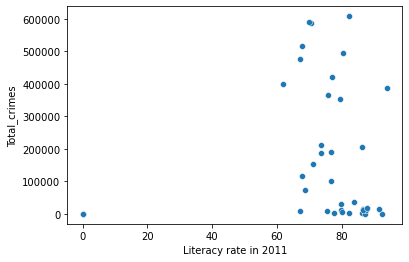

In [13]:
# Create a scatter plot using seaborn
sns.scatterplot(x='Literacy rate in 2011', y='Total_crimes', data=df_two_one)

# Calculate the correlation coefficient
corr = df_two_one['Literacy rate in 2011'].corr(df_two_one['Total_crimes'])
print('Correlation coefficient:', corr)

# 2.2	 Analysis of the type of crime vs each state vs Literacy rate.

In [14]:
df.columns[17:-2]

Index(['MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY',
       ...
       'TOTAL - Theft', 'Cases_Registered_under_Human_Rights_Violations',
       'Policemen_Chargesheeted', 'Policemen_Convicted', 'Rape_y.1',
       'Kidnapping and Abduction', 'Dowry Deaths',
       'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives'],
      dtype='object', length=130)

In [62]:
df.head()

,Unnamed: 0,State/UT,Population,Area (km2),2001,Literacy rate in 2011,Per month increase in literacy,literacy in 2002,literacy in 2003,literacy in 2004,literacy in 2005,literacy in 2006,literacy in 2007,literacy in 2008,literacy in 2009,literacy in 2010,literacy in 2012,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,KIDNAPPING AND ABDUCTION OF OTHERS,DACOITY,PREPARATION AND ASSEMBLY FOR DACOITY,ROBBERY,BURGLARY,THEFT,AUTO THEFT,OTHER THEFT,RIOTS,CRIMINAL BREACH OF TRUST,CHEATING,COUNTERFIETING,ARSON,HURT/GREVIOUS HURT,DOWRY DEATHS,ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY,INSULT TO MODESTY OF WOMEN,CRUELTY BY HUSBAND OR HIS RELATIVES,IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES,CAUSING DEATH BY NEGLIGENCE,OTHER IPC CRIMES,TOTAL IPC CRIMES,Murder_x,Rape_x,Kidnapping and Abduction_x,Dacoity_x,Robbery_x,Arson_x,Hurt_x,Prevention of atrocities (POA) Act_x,Protection of Civil Rights (PCR) Act_x,Other Crimes Against SCs,Murder_y,Rape_y,Kidnapping Abduction,Dacoity_y,Robbery_y,Arson_y,Hurt_y,Protection of Civil Rights (PCR) Act_y,Prevention of atrocities (POA) Act_y,Other Crimes Against STs,Murder,Rape_x.1,Kidnapping and Abduction_y,Foeticide,Abetment of suicide,Exposure and abandonment,Procuration of minor girls,Buying of girls for prostitution,Selling of girls for prostitution,Prohibition of child marriage act,Other Crimes,Total,Boys 7-12 Years,Girls 7-12 Years,Boys 12-16 Years,Girls 12-16 Years,Boys 16-18 Years,Girls 16-18 Years,Total for boys all Age Groups,Total for girls all Age Groups,Grand total,Cases_Property_Recovered,Cases_Property_Stolen,Value_of_Property_Recovered,Value_of_Property_Stolen,Police_Injured_By_Criminals,Police_Injured_By_Riotous_Mobs,Police_Injured_In_Accidents,Police_Injured_In_Dacoity_OperationsOther_raids,Police_Injured_In_TerroristsExtremists_Operations,Police_Injured_On_Border_Duties,Police_Injured_Total_Policemen,Police_Killed_By_Criminals,Police_Killed_By_Riotous_Mobs,Police_Killed_In_Accidents,Police_Killed_In_Dacoity_OperationsOther_raids,Police_Killed_In_TerroristsExtremists_Operations,Police_Killed_On_Border_Duties,Police_Killed_Total_Policemen,RESIDENTIAL PREMISES - Dacoity,RESIDENTIAL PREMISES - Robbery,RESIDENTIAL PREMISES - Burglary,RESIDENTIAL PREMISES - Theft,HIGHWAYS - Dacoity,HIGHWAYS - Robbery,HIGHWAYS - Burglary,HIGHWAYS - Theft,RIVER and SEA - Dacoity,RIVER and SEA - Robbery,RIVER and SEA - Burglary,RIVER and SEA - Theft,RAILWAYS - Dacoity,RAILWAYS - Robbery,RAILWAYS - Burglary,RAILWAYS - Theft,BANKS - Dacoity,BANKS - Robbery,BANKS - Burglary,BANKS - Theft,COMMERCIAL ESTABLISHMENTS - Dacoity,COMMERCIAL ESTABLISHMENTS - Robbery,COMMERCIAL ESTABLISHMENTS - Burglary,COMMERCIAL ESTABLISHMENTS - Theft,OTHER PLACES - Dacoity,OTHER PLACES - Robbery,OTHER PLACES - Burglary,OTHER PLACES - Theft,TOTAL - Dacoity,TOTAL - Robbery,TOTAL - Burglary,TOTAL - Theft,Cases_Registered_under_Human_Rights_Violations,Policemen_Chargesheeted,Policemen_Convicted,Rape_y.1,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls,Total_crimes
0,0,A&N ISLANDS,380581.0,8249.0,81.30,86.27,0.414167,81.714167,82.128333,82.5425,82.956667,83.370833,83.785,84.199167,84.613333,85.0275,85.855833,21.0,19.0,4.0,24.0,0.0,24.0,17.0,14.0,4.0,5.0,0.0,14.0,99.0,134.0,22.0,124.0,19.0,12.0,56.0,4.0,15.0,118.0,2.0,31.0,10.0,26.0,0.0,9.0,489.0,980.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,2.0,17.0,2.0,15.0,12.0,3.0,0.0,2.0,0.0,0.0,0.0,0.0,24.0,51.0,2.0,0.0,16.0,3.0,36.0,9.0,47.0,9.0,52.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,68.0,41.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,15.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,15.0,0.0,1.0,19.0,31.0,5.0,12.0,31.0,91.0,5.0,14.0,99.0,134.0,0.0,0.0,0.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0,2982.0
1,1,ANDH

In [7]:
crimes_data = df.drop(df.columns[2:17],axis=1)
crimes_data.drop(columns=['Unnamed: 0','Total for girls all Age Groups','Grand total','Total','TOTAL IPC CRIMES','Total_crimes'],axis=1,inplace=True)
crimes_data

,State/UT,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,KIDNAPPING AND ABDUCTION OF OTHERS,...,Cases_Registered_under_Human_Rights_Violations,Policemen_Chargesheeted,Policemen_Convicted,Rape_y.1,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls
0,A&N ISLANDS,21.0,19.0,4.0,24.0,0.0,24.0,17.0,14.0,4.0,...,0.0,0.0,0.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0
1,ANDHRA PRADESH,2808.0,2229.0,171.0,1442.0,1.0,1442.0,2154.0,1612.0,701.0,...,45.0,29.0,2.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0
2,ARUNACHAL PRADESH,83.0,53.0,6.0,59.0,0.0,59.0,93.0,60.0,34.0,...,11.0,6.0,0.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0
3,ASSAM,1426.0,670.0,117.0,1721.0,5.0,1716.0,3812.0,3360.0,626.0,...,96.0,2.0,0.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0
4,BIHAR,3948.0,5452.0,396.0,1555.0,1.0,1555.0,4807.0,3789.0,2416.0,...,9.0,5.0,4.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0
5,CHANDIGARH,31.0,44.0,10.0,33.0,0.0,33.0,87.0,66.0,21.0,...,1.0,0.0,0.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0
6,CHHATTISGARH,1169.0,825.0,51.0,1053.0,0.0,1053.0,472.0,365.0,107.0,...,233.0,67.0,54.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0
7,DADRA AND NAGAR HAVELI,28.0,10.0,2.0,14.0,0.0,14.0,36.0,28.0,16.0,...,0.0,0.0,0.0,14.0,28.0,2.0,22.0,4.0,10.0,0.0
8,DAMAN AND DIU,12.0,7.0,1.0,5.0,0.0,5.0,5.0,3.0,3.0,...,0.0,0.0,0.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0
9,DELHI,565.0,530.0,94.0,706.0,0.0,706.0,3970.0,2160.0,1810.0,...,6.0,7.0,0.0,706.0,2160.0,143.0,868.0,225.0,1985.0,1.0


In [8]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
crimes_data.columns

Index(['State/UT', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS',
       ...
       'Cases_Registered_under_Human_Rights_Violations',
       'Policemen_Chargesheeted', 'Policemen_Convicted', 'Rape_y.1',
       'Kidnapping and Abduction', 'Dowry Deaths',
       'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives',
       'Importation of Girls'],
      dtype='object', length=128)

In [19]:
crime_by_state = df.groupby('State/UT')[df.columns[17:-2]].sum()

crime_by_state['Total Crime'] = crime_by_state.sum(axis=1)

literacy_by_state = df.groupby('State/UT')['Literacy rate in 2011'].mean()

crime_literacy_by_state = pd.merge(crime_by_state, literacy_by_state, on='State/UT')

crime_literacy_corr = crime_literacy_by_state.corr()['Literacy rate in 2011']

crime_literacy_corr.sort_values(ascending=False)

Literacy rate in 2011                                  1.000000
RIVER and SEA - Dacoity                                0.148196
BANKS - Burglary                                       0.141823
Value_of_Property_Stolen                               0.115470
Police_Injured_In_Accidents                            0.110396
Girls 7-12 Years                                       0.103398
Total Crime                                            0.097172
COUNTERFIETING                                         0.088059
BANKS - Theft                                          0.085877
PREPARATION AND ASSEMBLY FOR DACOITY                   0.084512
Police_Injured_By_Criminals                            0.084175
Girls 12-16 Years                                      0.082708
OTHER IPC CRIMES                                       0.077816
Cases_Property_Recovered                               0.073105
COMMERCIAL ESTABLISHMENTS - Theft                      0.072019
COMMERCIAL ESTABLISHMENTS - Robbery     

In [ ]:
"""
above, we group the data by 
state using the groupby() method and calculate the sum of each crime type using the sum() method.

Next, we calculate the total number of crimes for each state by summing the columns of the crime_by_state 
dataframe using the sum() method along the rows (axis=1).

We then group the data by state again, this time calculating the mean literacy rate using the mean() method.

We merge the crime and literacy data by state using the pd.merge() function, specifying the on parameter 
as 'State' to merge on the state column.

Finally, we calculate the correlation between each crime type and literacy rate using the corr() method on 
the crime_literacy_by_state dataframe and the ['Literacy Rate'] column of the resulting correlation matrix. 
This will give us a measure of the linear relationship between each crime type and literacy rate, with values 
closer to -1 indicating a negative correlation, values closer to 1 indicating a positive correlation, and values 
close to 0 indicating no correlation.
"""

In [ ]:
"""The resulting output shows the correlation coefficients between the literacy rate and different types of crime. 
A negative correlation coefficient indicates that as literacy rate increases, the incidence of that type of crime 
decreases, and vice versa. A positive correlation coefficient indicates the opposite - as literacy rate increases, 
the incidence of that type of crime also increases."""

# 2.3	Analysis of year-on-year total crime rate.

# for ipc crimes

In [20]:
# df1_ipc

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df1_ipc.groupby('YEAR')['TOTAL IPC CRIMES'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change1 = pd.DataFrame({'yearly_total_crimes ipc':yearly_total_crimes,'yoy_change ipc':yoy_change})
df_yearly_change1

,yearly_total_crimes ipc,yoy_change ipc
YEAR,,
2001,3538616,NaN
2002,3560660,0.006230
2003,3432240,-0.036066
2004,3664020,0.067530
2005,3645204,-0.005135
2006,3756586,0.030556
2007,3979346,0.059299
2008,4186758,0.052122
2009,4242690,0.013359


Text(0, 0.5, 'Percent Change')

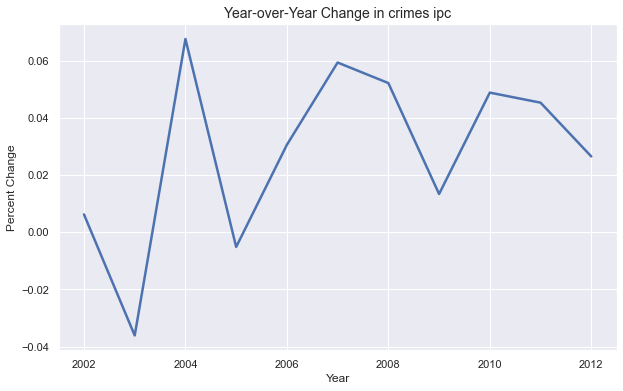

In [21]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='YEAR', y=df_yearly_change1.columns[1], data=df_yearly_change1, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes ipc', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# for crimes against sc

In [22]:
df2_sc['Total SC crimes'] = df2_sc.iloc[:, -10:].sum(axis=1)

In [23]:
# df2_sc

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df2_sc.groupby('Year')['Total SC crimes'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change2 = pd.DataFrame({'yearly_total_crimes against sc':yearly_total_crimes,'yoy_change against sc':yoy_change})
df_yearly_change2

,yearly_total_crimes against sc,yoy_change against sc
Year,,
2001,67003,NaN
2002,67014,0.000164
2003,52502,-0.216552
2004,53775,0.024247
2005,52254,-0.028285
2006,54146,0.036208
2007,60062,0.109260
2008,66860,0.113183
2009,66824,-0.000538


Text(0, 0.5, 'Percent Change')

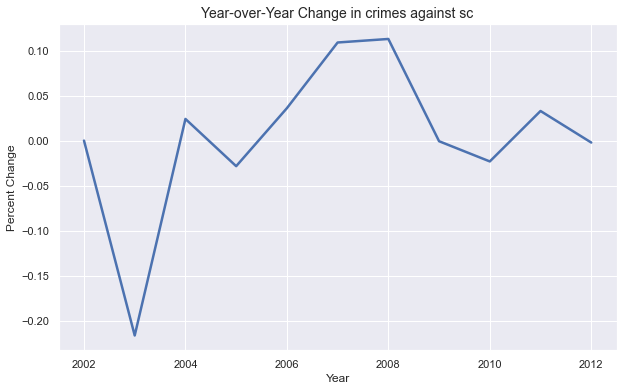

In [24]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='Year', y=df_yearly_change2.columns[1], data=df_yearly_change2, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes against sc', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# crimes against st

In [25]:
df3_st['Total St crimes'] = df3_st.iloc[:, -10:].sum(axis=1)

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df3_st.groupby('Year')['Total St crimes'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change3 = pd.DataFrame({'yearly_total_crimes against st':yearly_total_crimes,'yoy_change against st':yoy_change})
df_yearly_change3

,yearly_total_crimes against st,yoy_change against st
Year,,
2001,12434,NaN
2002,13540,0.088950
2003,11773,-0.130502
2004,11070,-0.059713
2005,11426,0.032159
2006,11587,0.014091
2007,11064,-0.045137
2008,10784,-0.025307
2009,10500,-0.026335


Text(0, 0.5, 'Percent Change')

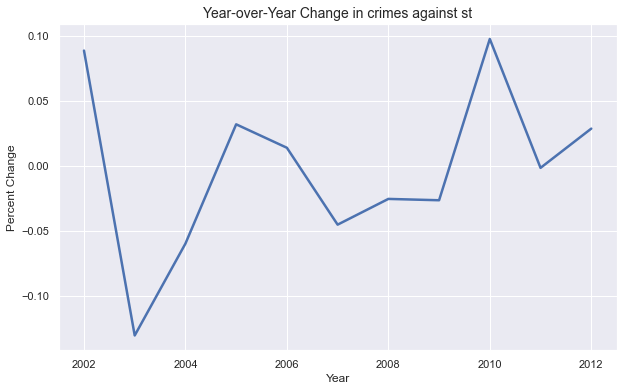

In [26]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='Year', y=df_yearly_change3.columns[1], data=df_yearly_change3, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes against st', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# crimes against child

In [27]:
# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df4_child.groupby('Year')['Total'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change4 = pd.DataFrame({'yearly_total_crimes against children':yearly_total_crimes,'yoy_change against child':yoy_change})
df_yearly_change4

,yearly_total_crimes against children,yoy_change against child
Year,,
2001,21035,NaN
2002,20520,-0.024483
2003,23266,0.133821
2004,28721,0.234462
2005,30096,0.047874
2006,37934,0.260433
2007,40607,0.070464
2008,45000,0.108183
2009,48362,0.074711


Text(0, 0.5, 'Percent Change')

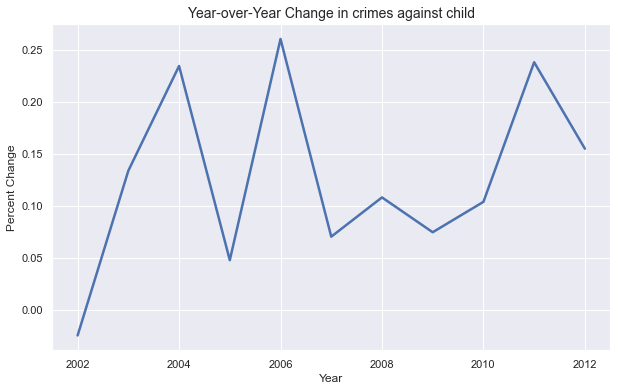

In [28]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='Year', y=df_yearly_change4.columns[1], data=df_yearly_change4, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes against child', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# crimes: juvinile category

In [29]:
# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df5_juv.groupby('Year')['Grand total'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change5 = pd.DataFrame({'yearly_total_crimes by juviniles':yearly_total_crimes,'yoy_change in crimes by juviniles':yoy_change})
df_yearly_change5

,yearly_total_crimes by juviniles,yoy_change in crimes by juviniles
Year,,
2001,52314,NaN
2002,55411,0.059200
2003,54926,-0.008753
2004,56291,0.024852
2005,57997,0.030307
2006,61397,0.058624
2007,68212,0.110999
2008,70486,0.033337
2009,65841,-0.065900


Text(0, 0.5, 'Percent Change')

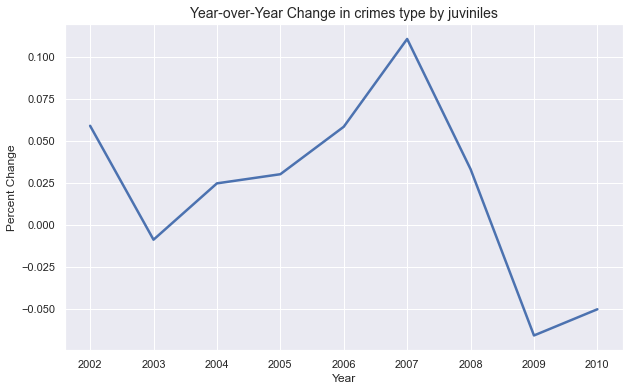

In [30]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='Year', y=df_yearly_change5.columns[1], data=df_yearly_change5, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes type by juviniles', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# property stolen crimes

In [31]:
# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df6_prop_stolen.groupby('Year')['Cases_Property_Stolen'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change6 = pd.DataFrame({'yearly_total_crimes type property stolen':yearly_total_crimes,'yoy_change in crimes type property stolen':yoy_change})
df_yearly_change6

,yearly_total_crimes type property stolen,yoy_change in crimes type property stolen
Year,,
2001,870858,NaN
2002,857257,-0.015618
2003,842126,-0.017650
2004,912123,0.083119
2005,902267,-0.010806
2006,923607,0.023652
2007,977597,0.058456
2008,1055947,0.080145
2009,1077643,0.020546


Text(0, 0.5, 'Percent Change')

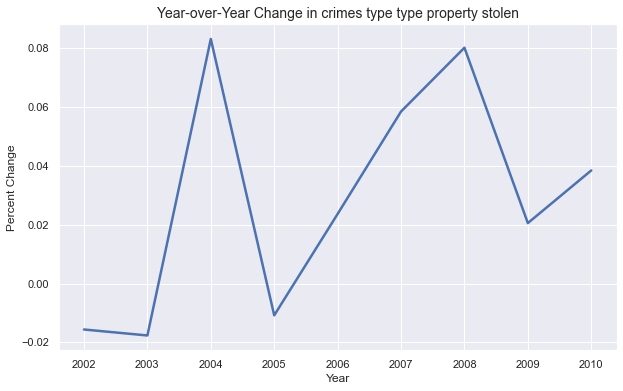

In [32]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='Year', y=df_yearly_change6.columns[1], data=df_yearly_change6, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes type type property stolen', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# Crimes against police

In [33]:
df7_police['police_injured_or_killed'] = df7_police.iloc[:, -14:].sum(axis=1)

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df7_police.groupby('Year')['police_injured_or_killed'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change7 = pd.DataFrame({'yearly_total_crimes type police_injured_or_killed':yearly_total_crimes,'yoy_change in crimes type police_injured_or_killed':yoy_change})
df_yearly_change7

,yearly_total_crimes type police_injured_or_killed,yoy_change in crimes type police_injured_or_killed
Year,,
2001,19056,NaN
2002,19144,0.004618
2003,15208,-0.205600
2004,12720,-0.163598
2005,14892,0.170755
2006,17236,0.157400
2007,16292,-0.054769
2008,18204,0.117358
2009,19896,0.092947


Text(0, 0.5, 'Percent Change')

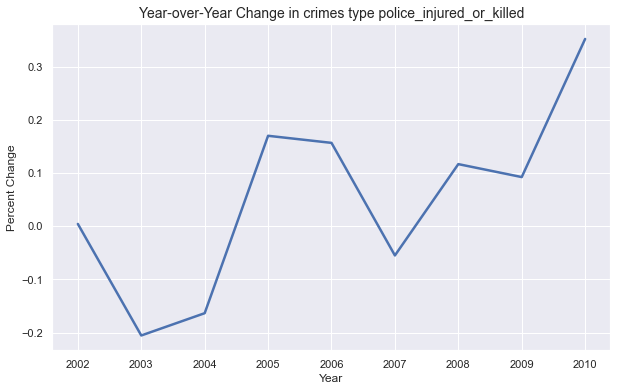

In [34]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='Year', y=df_yearly_change7.columns[1], data=df_yearly_change7, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes type police_injured_or_killed', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# crimes type: property taken away

In [35]:
df8_propval['total properties taken away'] = df8_propval.iloc[:, -8:].sum(axis=1)

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df8_propval.groupby('YEAR')['total properties taken away'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change8 = pd.DataFrame({'yearly_total_crimes type property taken away':yearly_total_crimes,'yoy_change in crimes type property taken away':yoy_change})
df_yearly_change8

,yearly_total_crimes type property taken away,yoy_change in crimes type property taken away
YEAR,,
2001,30529027487,NaN
2002,31728702995,0.039296
2003,27867903578,-0.121682
2004,24360185139,-0.125869
2005,37599757603,0.543492
2006,30175234903,-0.197462
2007,34402079395,0.140077
2008,48329106062,0.404831
2009,45449399545,-0.059585


Text(0, 0.5, 'Percent Change')

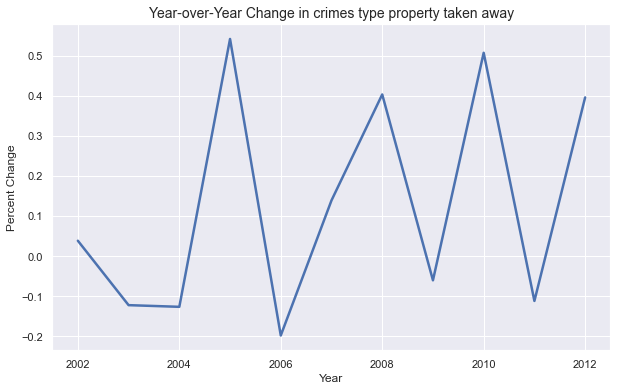

In [36]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='YEAR', y=df_yearly_change8.columns[1], data=df_yearly_change8, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes type property taken away', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# Crime_by_place_of_occurrence

In [37]:
df9_place['Total dacoity robbery and burglary'] = df9_place.iloc[:, -4:].sum(axis=1)

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df9_place.groupby('YEAR')['Total dacoity robbery and burglary'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change9 = pd.DataFrame({'yearly_total_crimes type Total dacoity robbery and burglary':yearly_total_crimes,'yoy_change in crimes type Total dacoity robbery and burglary':yoy_change})
df_yearly_change9

,yearly_total_crimes type Total dacoity robbery and burglary,yoy_change in crimes type Total dacoity robbery and burglary
YEAR,,
2001,1140120,NaN
2002,1104723,-0.031047
2003,1082637,-0.019992
2004,1167912,0.078766
2005,1158099,-0.008402
2006,1167669,0.008264
2007,1199928,0.027627
2008,896053,-0.253244
2009,1329780,0.484042


Text(0, 0.5, 'Percent Change')

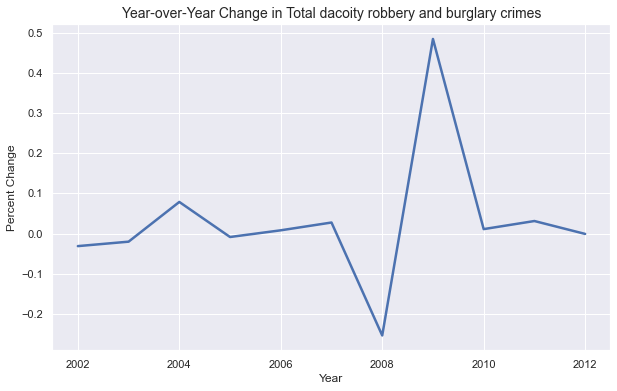

In [38]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x='YEAR', y=df_yearly_change9.columns[1], data=df_yearly_change9, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in Total dacoity robbery and burglary crimes', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# human rights violation crimes:

In [39]:
df10_hrvio['Total human rights violation crimes'] = df10_hrvio.iloc[:, -4:].sum(axis=1)

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df10_hrvio.groupby('Year')['Total human rights violation crimes'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change10 = pd.DataFrame({'yearly_total_crimes type Total human rights violation crimes':yearly_total_crimes,'yoy_change in crimes type Total human rights violation crimes':yoy_change})
df_yearly_change10

,yearly_total_crimes type Total human rights violation crimes,yoy_change in crimes type Total human rights violation crimes
Year,,
2001,640.0,NaN
2002,308.0,-0.518750
2003,236.0,-0.233766
2004,132.0,-0.440678
2005,110.0,-0.166667
2006,114.0,0.036364
2007,202.0,0.771930
2008,550.0,1.722772
2009,664.0,0.207273


Text(0, 0.5, 'Percent Change')

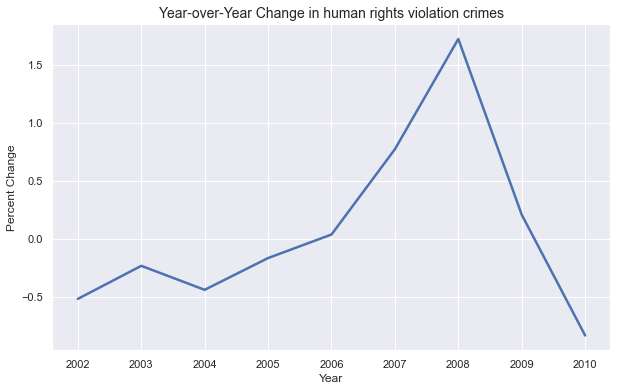

In [40]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x="Year", y=df_yearly_change10.columns[1], data=df_yearly_change10, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in human rights violation crimes', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# crimes against women

In [41]:
df11_women['Total crimes against women'] = df11_women.iloc[:, -7:].sum(axis=1)

# Group the data by year and sum the total crimes for each year
yearly_total_crimes = df11_women.groupby('Year')['Total crimes against women'].sum()

# Calculate the year-on-year change in total crimes
yoy_change = yearly_total_crimes.pct_change()

df_yearly_change11 = pd.DataFrame({'yearly_total_crimes type Total human rights violation crimes':yearly_total_crimes,'yoy_change in crimes type Total human rights violation crimes':yoy_change})
df_yearly_change11

,yearly_total_crimes type Total human rights violation crimes,yoy_change in crimes type Total human rights violation crimes
Year,,
2001,261450,NaN
2002,262224,0.002960
2003,262728,0.001922
2004,287230,0.093260
2005,287046,-0.000641
2006,308316,0.074100
2007,349842,0.134686
2008,373232,0.066859
2009,389670,0.044042


Text(0, 0.5, 'Percent Change')

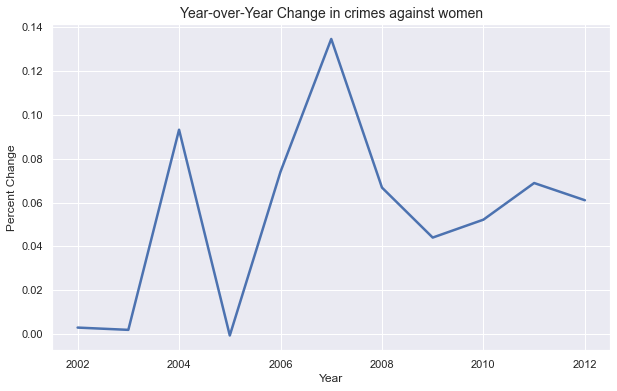

In [42]:
sns.set_style("darkgrid")
sns.set_palette("husl")
sns.set(rc={"figure.figsize":(10, 6)})
sns.lineplot(x="Year", y="yoy_change in crimes type Total human rights violation crimes", data=df_yearly_change11, linewidth=2.5)

# Set the title and axis labels
plt.title('Year-over-Year Change in crimes against women', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Percent Change', fontsize=12)

# 2.4	 Analysis of area vs overall crime

In [43]:
df_two_4 = df[['State/UT','Population','Area (km2)','Total_crimes']]

df_two_4.iloc[5, 2] = 114
df_two_4.iloc[8, 2] = 112
df_two_4.iloc[19, 2] = 32

df_two_4.iloc[8, 1] = 243000


df_two_4['Crime Rate'] = df_two_4['Total_crimes'] / df_two_4['Area (km2)']


df_two_4

,State/UT,Population,Area (km2),Total_crimes,Crime Rate
0,A&N ISLANDS,380581.0,8249.0,2982.0,0.361498
1,ANDHRA PRADESH,49577103.0,162975.0,515853.0,3.165228
2,ARUNACHAL PRADESH,1383727.0,83743.0,8339.0,0.099578
3,ASSAM,31205576.0,78438.0,210809.0,2.687588
4,BIHAR,104099452.0,94163.0,399281.0,4.240317
5,CHANDIGARH,1055450.0,114.0,14785.0,129.692982
6,CHHATTISGARH,25545198.0,135191.0,153886.0,1.138286
7,DADRA AND NAGAR HAVELI,585764.0,603.0,3134.0,5.197347
8,DAMAN AND DIU,243000.0,112.0,1023.0,9.133929
9,DELHI,16787941.0,1484.0,205547.0,138.508760


In [44]:
df_two_4.describe()

,Population,Area (km2),Total_crimes,Crime Rate
count,3.700000e+01,37.000000,37.000000,37.000000
mean,3.272462e+07,85581.459459,178906.378378,10.352463
std,4.280861e+07,94739.765956,209208.147662,30.411772
min,6.447300e+04,32.000000,0.000000,0.000000
25%,1.383727e+06,10486.000000,9686.000000,0.646759
50%,1.678794e+07,53483.000000,73821.000000,1.900606
75%,4.957710e+07,130058.000000,364521.000000,4.240317
max,1.998123e+08,342239.000000,608358.000000,138.508760


In [45]:
print('Mean area:', df_two_4['Area (km2)'].mean())
print('Median area:', df_two_4['Area (km2)'].median())
print('Standard deviation of area:', df_two_4['Area (km2)'].std())
print('\n\n')
print('Mean overall crime:', df_two_4['Total_crimes'].mean())
print('Median overall crime:', df_two_4['Total_crimes'].median())
print('Standard deviation of overall crime:', df_two_4['Total_crimes'].std())

Mean area: 85581.45945945945
Median area: 53483.0
Standard deviation of area: 94739.76595583485



Mean overall crime: 178906.37837837837
Median overall crime: 73821.0
Standard deviation of overall crime: 209208.1476624485


In [46]:
"""The mean area of the data is 85581.46 square kilometers. 
This means that on average, the areas in the data are relatively large. 
However, without more information about the context of the data, it is difficult to determine whether 
this value is typical or not.

The median area of the data is 53483.0 square kilometers. This value is the midpoint of the sorted values, 
meaning that half of the areas in the data are smaller than this value and half are larger. This provides 
a more representative measure of the "typical" area than the mean in skewed distributions.

The standard deviation of the area is 94739.77 square kilometers. This is a measure of how spread out the 
data is around the mean. A large standard deviation suggests that the data is widely dispersed, indicating 
a large variation in the areas.

The mean overall crime in the data is 178906.38. This means that on average, the total number of crimes in 
the data is relatively high. However, without more information about the context of the data, it is difficult 
to determine whether this value is typical or not.

The median overall crime in the data is 73821.0. This value is the midpoint of the sorted values, meaning that 
half of the total crimes in the data are smaller than this value and half are larger. This provides a more 
representative measure of the "typical" total number of crimes than the mean in skewed distributions.

The standard deviation of the overall crime is 209208.15. This is a measure of how spread out the data is around 
the mean. A large standard deviation suggests that the data is widely dispersed, indicating a large variation 
in the total number of crimes."""

'The mean area of the data is 85581.46 square kilometers. \nThis means that on average, the areas in the data are relatively large. \nHowever, without more information about the context of the data, it is difficult to determine whether \nthis value is typical or not.\n\nThe median area of the data is 53483.0 square kilometers. This value is the midpoint of the sorted values, \nmeaning that half of the areas in the data are smaller than this value and half are larger. This provides \na more representative measure of the "typical" area than the mean in skewed distributions.\n\nThe standard deviation of the area is 94739.77 square kilometers. This is a measure of how spread out the \ndata is around the mean. A large standard deviation suggests that the data is widely dispersed, indicating \na large variation in the areas.\n\nThe mean overall crime in the data is 178906.38. This means that on average, the total number of crimes in \nthe data is relatively high. However, without more inform

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='Area (km2)', ylabel='Total_crimes'>

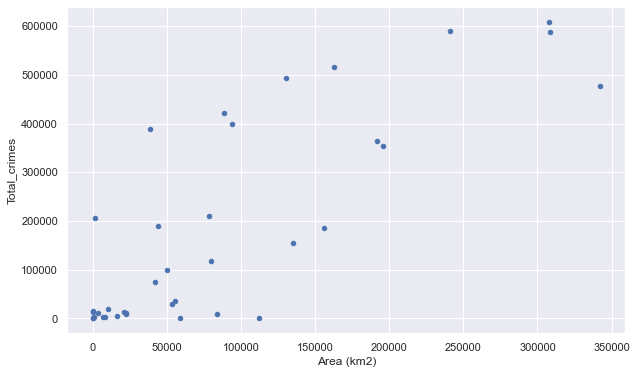

In [47]:
df_two_4.plot.scatter(x='Area (km2)', y='Total_crimes')

In [48]:
import statsmodels.api as sm

X = df_two_4['Area (km2)']
y = df_two_4['Total_crimes']

X = sm.add_constant(X)

model = sm.OLS(y, X).fit()

print(model.summary())

                            OLS Regression Results                            
Dep. Variable:           Total_crimes   R-squared:                       0.667
Model:                            OLS   Adj. R-squared:                  0.657
Method:                 Least Squares   F-statistic:                     70.11
Date:                Tue, 11 Apr 2023   Prob (F-statistic):           7.11e-10
Time:                        09:52:08   Log-Likelihood:                -484.94
No. Observations:                  37   AIC:                             973.9
Df Residuals:                      35   BIC:                             977.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.456e+04   2.73e+04      0.900      0.3

In [49]:
"""This is a report of a linear regression model that aims to predict the number of total crimes in a given 
area based on its size in square kilometers. The report provides information on the goodness of fit of the 
model and the significance of the predictor variable.

The R-squared value of 0.667 indicates that the model explains 66.7% of the variation in the dependent variable, 
Total_crimes, based on the independent variable, Area (km2). This suggests that the model is a moderately good 
fit to the data.

The Adj. R-squared value of 0.657 is similar to the R-squared value but adjusted for the number of independent 
variables included in the model. This value is slightly lower than the R-squared value, indicating that the 
addition of the independent variable has not significantly improved the model's fit.

The F-statistic of 70.11 and the associated Prob (F-statistic) of 7.11e-10 indicate that the model is statistically 
significant, meaning that it is unlikely that the observed relationship between the dependent and independent variable 
is due to chance.

The coefficient for the Area (km2) predictor variable is 1.8035, which indicates that for every additional square 
kilometer in area, the number of total crimes is predicted to increase by 1.8035. The standard error of this coefficient 
is 0.215, which means that the estimate is precise.

The const coefficient represents the intercept of the regression line and is not significant at the 5% level (P>|t| = 0.374). 
This suggests that the regression line does not necessarily have to pass through the origin.

The report also provides additional statistical tests and measures, including the Log-Likelihood, AIC, BIC, Omnibus, 
Durbin-Watson, Jarque-Bera, and Kurtosis, which can help evaluate the model's assumptions, fit, and performance."""

"This is a report of a linear regression model that aims to predict the number of total crimes in a given \narea based on its size in square kilometers. The report provides information on the goodness of fit of the \nmodel and the significance of the predictor variable.\n\nThe R-squared value of 0.667 indicates that the model explains 66.7% of the variation in the dependent variable, \nTotal_crimes, based on the independent variable, Area (km2). This suggests that the model is a moderately good \nfit to the data.\n\nThe Adj. R-squared value of 0.657 is similar to the R-squared value but adjusted for the number of independent \nvariables included in the model. This value is slightly lower than the R-squared value, indicating that the \naddition of the independent variable has not significantly improved the model's fit.\n\nThe F-statistic of 70.11 and the associated Prob (F-statistic) of 7.11e-10 indicate that the model is statistically \nsignificant, meaning that it is unlikely that the

In [50]:
print(df_two_4['Area (km2)'].corr(df_two_4['Total_crimes']))

0.8167008609158942


# 2.5	 Analysis of population vs overall crime

In [51]:
df_two_five = df[['Population', 'Total_crimes']]

In [52]:
print('Mean population:', df_two_five['Population'].mean())
print('Median population:', df_two_five['Population'].median())
print('Standard deviation of population:', df_two_five['Population'].std())
print('\n\n')
print('Mean overall crime:', df_two_five['Total_crimes'].mean())
print('Median overall crime:', df_two_five['Total_crimes'].median())
print('Standard deviation of overall crime:', df_two_five['Total_crimes'].std())


Mean population: 32718057.08108108
Median population: 16787941.0
Standard deviation of population: 42813752.23932689



Mean overall crime: 178906.37837837837
Median overall crime: 73821.0
Standard deviation of overall crime: 209208.1476624485


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='Population', ylabel='Total_crimes'>

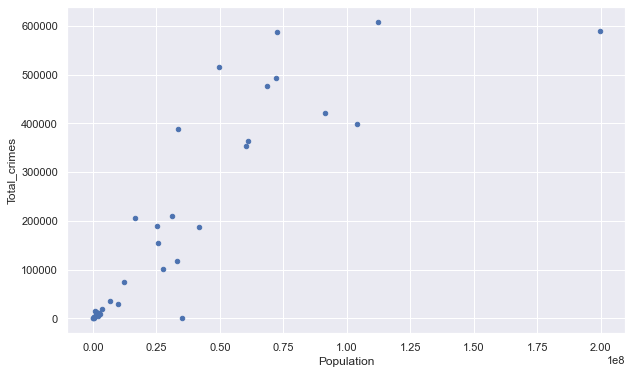

In [53]:
df_two_five.plot.scatter(x='Population', y='Total_crimes')

In [54]:
import statsmodels.api as sm

X = df_two_five['Population']
y = df_two_five['Total_crimes']

X = sm.add_constant(X)

model = sm.OLS(y, X).fit()

print(model.summary())

                            OLS Regression Results                            
Dep. Variable:           Total_crimes   R-squared:                       0.742
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     100.5
Date:                Tue, 11 Apr 2023   Prob (F-statistic):           7.96e-12
Time:                        09:52:09   Log-Likelihood:                -480.24
No. Observations:                  37   AIC:                             964.5
Df Residuals:                      35   BIC:                             967.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.122e+04   2.24e+04      1.838      0.0

In [55]:
"""This report presents the results of an OLS (ordinary least squares) regression analysis that aims 
to investigate the relationship between the dependent variable "Total_crimes" and the independent variable 
"Population." The analysis was conducted using 37 observations.

The R-squared value of the model is 0.742, indicating that the independent variable "Population" explains 
about 74.2% of the variation in the dependent variable "Total_crimes." The adjusted R-squared value is 0.734, 
which suggests that the model is a good fit and not overfitting.

The F-statistic is 100.5, with a corresponding probability of 7.96e-12. This suggests that the model is statistically 
significant, and the independent variable "Population" has a significant effect on the dependent variable "Total_crimes."

The coefficient of "Population" is 0.0042, indicating that for each unit increase in "Population," "Total_crimes" 
increases by 0.0042. This coefficient is statistically significant, as indicated by the low p-value (0.000).

The intercept term (const) is 4.122e+04, with a standard error of 2.24e+04. The p-value of the intercept term is 
0.075, indicating that it is not statistically significant at the 5% significance level.

The report also provides some diagnostic measures of the model's goodness of fit. The Omnibus test indicates that 
the residuals are normally distributed, while the Durbin-Watson statistic of 2.106 suggests that there is no significant 
autocorrelation in the residuals. However, the Jarque-Bera test suggests that the residuals are not perfectly normal, 
with a p-value of 0.117.

In summary, this report suggests that there is a significant positive relationship between "Population" and "Total_crimes" 
and that the model explains a large proportion of the variation in the dependent variable. However, the intercept term is 
not statistically significant, and the residuals may not be perfectly normally distributed."""

'This report presents the results of an OLS (ordinary least squares) regression analysis that aims \nto investigate the relationship between the dependent variable "Total_crimes" and the independent variable \n"Population." The analysis was conducted using 37 observations.\n\nThe R-squared value of the model is 0.742, indicating that the independent variable "Population" explains \nabout 74.2% of the variation in the dependent variable "Total_crimes." The adjusted R-squared value is 0.734, \nwhich suggests that the model is a good fit and not overfitting.\n\nThe F-statistic is 100.5, with a corresponding probability of 7.96e-12. This suggests that the model is statistically \nsignificant, and the independent variable "Population" has a significant effect on the dependent variable "Total_crimes."\n\nThe coefficient of "Population" is 0.0042, indicating that for each unit increase in "Population," "Total_crimes" \nincreases by 0.0042. This coefficient is statistically significant, as ind

In [56]:
print(df_two_five['Population'].corr(df_two_five['Total_crimes']))

0.861203021020476


# 2.6 Each state crime report

In [9]:
df_two_six = crimes_data.T
df_two_six.columns = df_two_six.iloc[-2]
df_two_six = df_two_six.iloc[:-2].append(df_two_six.iloc[-1])
df_two_six

Cruelty by Husband or his Relatives,26.0,13389.0,26.0,6407.0,3686.0,112.0,980.0,10.0,5.0,1985.0,24.0,6658.0,3137.0,343.0,301.0,1261.0,3712.0,5377.0,0.0,2.0,3988.0,7829.0,43.0,32.0,16.0,4.0,2638.0,19.0,1293.0,13312.0,7.0,1976.0,0.0,937.0,8566.0,463.0,19865.0
State/UT,A&N ISLANDS,ANDHRA PRADESH,ARUNACHAL PRADESH,ASSAM,BIHAR,CHANDIGARH,CHHATTISGARH,DADRA AND NAGAR HAVELI,DAMAN AND DIU,DELHI,GOA,GUJARAT,HARYANA,HIMACHAL PRADESH,JAMMU AND KASHMIR,JHARKHAND,KARNATAKA,KERALA,LADAKH,LAKSHADWEEP,MADHYA PRADESH,MAHARASHTRA,MANIPUR,MEGHALAYA,MIZORAM,NAGALAND,ODISHA,PUDUCHERRY,PUNJAB,RAJASTHAN,SIKKIM,TAMIL NADU,TELANGANA,TRIPURA,UTTAR PRADESH,UTTARAKHAND,WEST BENGAL
MURDER,21.0,2808.0,83.0,1426.0,3948.0,31.0,1169.0,28.0,12.0,565.0,53.0,1532.0,1062.0,132.0,1075.0,1747.0,1860.0,472.0,0.0,1.0,2511.0,2839.0,256.0,175.0,48.0,143.0,1548.0,37.0,907.0,1461.0,21.0,1949.0,0.0,254.0,7601.0,316.0,2398.0
ATTEMPT TO MURDER,19.0,2229.0,53.0,670.0,5452.0,44.0,825.0,10.0,7.0,530.0,35.0,759.0,910.0,86.0,1474.0,1274.0,1923.0,615.0,0.0,2.0,2870.0,2168.0,498.0,63.0,36.0,50.0,1879.0,43.0,1045.0,2043.0,16.0,2962.0,0.0,87.0,7964.0,279.0,2854.0
CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,4.0,171.0,6.0,117.0,396.0,10.0,51.0,2.0,1.0,94.0,11.0,94.0,92.0,22.0,40.0,143.0,94.0,473.0,0.0,0.0,204.0,171.0,6.0,17.0,8.0,13.0,188.0,16.0,216.0,104.0,8.0,44.0,0.0,8.0,1616.0,60.0,931.0
RAPE,24.0,1442.0,59.0,1721.0,1555.0,33.0,1053.0,14.0,5.0,706.0,55.0,473.0,733.0,183.0,303.0,855.0,636.0,1132.0,0.0,2.0,3425.0,1839.0,63.0,164.0,103.0,23.0,1458.0,13.0,680.0,2049.0,34.0,737.0,0.0,238.0,2042.0,148.0,2363.0
CUSTODIAL RAPE,0.0,1.0,0.0,5.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,5.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
OTHER RAPE,24.0,1442.0,59.0,1716.0,1555.0,33.0,1053.0,14.0,5.0,706.0,55.0,473.0,733.0,183.0,303.0,855.0,636.0,1132.0,0.0,2.0,3425.0,1839.0,63.0,164.0,103.0,23.0,1458.0,13.0,679.0,2049.0,34.0,737.0,0.0,238.0,2042.0,148.0,2363.0
KIDNAPPING & ABDUCTION,17.0,2154.0,93.0,3812.0,4807.0,87.0,472.0,36.0,5.0,3970.0,36.0,1720.0,1349.0,212.0,1093.0,1056.0,1451.0,299.0,0.0,1.0,1302.0,1669.0,223.0,92.0,15.0,52.0,1542.0,20.0,919.0,3243.0,10.0,1984.0,0.0,154.0,8878.0,314.0,5117.0
KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,14.0,1612.0,60.0,3360.0,3789.0,66.0,365.0,28.0,3.0,2160.0,28.0,1527.0,900.0,191.0,1041.0,786.0,1070.0,221.0,0.0,1.0,1127.0,1252.0,133.0,37.0,3.0,10.0,1364.0,16.0,689.0,2713.0,10.0,1743.0,0.0,116.0,7910.0,283.0,4168.0
KIDNAPPING AND ABDUCTION OF OTHERS,4.0,701.0,34.0,626.0,2416.0,21.0,107.0,16.0,3.0,1810.0,11.0,248.0,449.0,32.0,103.0,338.0,788.0,97.0,0.0,0.0,325.0,443.0,92.0,68.0,15.0,44.0,178.0,8.0,230.0,568.0,7.0,345.0,0.0,117.0,1451.0,86.0,949.0


In [10]:
for i in df_two_six.columns:
    print(df_two_six[i].describe())

Cruelty by Husband or his Relatives   26.0   26.0
count                                127.0  127.0
unique                                31.0   54.0
top                                    0.0    0.0
freq                                  58.0   37.0
count     127.0
unique    100.0
top         4.0
freq        5.0
Name: 13389.0, dtype: float64
Cruelty by Husband or his Relatives   26.0   26.0
count                                127.0  127.0
unique                                31.0   54.0
top                                    0.0    0.0
freq                                  58.0   37.0
count     127.0
unique     90.0
top         5.0
freq        7.0
Name: 6407.0, dtype: float64
count     127.0
unique     93.0
top         5.0
freq        4.0
Name: 3686.0, dtype: float64
count     127.0
unique     51.0
top         0.0
freq       47.0
Name: 112.0, dtype: float64
count     127.0
unique     95.0
top         2.0
freq        5.0
Name: 980.0, dtype: float64
count     127.0
unique     33.0
top 

In [11]:
df_two_six.describe().T

,count,unique,top,freq
Cruelty by Husband or his Relatives,,,,
26.0,127.0,31.0,0.0,58.0
13389.0,127.0,100.0,4.0,5.0
26.0,127.0,54.0,0.0,37.0
6407.0,127.0,90.0,5.0,7.0
3686.0,127.0,93.0,5.0,4.0
112.0,127.0,51.0,0.0,47.0
980.0,127.0,95.0,2.0,5.0
10.0,127.0,33.0,0.0,53.0
5.0,127.0,29.0,0.0,58.0


In [12]:
df_two_six.columns = df_two_six.iloc[-2]

In [13]:
# Melt the data to convert it into a long format
melted_data = pd.melt(crimes_data, id_vars=['State/UT'], 
                      var_name='Crime_type', value_name='Occurrences')

# Group the data by crime type
grouped_data = melted_data.groupby(['Crime_type','State/UT']).sum()

# Display the results

pd.set_option('display.float_format', lambda x: '%.3f' % x)

grouped_data.sort_values(by='State/UT',ascending = True)


,,Occurrences
Crime_type,State/UT,
ARSON,A&N ISLANDS,15.000
Police_Killed_In_Accidents,A&N ISLANDS,0.000
BANKS - Robbery,A&N ISLANDS,1.000
Robbery_y,A&N ISLANDS,0.000
KIDNAPPING AND ABDUCTION OF OTHERS,A&N ISLANDS,4.000
Cases_Property_Stolen,A&N ISLANDS,0.000
RAILWAYS - Dacoity,A&N ISLANDS,0.000
RESIDENTIAL PREMISES - Theft,A&N ISLANDS,41.000
HIGHWAYS - Dacoity,A&N ISLANDS,0.000


In [71]:
grouped_data = df_two_4.groupby(pd.cut(df_two_4['Population'], bins=4))
grouped_data

In [72]:
mean_data = grouped_data['Crime Rate'].mean()
mean_data

Population
(-135274.868, 50001440.0]     12.815189
(50001440.0, 99938407.0]       2.592099
(99938407.0, 149875374.0]      3.108674
(149875374.0, 199812341.0]     2.445913
Name: Crime Rate, dtype: float64

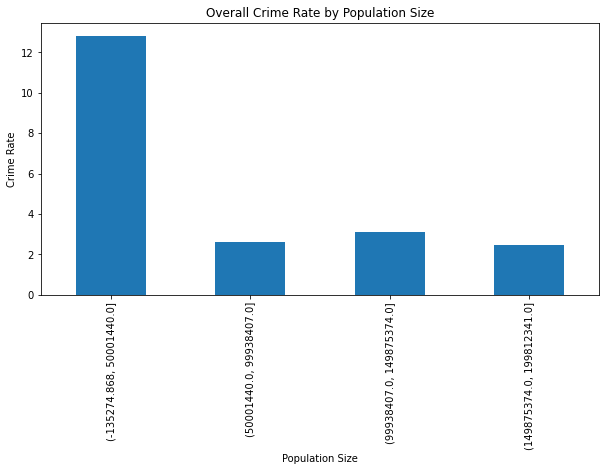

In [73]:
mean_data.plot(kind='bar', figsize=(10, 5))
plt.title('Overall Crime Rate by Population Size')
plt.xlabel('Population Size')
plt.ylabel('Crime Rate')
plt.show()

In [95]:
state_totals = df_two_4.groupby('State/UT')['Total_crimes'].sum().reset_index()

state_totals.sort_values(by='Total_crimes',ascending = False)

,State/UT,Total_crimes
21,MAHARASHTRA,608358.0
34,UTTAR PRADESH,589289.0
20,MADHYA PRADESH,587540.0
1,ANDHRA PRADESH,515853.0
31,TAMIL NADU,494098.0
29,RAJASTHAN,477129.0
36,WEST BENGAL,421566.0
4,BIHAR,399281.0
17,KERALA,388068.0
16,KARNATAKA,364521.0


# Statewise crimes analysis

In [6]:
df = pd.read_csv('E:\DS Course Related\Capstone Project\'1crimes_df.csv')

crimes_data = df.drop(df.columns[2:17],axis=1)
crimes_data.drop(columns=['Unnamed: 0','Total for girls all Age Groups','Grand total','Total','TOTAL IPC CRIMES','Total_crimes'],axis=1,inplace=True)
crimes_data

,State/UT,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,KIDNAPPING AND ABDUCTION OF OTHERS,...,Cases_Registered_under_Human_Rights_Violations,Policemen_Chargesheeted,Policemen_Convicted,Rape_y.1,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls
0,A&N ISLANDS,21.0,19.0,4.0,24.0,0.0,24.0,17.0,14.0,4.0,...,0.0,0.0,0.0,24.0,14.0,2.0,31.0,10.0,26.0,0.0
1,ANDHRA PRADESH,2808.0,2229.0,171.0,1442.0,1.0,1442.0,2154.0,1612.0,701.0,...,45.0,29.0,2.0,1442.0,1612.0,613.0,5147.0,4562.0,13389.0,7.0
2,ARUNACHAL PRADESH,83.0,53.0,6.0,59.0,0.0,59.0,93.0,60.0,34.0,...,11.0,6.0,0.0,59.0,60.0,1.0,84.0,6.0,26.0,0.0
3,ASSAM,1426.0,670.0,117.0,1721.0,5.0,1716.0,3812.0,3360.0,626.0,...,96.0,2.0,0.0,1721.0,3360.0,175.0,1840.0,20.0,6407.0,3.0
4,BIHAR,3948.0,5452.0,396.0,1555.0,1.0,1555.0,4807.0,3789.0,2416.0,...,9.0,5.0,4.0,1555.0,3789.0,1413.0,999.0,53.0,3686.0,83.0
5,CHANDIGARH,31.0,44.0,10.0,33.0,0.0,33.0,87.0,66.0,21.0,...,1.0,0.0,0.0,33.0,66.0,10.0,45.0,28.0,112.0,0.0
6,CHHATTISGARH,1169.0,825.0,51.0,1053.0,0.0,1053.0,472.0,365.0,107.0,...,233.0,67.0,54.0,1053.0,365.0,128.0,1763.0,182.0,980.0,2.0
7,DADRA AND NAGAR HAVELI,28.0,10.0,2.0,14.0,0.0,14.0,36.0,28.0,16.0,...,0.0,0.0,0.0,14.0,28.0,2.0,22.0,4.0,10.0,0.0
8,DAMAN AND DIU,12.0,7.0,1.0,5.0,0.0,5.0,5.0,3.0,3.0,...,0.0,0.0,0.0,5.0,3.0,1.0,4.0,1.0,5.0,0.0
9,DELHI,565.0,530.0,94.0,706.0,0.0,706.0,3970.0,2160.0,1810.0,...,6.0,7.0,0.0,706.0,2160.0,143.0,868.0,225.0,1985.0,1.0


In [7]:
crimes_data.describe().T

,count,mean,std,min,25%,50%,75%,max
MURDER,37.0,1094.297297,1505.600505,0.0,48.0,472.0,1548.0,7601.0
ATTEMPT TO MURDER,37.0,1129.027027,1672.075731,0.0,43.0,530.0,1879.0,7964.0
CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,37.0,146.783784,304.368393,0.0,8.0,44.0,143.0,1616.0
RAPE,37.0,712.513514,848.394353,0.0,34.0,303.0,1132.0,3425.0
CUSTODIAL RAPE,37.0,0.540541,1.168917,0.0,0.0,0.0,1.0,5.0
...,...,...,...,...,...,...,...,...
Dowry Deaths,37.0,252.270270,462.825240,0.0,2.0,37.0,302.0,2322.0
Assault on women with intent to outrage her modesty,37.0,1332.918919,1783.875858,0.0,49.0,424.0,2022.0,7118.0
Insult to modesty of Women,37.0,498.783784,1118.890699,0.0,6.0,56.0,376.0,4970.0
Cruelty by Husband or his Relatives,37.0,2930.513514,4581.836093,0.0,24.0,937.0,3712.0,19865.0


In [8]:
crimes_data.columns[1:128]

Index(['MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY',
       ...
       'Cases_Registered_under_Human_Rights_Violations',
       'Policemen_Chargesheeted', 'Policemen_Convicted', 'Rape_y.1',
       'Kidnapping and Abduction', 'Dowry Deaths',
       'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives',
       'Importation of Girls'],
      dtype='object', length=127)

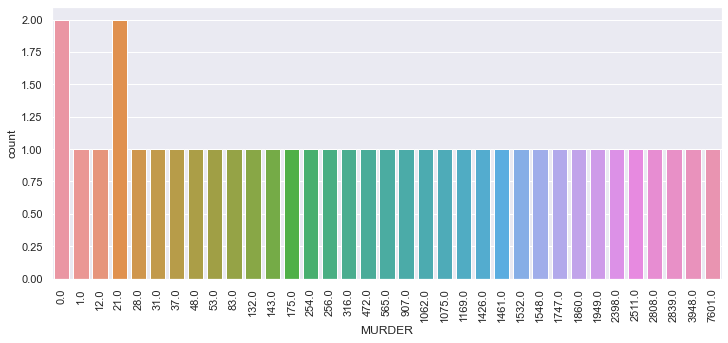

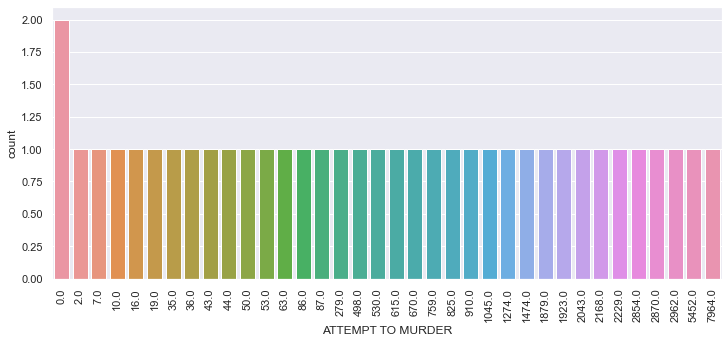

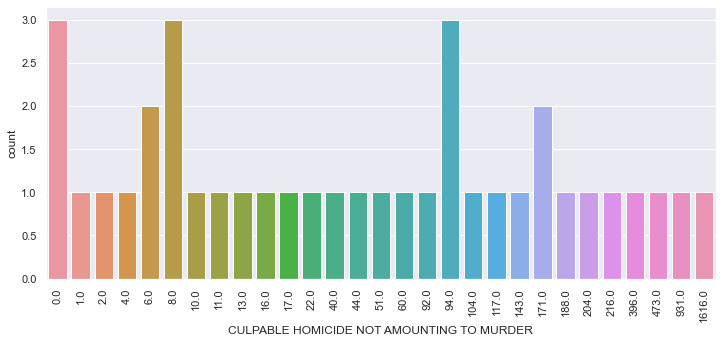

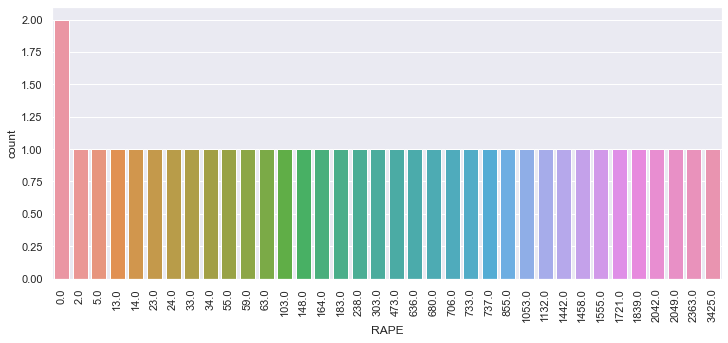

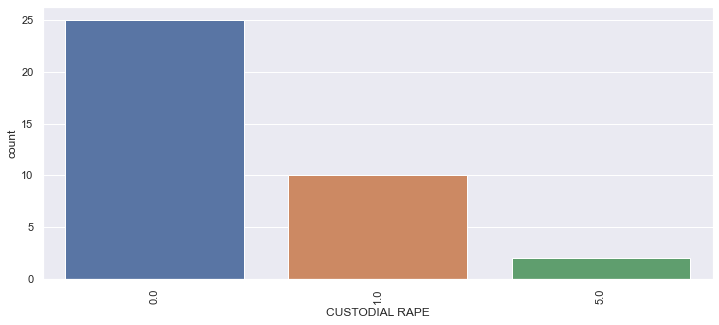

...

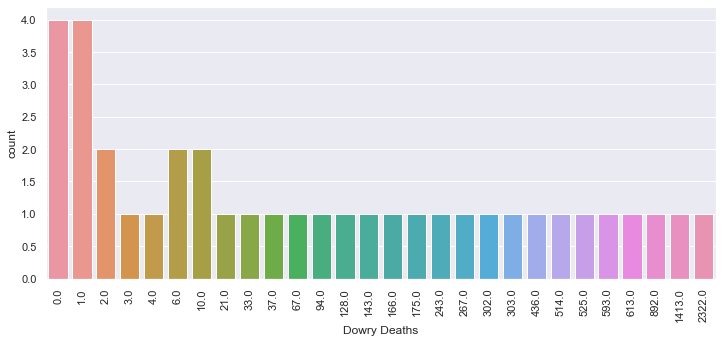

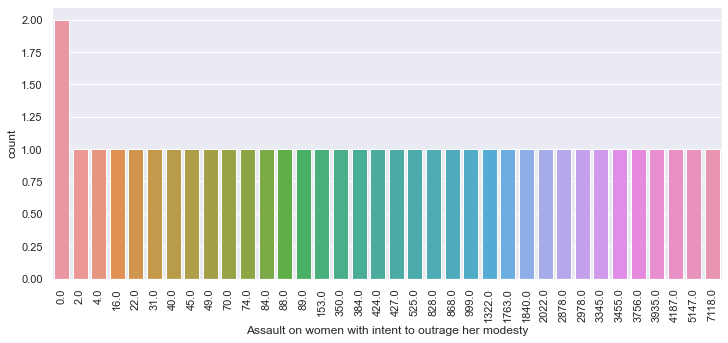

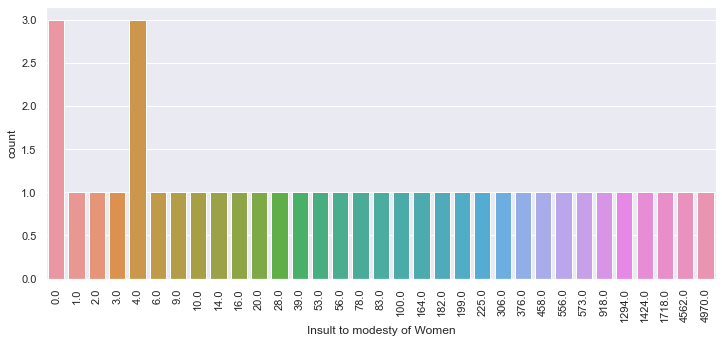

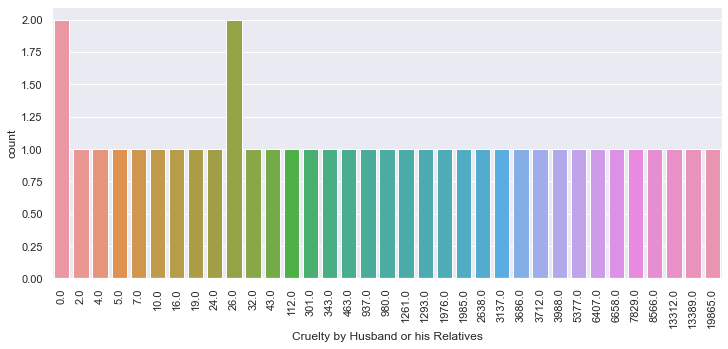

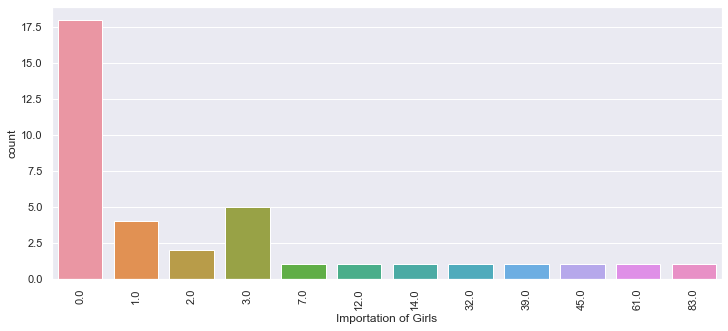

In [79]:
# countplot

for i in crimes_data.columns[1:128]:
    f= plt.figure(figsize=(12,5))
    ax = sns.countplot(x=crimes_data[i],data=crimes_data)
    plt.xticks(rotation=90)

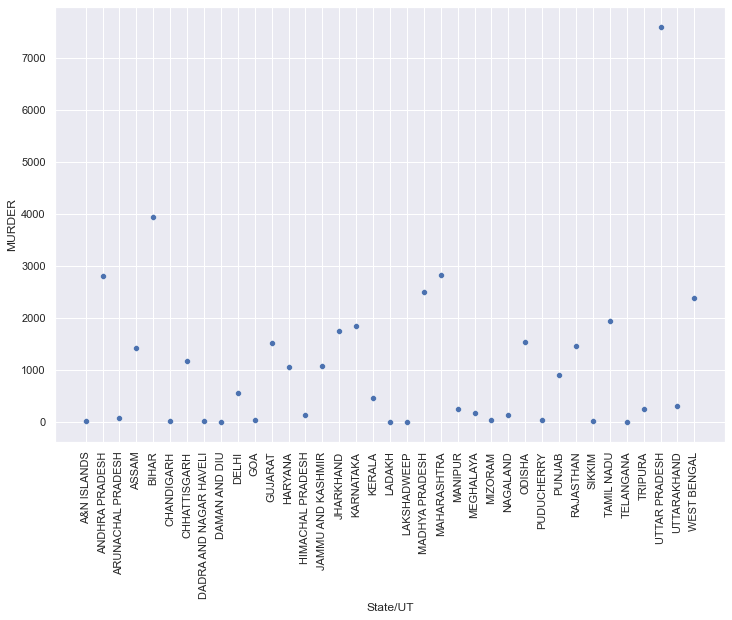

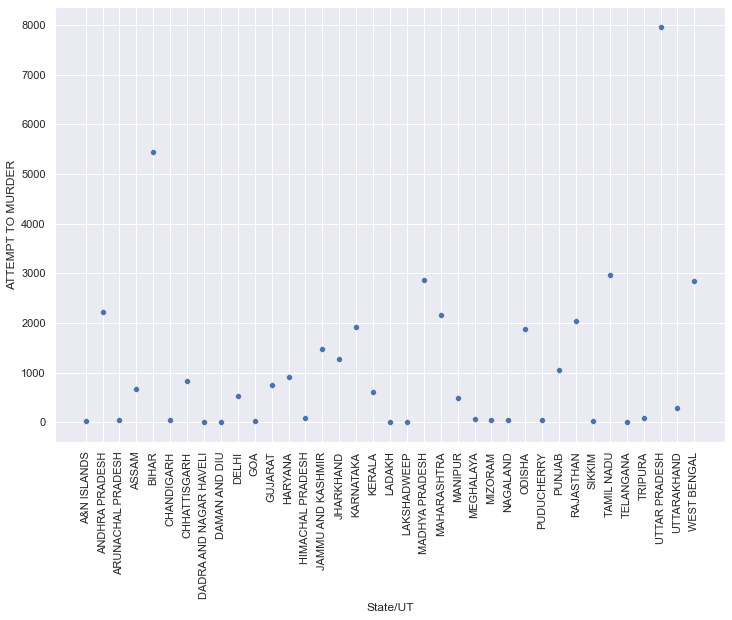

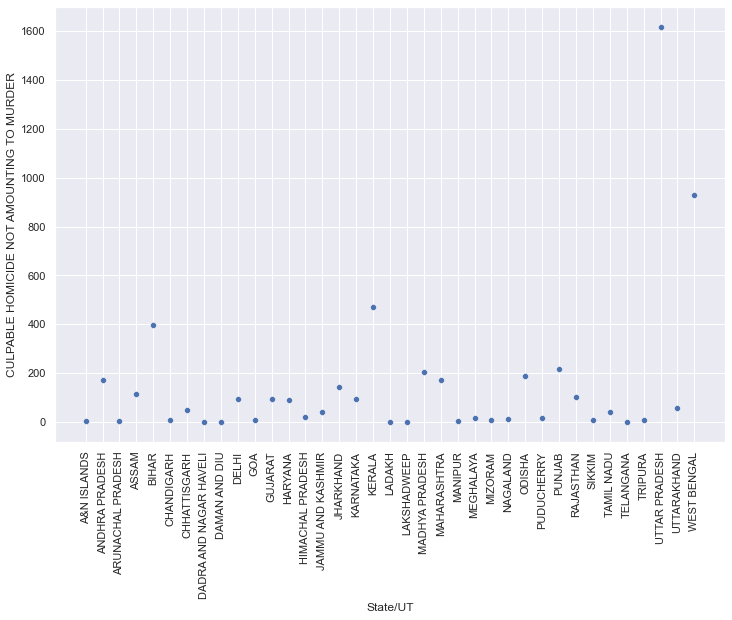

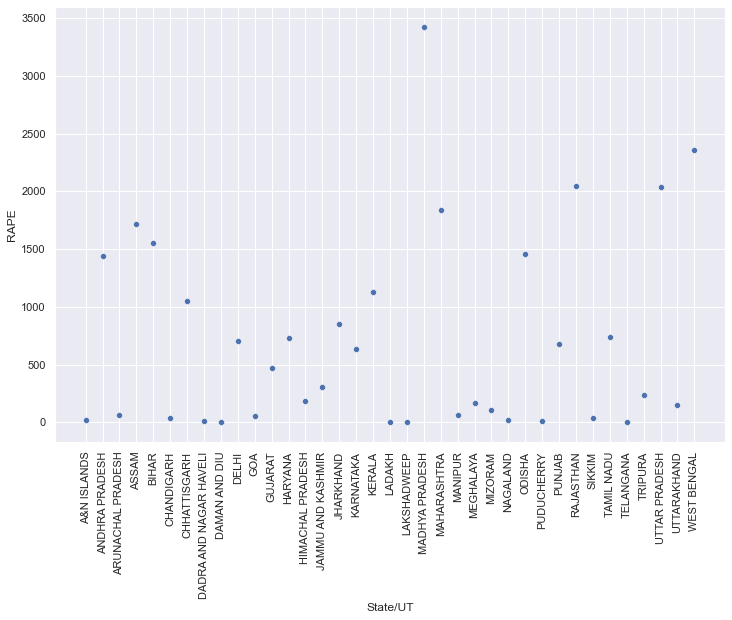

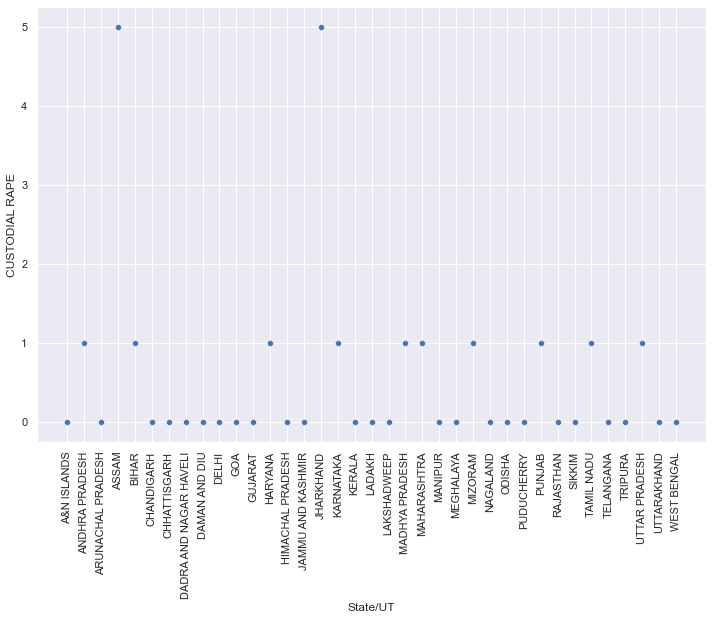

...

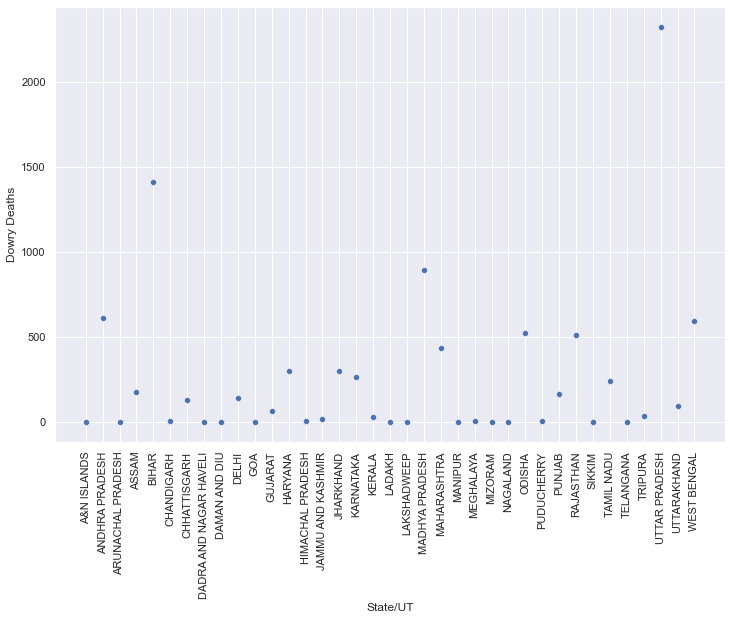

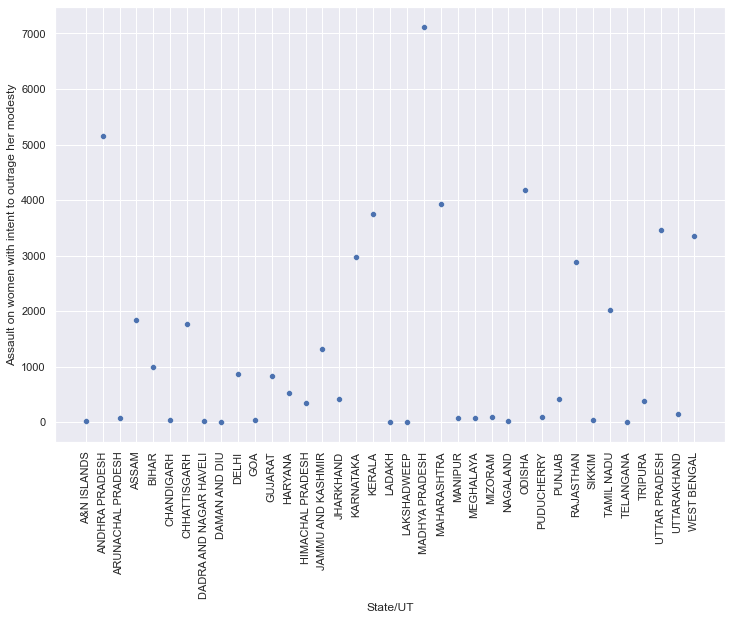

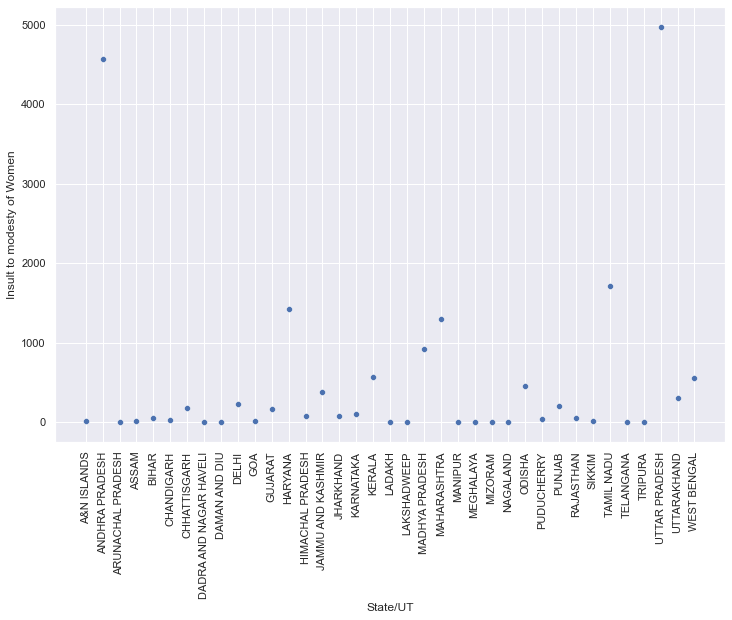

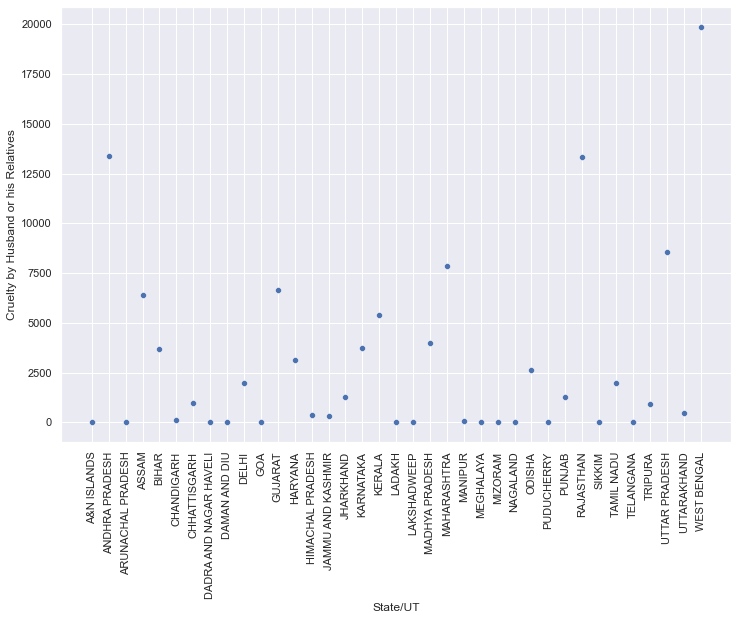

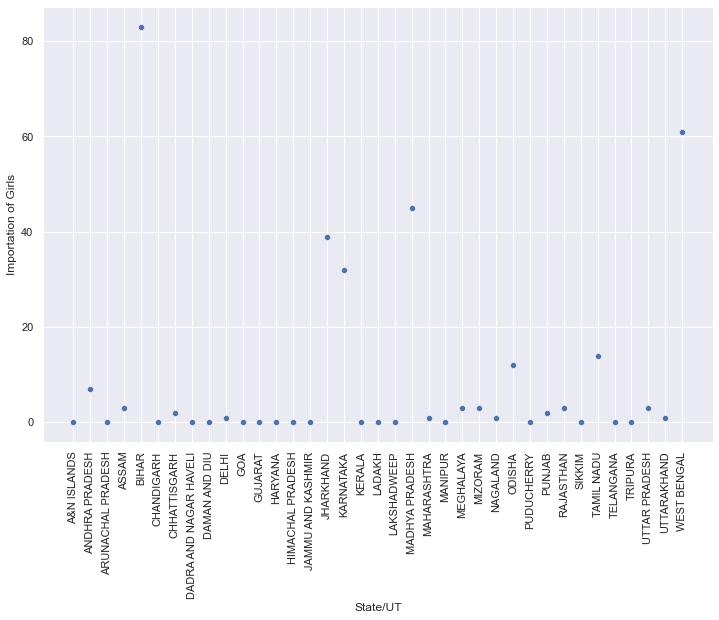

In [80]:
# Scatterplot

for i in crimes_data.columns[1:128]:
    plt.figure(figsize=(12,8))
    sns.scatterplot(x = crimes_data['State/UT'], y = i, data = crimes_data)
    plt.xticks(rotation=90)
    plt.show()

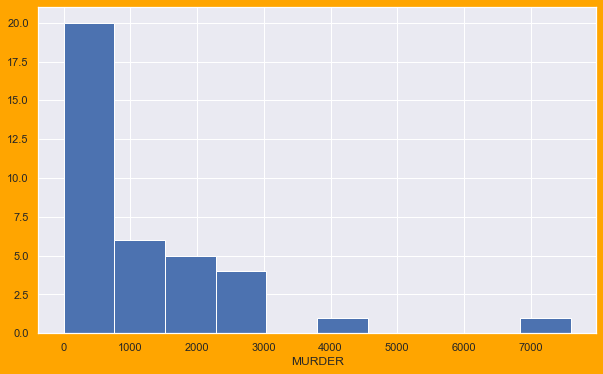

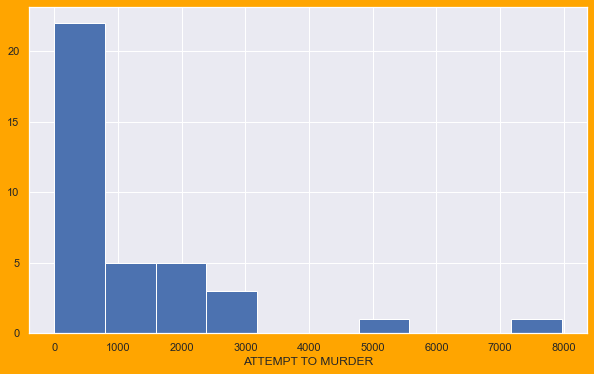

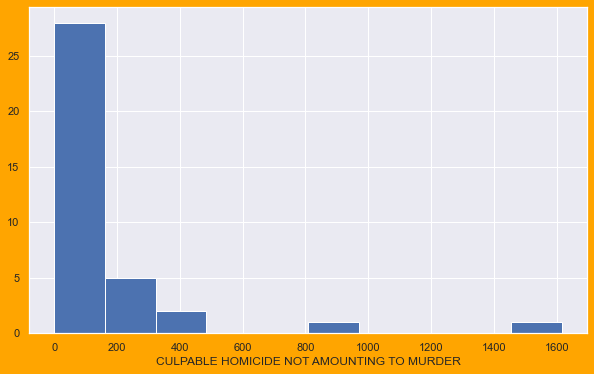

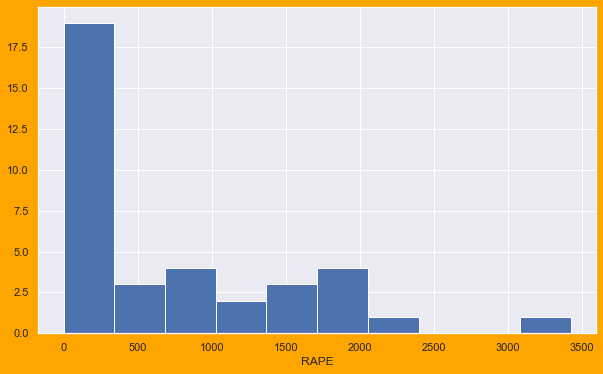

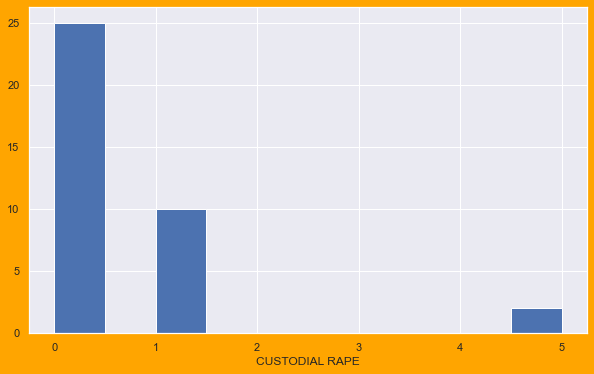

...

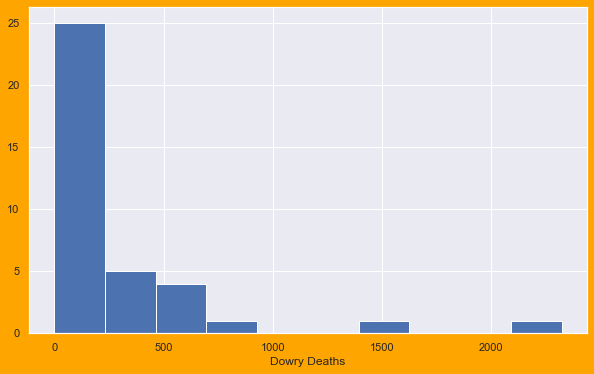

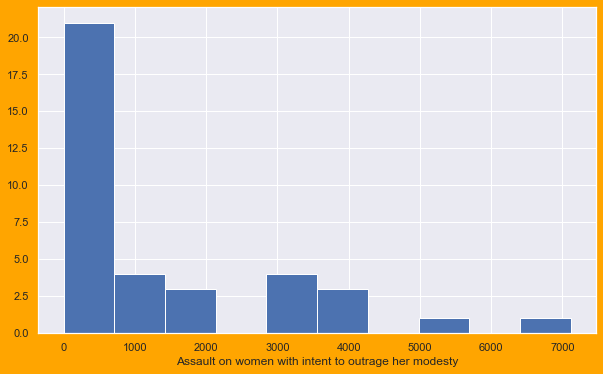

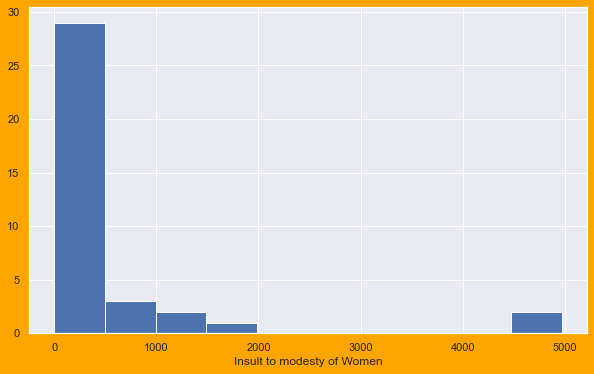

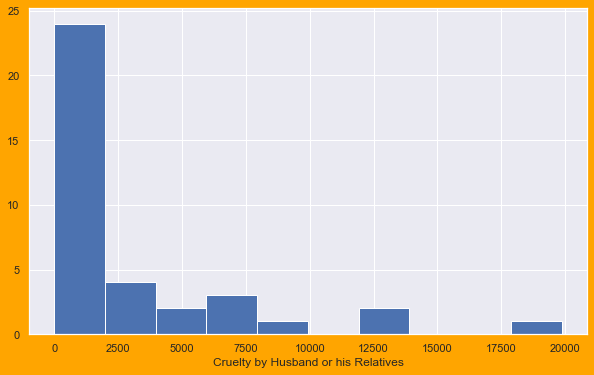

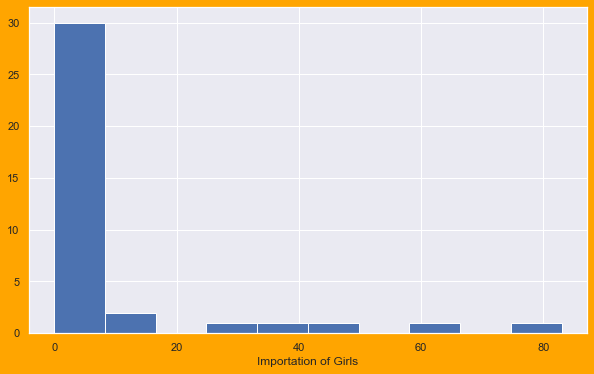

In [81]:
# Histogram plot:

for i in crimes_data.columns[1:128]:
    plt.figure(figsize=(10,6),facecolor='orange')
    plt.hist(crimes_data[i],bins=10)
    plt.xlabel(i)
    plt.show()

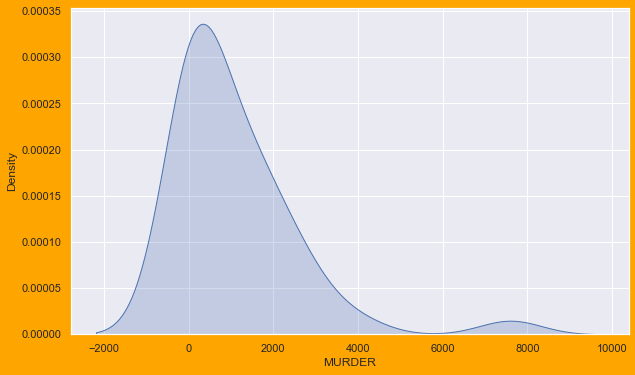

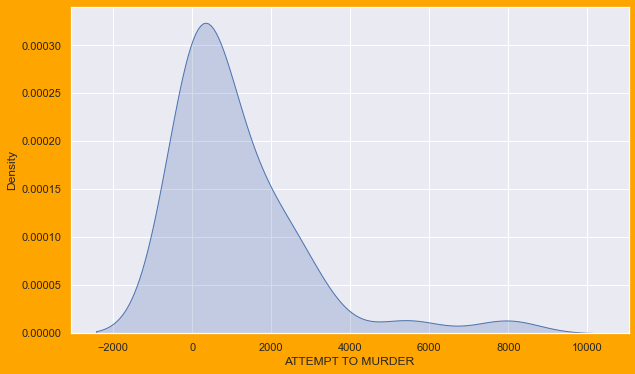

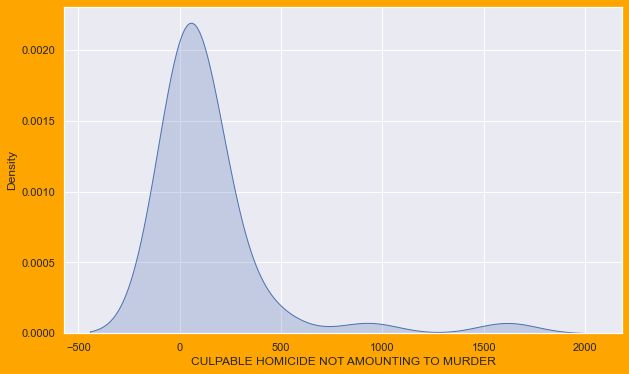

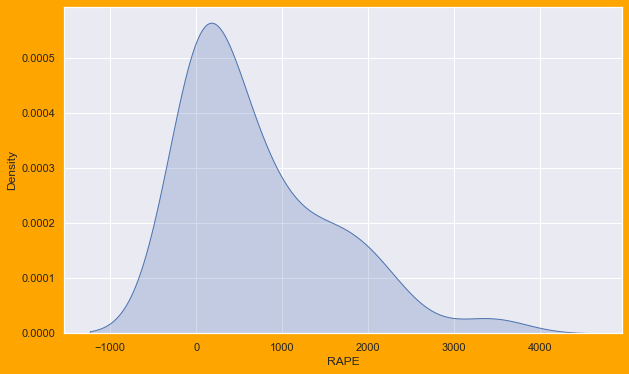

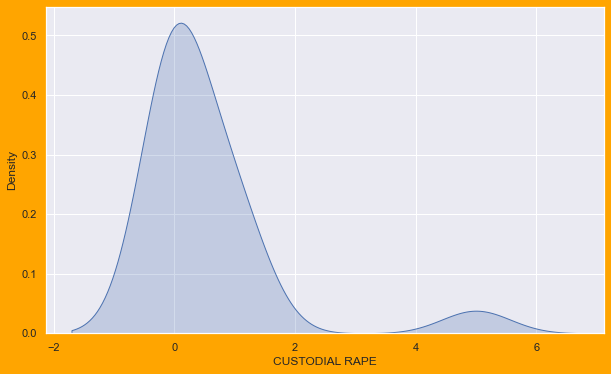

...

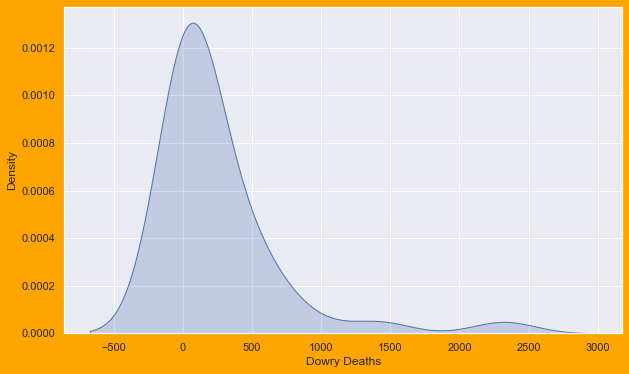

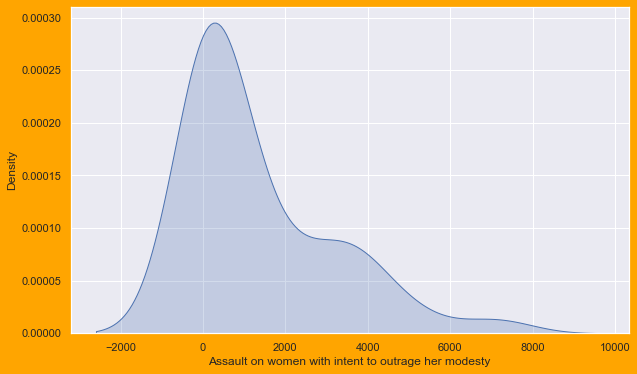

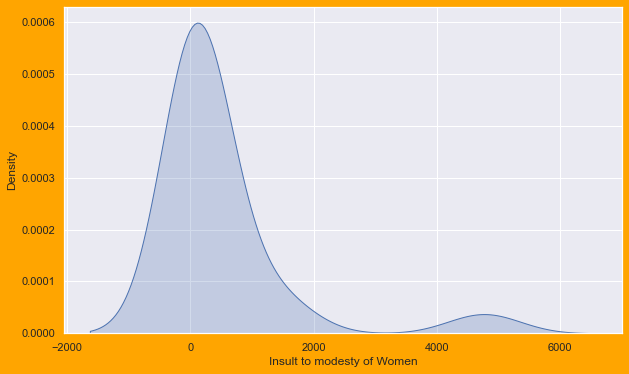

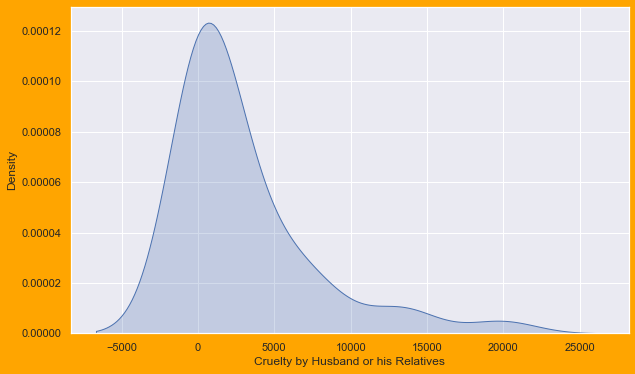

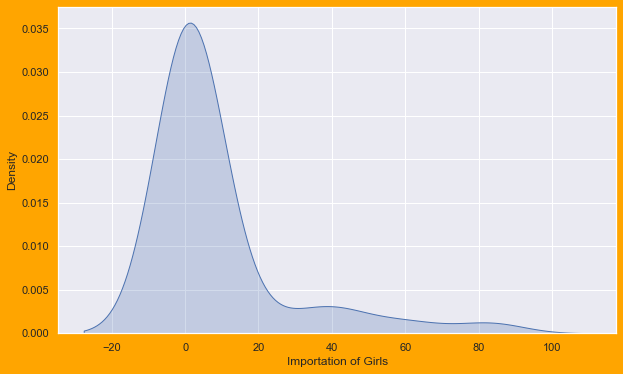

In [82]:
# Densityplot

for i in crimes_data.columns[1:128]:
    plt.figure(figsize=(10,6),facecolor='orange')
    sns.kdeplot(crimes_data[i], shade=True)
    plt.xlabel(i)
    plt.show()

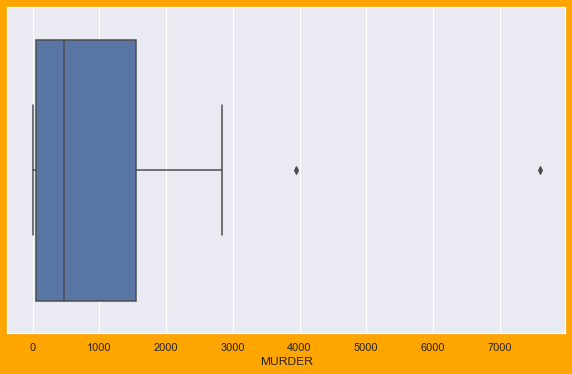

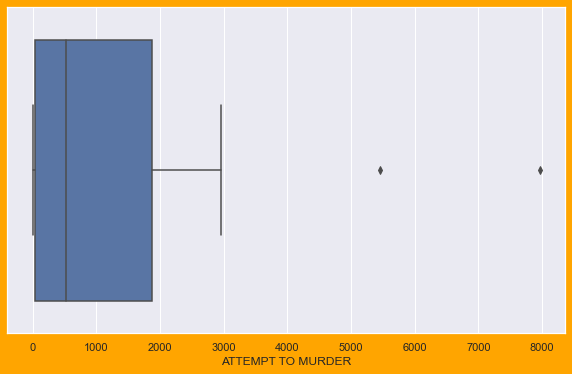

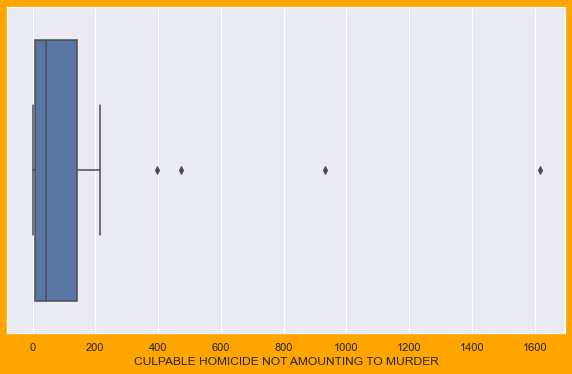

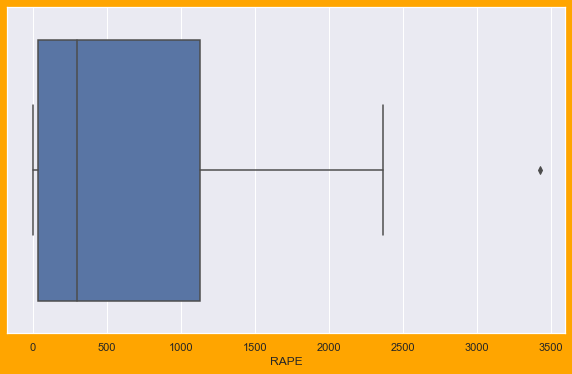

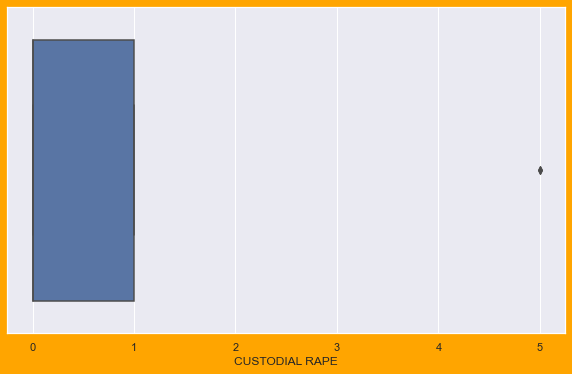

...

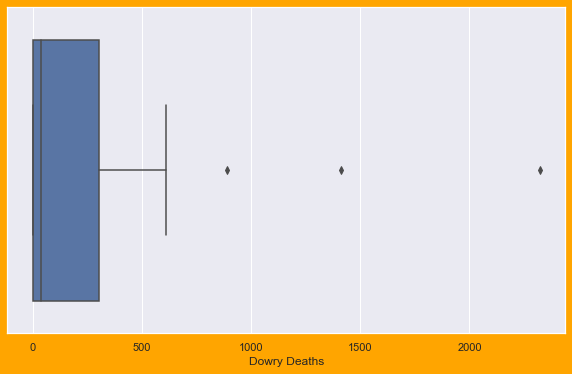

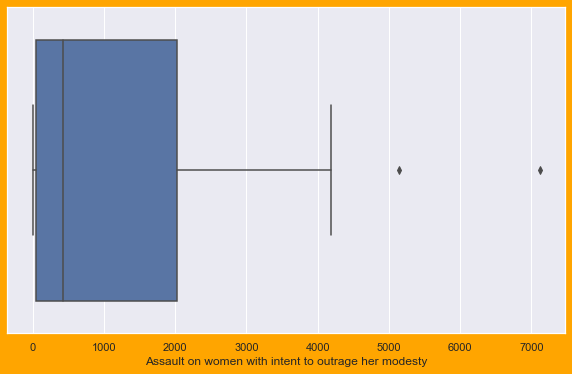

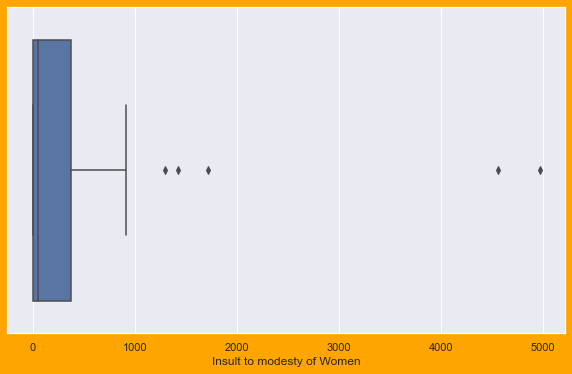

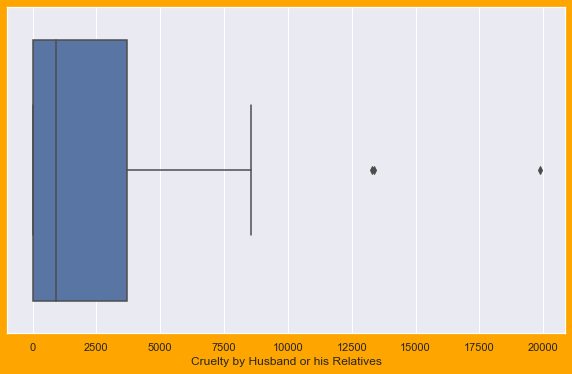

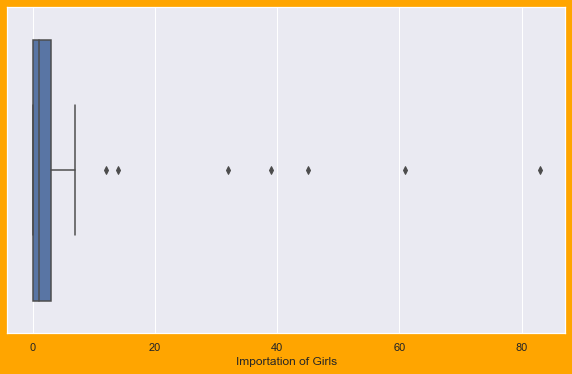

In [83]:
# Boxplots

for i in crimes_data.columns[1:128]:
    plt.figure(figsize=(10,6),facecolor='orange')
    sns.boxplot(crimes_data[i])
    plt.xlabel(i)
    plt.show()

21.000     5.405
0.000      5.405
1548.000   2.703
2511.000   2.703
2839.000   2.703
256.000    2.703
175.000    2.703
48.000     2.703
143.000    2.703
37.000     2.703
907.000    2.703
1461.000   2.703
1949.000   2.703
254.000    2.703
7601.000   2.703
316.000    2.703
1.000      2.703
472.000    2.703
2808.000   2.703
12.000     2.703
83.000     2.703
1426.000   2.703
3948.000   2.703
31.000     2.703
1169.000   2.703
28.000     2.703
565.000    2.703
1860.000   2.703
53.000     2.703
1532.000   2.703
1062.000   2.703
132.000    2.703
1075.000   2.703
1747.000   2.703
2398.000   2.703
Name: MURDER, dtype: float64


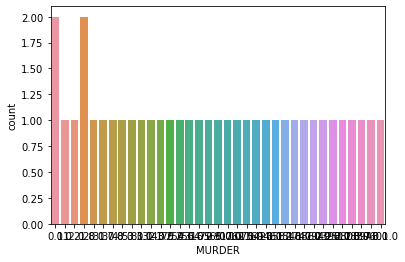

0.000      5.405
2229.000   2.703
2870.000   2.703
2168.000   2.703
498.000    2.703
63.000     2.703
36.000     2.703
50.000     2.703
1879.000   2.703
43.000     2.703
1045.000   2.703
2043.000   2.703
16.000     2.703
2962.000   2.703
87.000     2.703
7964.000   2.703
279.000    2.703
2.000      2.703
19.000     2.703
615.000    2.703
7.000      2.703
53.000     2.703
670.000    2.703
5452.000   2.703
44.000     2.703
825.000    2.703
10.000     2.703
530.000    2.703
1923.000   2.703
35.000     2.703
759.000    2.703
910.000    2.703
86.000     2.703
1474.000   2.703
1274.000   2.703
2854.000   2.703
Name: ATTEMPT TO MURDER, dtype: float64


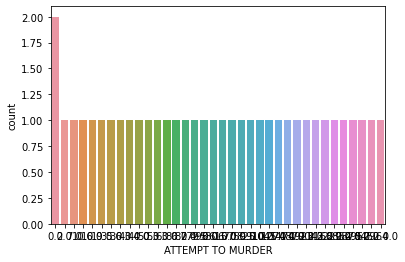

0.000      8.108
94.000     8.108
8.000      8.108
6.000      5.405
171.000    5.405
4.000      2.703
60.000     2.703
1616.000   2.703
44.000     2.703
104.000    2.703
216.000    2.703
16.000     2.703
188.000    2.703
13.000     2.703
17.000     2.703
204.000    2.703
143.000    2.703
473.000    2.703
40.000     2.703
22.000     2.703
92.000     2.703
11.000     2.703
1.000      2.703
2.000      2.703
51.000     2.703
10.000     2.703
396.000    2.703
117.000    2.703
931.000    2.703
Name: CULPABLE HOMICIDE NOT AMOUNTING TO MURDER, dtype: float64


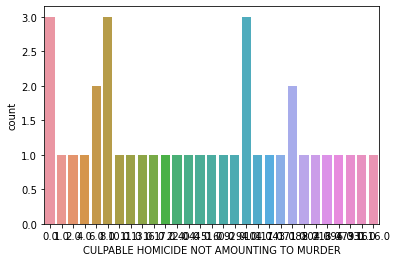

0.000      5.405
1442.000   2.703
3425.000   2.703
1839.000   2.703
63.000     2.703
164.000    2.703
103.000    2.703
23.000     2.703
1458.000   2.703
13.000     2.703
680.000    2.703
2049.000   2.703
34.000     2.703
737.000    2.703
238.000    2.703
2042.000   2.703
148.000    2.703
2.000      2.703
24.000     2.703
1132.000   2.703
5.000      2.703
59.000     2.703
1721.000   2.703
1555.000   2.703
33.000     2.703
1053.000   2.703
14.000     2.703
706.000    2.703
636.000    2.703
55.000     2.703
473.000    2.703
733.000    2.703
183.000    2.703
303.000    2.703
855.000    2.703
2363.000   2.703
Name: RAPE, dtype: float64


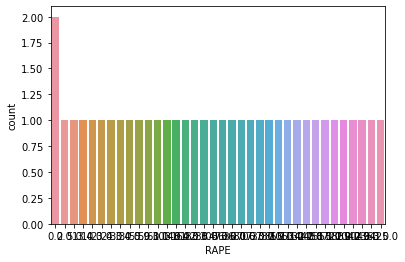

0.000   67.568
1.000   27.027
5.000    5.405
Name: CUSTODIAL RAPE, dtype: float64


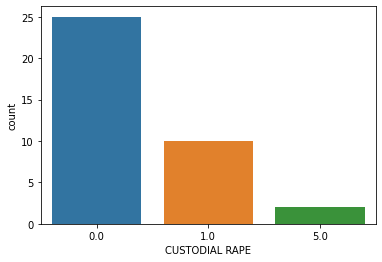

0.000      5.405
1442.000   2.703
3425.000   2.703
1839.000   2.703
63.000     2.703
164.000    2.703
103.000    2.703
23.000     2.703
1458.000   2.703
13.000     2.703
679.000    2.703
2049.000   2.703
34.000     2.703
737.000    2.703
238.000    2.703
2042.000   2.703
148.000    2.703
2.000      2.703
24.000     2.703
1132.000   2.703
5.000      2.703
59.000     2.703
1716.000   2.703
1555.000   2.703
33.000     2.703
1053.000   2.703
14.000     2.703
706.000    2.703
636.000    2.703
55.000     2.703
473.000    2.703
733.000    2.703
183.000    2.703
303.000    2.703
855.000    2.703
2363.000   2.703
Name: OTHER RAPE, dtype: float64


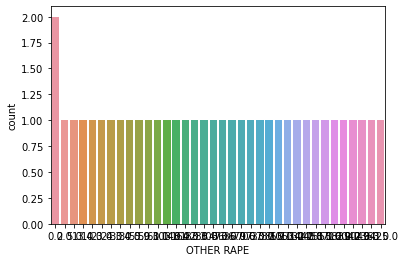

0.000      5.405
36.000     5.405
20.000     2.703
1669.000   2.703
223.000    2.703
92.000     2.703
15.000     2.703
52.000     2.703
1542.000   2.703
919.000    2.703
1.000      2.703
3243.000   2.703
10.000     2.703
1984.000   2.703
154.000    2.703
8878.000   2.703
314.000    2.703
1302.000   2.703
17.000     2.703
2154.000   2.703
299.000    2.703
1451.000   2.703
1056.000   2.703
1093.000   2.703
212.000    2.703
1349.000   2.703
1720.000   2.703
3970.000   2.703
5.000      2.703
472.000    2.703
87.000     2.703
4807.000   2.703
3812.000   2.703
93.000     2.703
5117.000   2.703
Name: KIDNAPPING & ABDUCTION, dtype: float64


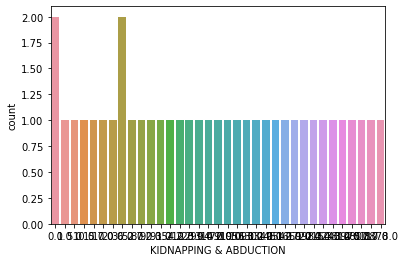

0.000      5.405
10.000     5.405
28.000     5.405
3.000      5.405
16.000     2.703
1127.000   2.703
1252.000   2.703
133.000    2.703
37.000     2.703
1364.000   2.703
14.000     2.703
1.000      2.703
2713.000   2.703
1743.000   2.703
116.000    2.703
7910.000   2.703
283.000    2.703
689.000    2.703
221.000    2.703
1612.000   2.703
1070.000   2.703
786.000    2.703
1041.000   2.703
191.000    2.703
900.000    2.703
1527.000   2.703
2160.000   2.703
365.000    2.703
66.000     2.703
3789.000   2.703
3360.000   2.703
60.000     2.703
4168.000   2.703
Name: KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS, dtype: float64


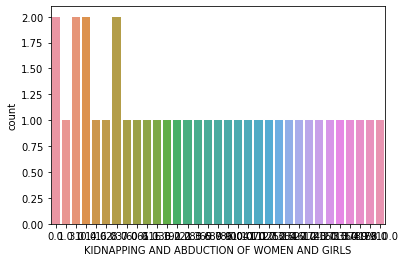

0.000      8.108
4.000      2.703
8.000      2.703
443.000    2.703
92.000     2.703
68.000     2.703
15.000     2.703
44.000     2.703
178.000    2.703
230.000    2.703
568.000    2.703
7.000      2.703
345.000    2.703
117.000    2.703
1451.000   2.703
86.000     2.703
325.000    2.703
97.000     2.703
701.000    2.703
3.000      2.703
34.000     2.703
626.000    2.703
2416.000   2.703
21.000     2.703
107.000    2.703
16.000     2.703
1810.000   2.703
788.000    2.703
11.000     2.703
248.000    2.703
449.000    2.703
32.000     2.703
103.000    2.703
338.000    2.703
949.000    2.703
Name: KIDNAPPING AND ABDUCTION OF OTHERS, dtype: float64


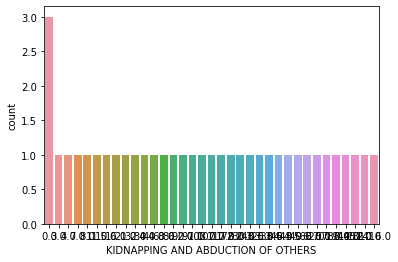

176.000    5.405
204.000    5.405
10.000     5.405
48.000     5.405
8.000      5.405
0.000      5.405
71.000     2.703
2.000      2.703
65.000     2.703
166.000    2.703
36.000     2.703
417.000    2.703
21.000     2.703
905.000    2.703
97.000     2.703
20.000     2.703
811.000    2.703
5.000      2.703
3.000      2.703
250.000    2.703
273.000    2.703
702.000    2.703
42.000     2.703
804.000    2.703
7.000      2.703
18.000     2.703
6.000      2.703
1319.000   2.703
532.000    2.703
37.000     2.703
288.000    2.703
Name: DACOITY, dtype: float64


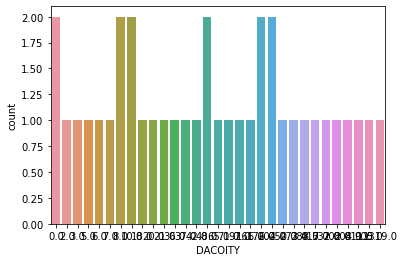

0.000      27.027
1.000       5.405
156.000     2.703
7.000       2.703
196.000     2.703
3.000       2.703
66.000      2.703
97.000      2.703
184.000     2.703
15.000      2.703
117.000     2.703
4.000       2.703
212.000     2.703
405.000     2.703
289.000     2.703
27.000      2.703
536.000     2.703
55.000      2.703
297.000     2.703
24.000      2.703
229.000     2.703
25.000      2.703
9.000       2.703
165.000     2.703
74.000      2.703
2.000       2.703
1263.000    2.703
Name: PREPARATION AND ASSEMBLY FOR DACOITY, dtype: float64


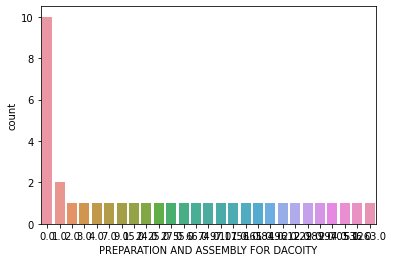

0.000      8.108
14.000     2.703
16.000     2.703
6949.000   2.703
19.000     2.703
133.000    2.703
23.000     2.703
129.000    2.703
1613.000   2.703
241.000    2.703
889.000    2.703
9.000      2.703
2066.000   2.703
95.000     2.703
3825.000   2.703
191.000    2.703
2270.000   2.703
869.000    2.703
794.000    2.703
6.000      2.703
96.000     2.703
907.000    2.703
2986.000   2.703
68.000     2.703
554.000    2.703
12.000     2.703
624.000    2.703
2207.000   2.703
39.000     2.703
1420.000   2.703
734.000    2.703
29.000     2.703
163.000    2.703
864.000    2.703
816.000    2.703
Name: ROBBERY, dtype: float64


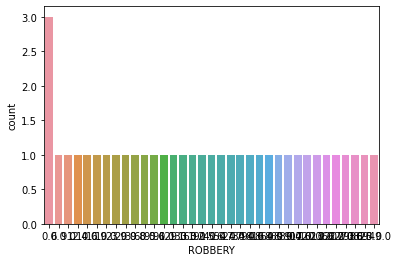

0.000       5.405
9050.000    2.703
13549.000   2.703
16617.000   2.703
76.000      2.703
203.000     2.703
487.000     2.703
163.000     2.703
3430.000    2.703
129.000     2.703
2828.000    2.703
7284.000    2.703
93.000      2.703
5965.000    2.703
239.000     2.703
8411.000    2.703
566.000     2.703
9.000       2.703
99.000      2.703
4624.000    2.703
60.000      2.703
263.000     2.703
3825.000    2.703
3758.000    2.703
364.000     2.703
4144.000    2.703
98.000      2.703
3029.000    2.703
6629.000    2.703
376.000     2.703
5844.000    2.703
5129.000    2.703
995.000     2.703
1566.000    2.703
1610.000    2.703
739.000     2.703
Name: BURGLARY, dtype: float64


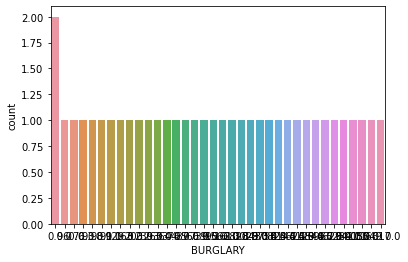

0.000       5.405
28267.000   2.703
24583.000   2.703
53449.000   2.703
903.000     2.703
696.000     2.703
1303.000    2.703
397.000     2.703
9630.000    2.703
787.000     2.703
5624.000    2.703
23314.000   2.703
127.000     2.703
18755.000   2.703
565.000     2.703
37376.000   2.703
2138.000    2.703
20.000      2.703
134.000     2.703
5818.000    2.703
63.000      2.703
531.000     2.703
9394.000    2.703
17667.000   2.703
1991.000    2.703
6079.000    2.703
174.000     2.703
23088.000   2.703
20576.000   2.703
1115.000    2.703
20715.000   2.703
17590.000   2.703
1152.000    2.703
2655.000    2.703
7716.000    2.703
22991.000   2.703
Name: THEFT, dtype: float64


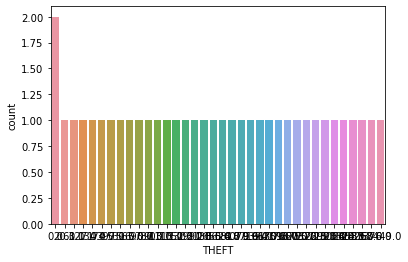

0.000       5.405
8966.000    2.703
12279.000   2.703
19270.000   2.703
736.000     2.703
190.000     2.703
77.000      2.703
194.000     2.703
3210.000    2.703
511.000     2.703
2713.000    2.703
14107.000   2.703
17.000      2.703
5045.000    2.703
140.000     2.703
22773.000   2.703
949.000     2.703
5.000       2.703
22.000      2.703
2113.000    2.703
42.000      2.703
152.000     2.703
2720.000    2.703
6404.000    2.703
1117.000    2.703
2358.000    2.703
86.000      2.703
14966.000   2.703
11093.000   2.703
463.000     2.703
11130.000   2.703
12979.000   2.703
356.000     2.703
967.000     2.703
2990.000    2.703
5158.000    2.703
Name: AUTO THEFT, dtype: float64


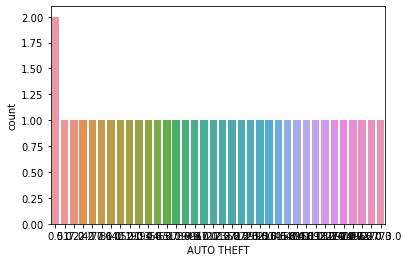

0.000       5.405
19439.000   2.703
16438.000   2.703
35960.000   2.703
304.000     2.703
532.000     2.703
1246.000    2.703
317.000     2.703
6420.000    2.703
312.000     2.703
3381.000    2.703
12615.000   2.703
118.000     2.703
14084.000   2.703
456.000     2.703
20822.000   2.703
1267.000    2.703
18.000      2.703
124.000     2.703
3837.000    2.703
30.000      2.703
412.000     2.703
7724.000    2.703
11547.000   2.703
1035.000    2.703
3981.000    2.703
136.000     2.703
11382.000   2.703
11088.000   2.703
675.000     2.703
12103.000   2.703
5035.000    2.703
828.000     2.703
1755.000    2.703
5307.000    2.703
17833.000   2.703
Name: OTHER THEFT, dtype: float64


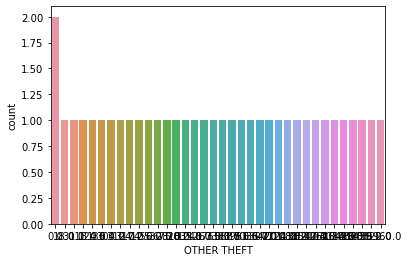

35.000      5.405
0.000       5.405
19.000      2.703
194.000     2.703
3395.000    2.703
9388.000    2.703
131.000     2.703
42.000      2.703
15.000      2.703
2721.000    2.703
16.000      2.703
11214.000   2.703
76.000      2.703
5196.000    2.703
274.000     2.703
7343.000    2.703
509.000     2.703
44.000      2.703
10938.000   2.703
3001.000    2.703
7710.000    2.703
2650.000    2.703
2169.000    2.703
649.000     2.703
1466.000    2.703
3665.000    2.703
122.000     2.703
165.000     2.703
106.000     2.703
1144.000    2.703
91.000      2.703
10871.000   2.703
5077.000    2.703
65.000      2.703
6809.000    2.703
Name: RIOTS, dtype: float64


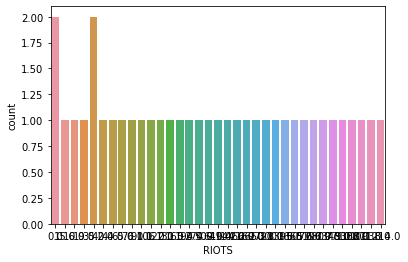

0.000      5.405
1271.000   2.703
613.000    2.703
1948.000   2.703
67.000     2.703
52.000     2.703
34.000     2.703
22.000     2.703
342.000    2.703
13.000     2.703
373.000    2.703
1026.000   2.703
10.000     2.703
360.000    2.703
54.000     2.703
4296.000   2.703
171.000    2.703
1.000      2.703
12.000     2.703
435.000    2.703
9.000      2.703
61.000     2.703
1278.000   2.703
1741.000   2.703
59.000     2.703
196.000    2.703
60.000     2.703
479.000    2.703
495.000    2.703
64.000     2.703
1873.000   2.703
919.000    2.703
143.000    2.703
195.000    2.703
639.000    2.703
1391.000   2.703
Name: CRIMINAL BREACH OF TRUST, dtype: float64


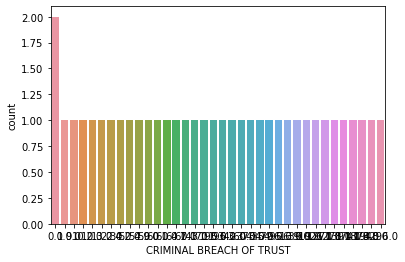

0.000       8.108
48.000      5.405
56.000      2.703
1607.000    2.703
9398.000    2.703
161.000     2.703
166.000     2.703
85.000      2.703
41.000      2.703
3581.000    2.703
90.000      2.703
19646.000   2.703
4151.000    2.703
122.000     2.703
10713.000   2.703
697.000     2.703
2021.000    2.703
5155.000    2.703
11002.000   2.703
5850.000    2.703
1566.000    2.703
612.000     2.703
373.000     2.703
1798.000    2.703
1975.000    2.703
205.000     2.703
2590.000    2.703
10.000      2.703
980.000     2.703
255.000     2.703
3933.000    2.703
1705.000    2.703
91.000      2.703
5300.000    2.703
Name: CHEATING, dtype: float64


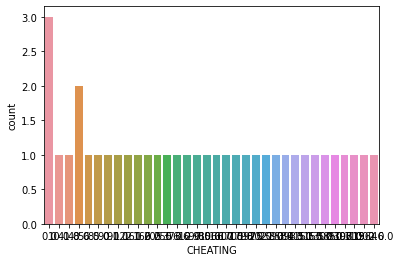

10.000    5.405
34.000    5.405
0.000     5.405
4.000     2.703
6.000     2.703
54.000    2.703
478.000   2.703
20.000    2.703
13.000    2.703
16.000    2.703
78.000    2.703
89.000    2.703
3.000     2.703
599.000   2.703
23.000    2.703
426.000   2.703
43.000    2.703
1.000     2.703
239.000   2.703
461.000   2.703
192.000   2.703
39.000    2.703
11.000    2.703
40.000    2.703
447.000   2.703
33.000    2.703
61.000    2.703
7.000     2.703
8.000     2.703
73.000    2.703
5.000     2.703
97.000    2.703
115.000   2.703
352.000   2.703
Name: COUNTERFIETING, dtype: float64


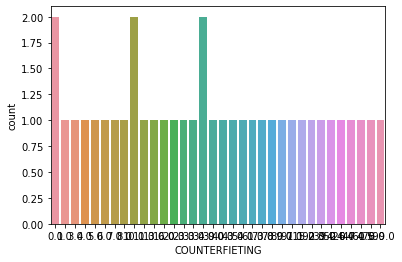

0.000      5.405
437.000    5.405
38.000     5.405
4.000      2.703
1288.000   2.703
155.000    2.703
70.000     2.703
16.000     2.703
869.000    2.703
31.000     2.703
101.000    2.703
1130.000   2.703
23.000     2.703
980.000    2.703
83.000     2.703
812.000    2.703
40.000     2.703
1053.000   2.703
15.000     2.703
1176.000   2.703
768.000    2.703
203.000    2.703
145.000    2.703
221.000    2.703
1915.000   2.703
79.000     2.703
11.000     2.703
24.000     2.703
335.000    2.703
9.000      2.703
865.000    2.703
2830.000   2.703
34.000     2.703
413.000    2.703
Name: ARSON, dtype: float64


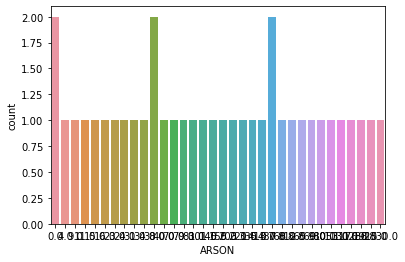

0.000       5.405
56768.000   2.703
39193.000   2.703
30212.000   2.703
378.000     2.703
207.000     2.703
142.000     2.703
55.000      2.703
8223.000    2.703
1093.000    2.703
5663.000    2.703
27485.000   2.703
100.000     2.703
31725.000   2.703
1504.000    2.703
17816.000   2.703
1198.000    2.703
14.000      2.703
118.000     2.703
21747.000   2.703
21.000      2.703
526.000     2.703
6676.000    2.703
45827.000   2.703
107.000     2.703
11105.000   2.703
70.000      2.703
2011.000    2.703
23285.000   2.703
266.000     2.703
13760.000   2.703
5135.000    2.703
1476.000    2.703
376.000     2.703
4785.000    2.703
15923.000   2.703
Name: HURT/GREVIOUS HURT, dtype: float64


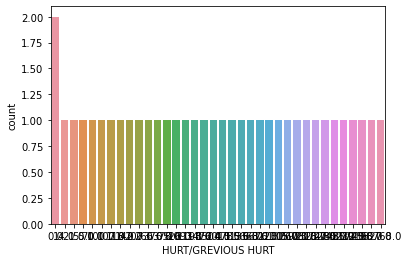

0.000      10.811
1.000      10.811
2.000       5.405
10.000      5.405
6.000       5.405
94.000      2.703
2322.000    2.703
37.000      2.703
243.000     2.703
514.000     2.703
166.000     2.703
525.000     2.703
4.000       2.703
436.000     2.703
892.000     2.703
33.000      2.703
613.000     2.703
267.000     2.703
303.000     2.703
21.000      2.703
302.000     2.703
67.000      2.703
3.000       2.703
143.000     2.703
128.000     2.703
1413.000    2.703
175.000     2.703
593.000     2.703
Name: DOWRY DEATHS, dtype: float64


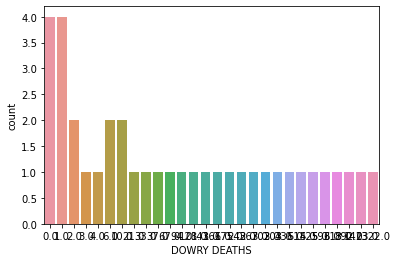

0.000      5.405
5147.000   2.703
7118.000   2.703
3935.000   2.703
70.000     2.703
74.000     2.703
88.000     2.703
16.000     2.703
4187.000   2.703
89.000     2.703
427.000    2.703
2878.000   2.703
40.000     2.703
2022.000   2.703
384.000    2.703
3455.000   2.703
153.000    2.703
2.000      2.703
31.000     2.703
3756.000   2.703
4.000      2.703
84.000     2.703
1840.000   2.703
999.000    2.703
45.000     2.703
1763.000   2.703
22.000     2.703
868.000    2.703
2978.000   2.703
49.000     2.703
828.000    2.703
525.000    2.703
350.000    2.703
1322.000   2.703
424.000    2.703
3345.000   2.703
Name: ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY, dtype: float64


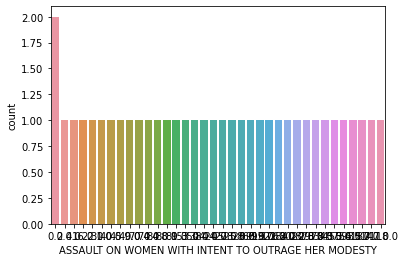

0.000      8.108
4.000      8.108
199.000    2.703
918.000    2.703
1294.000   2.703
2.000      2.703
3.000      2.703
458.000    2.703
39.000     2.703
10.000     2.703
573.000    2.703
14.000     2.703
1718.000   2.703
9.000      2.703
4970.000   2.703
306.000    2.703
56.000     2.703
100.000    2.703
4562.000   2.703
83.000     2.703
376.000    2.703
78.000     2.703
1424.000   2.703
164.000    2.703
16.000     2.703
225.000    2.703
1.000      2.703
182.000    2.703
28.000     2.703
53.000     2.703
20.000     2.703
6.000      2.703
556.000    2.703
Name: INSULT TO MODESTY OF WOMEN, dtype: float64


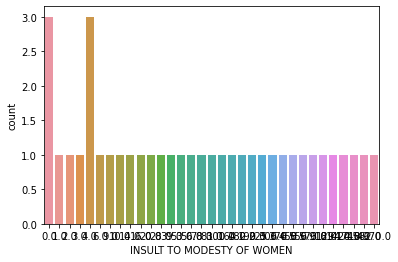

26.000      5.405
0.000       5.405
6407.000    2.703
3988.000    2.703
463.000     2.703
8566.000    2.703
937.000     2.703
1976.000    2.703
7.000       2.703
13312.000   2.703
1293.000    2.703
19.000      2.703
2638.000    2.703
4.000       2.703
16.000      2.703
32.000      2.703
43.000      2.703
7829.000    2.703
2.000       2.703
3686.000    2.703
13389.000   2.703
5377.000    2.703
3712.000    2.703
1261.000    2.703
301.000     2.703
343.000     2.703
3137.000    2.703
6658.000    2.703
24.000      2.703
1985.000    2.703
5.000       2.703
10.000      2.703
980.000     2.703
112.000     2.703
19865.000   2.703
Name: CRUELTY BY HUSBAND OR HIS RELATIVES, dtype: float64


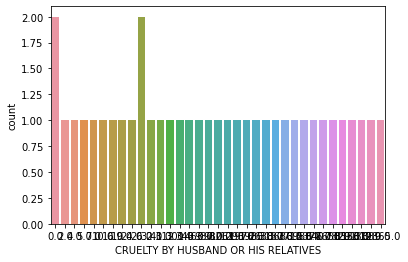

0.000    48.649
3.000    13.514
1.000    10.811
2.000     5.405
7.000     2.703
83.000    2.703
39.000    2.703
32.000    2.703
45.000    2.703
12.000    2.703
14.000    2.703
61.000    2.703
Name: IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES, dtype: float64


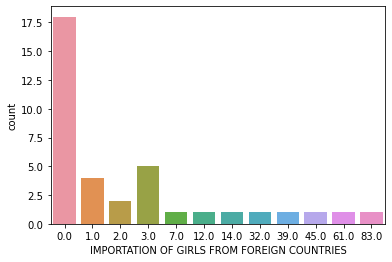

0.000       8.108
9.000       2.703
267.000     2.703
13508.000   2.703
35.000      2.703
102.000     2.703
53.000      2.703
44.000      2.703
3778.000    2.703
3576.000    2.703
8284.000    2.703
59.000      2.703
16076.000   2.703
237.000     2.703
14472.000   2.703
738.000     2.703
7721.000    2.703
65.000      2.703
14085.000   2.703
43.000      2.703
110.000     2.703
3022.000    2.703
5877.000    2.703
15.000      2.703
2907.000    2.703
48.000      2.703
1168.000    2.703
876.000     2.703
263.000     2.703
5907.000    2.703
1595.000    2.703
616.000     2.703
517.000     2.703
1745.000    2.703
4385.000    2.703
Name: CAUSING DEATH BY NEGLIGENCE, dtype: float64


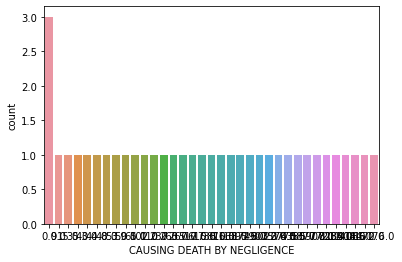

0.000        5.405
48087.000    2.703
114585.000   2.703
50183.000    2.703
1234.000     2.703
761.000      2.703
1132.000     2.703
363.000      2.703
22203.000    2.703
2668.000     2.703
10896.000    2.703
70250.000    2.703
225.000      2.703
124176.000   2.703
1742.000     2.703
68575.000    2.703
2686.000     2.703
58.000       2.703
489.000      2.703
112665.000   2.703
84.000       2.703
717.000      2.703
27077.000    2.703
56508.000    2.703
1111.000     2.703
25223.000    2.703
390.000      2.703
26805.000    2.703
65123.000    2.703
1115.000     2.703
75702.000    2.703
21804.000    2.703
8102.000     2.703
14004.000    2.703
14843.000    2.703
64482.000    2.703
Name: OTHER IPC CRIMES, dtype: float64


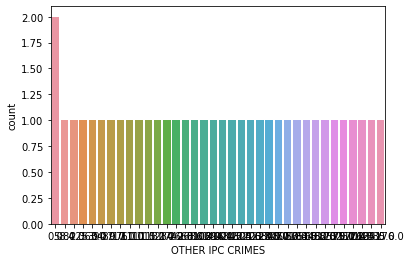

0.000     32.432
5.000      8.108
1.000      8.108
25.000     5.405
2.000      5.405
3.000      5.405
423.000    2.703
39.000     2.703
66.000     2.703
36.000     2.703
102.000    2.703
13.000     2.703
38.000     2.703
64.000     2.703
19.000     2.703
34.000     2.703
46.000     2.703
21.000     2.703
10.000     2.703
Name: Murder_x, dtype: float64


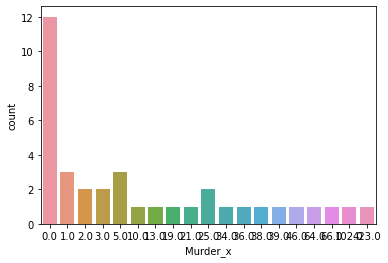

0.000     29.730
1.000      8.108
412.000    5.405
4.000      5.405
12.000     2.703
5.000      2.703
34.000     2.703
216.000    2.703
18.000     2.703
79.000     2.703
3.000      2.703
105.000    2.703
43.000     2.703
106.000    2.703
131.000    2.703
21.000     2.703
13.000     2.703
67.000     2.703
45.000     2.703
77.000     2.703
39.000     2.703
16.000     2.703
7.000      2.703
Name: Rape_x, dtype: float64


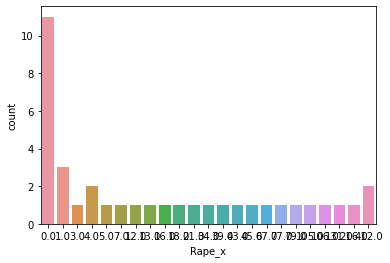

0.000     35.135
1.000     10.811
2.000      5.405
16.000     5.405
10.000     2.703
29.000     2.703
35.000     2.703
32.000     2.703
27.000     2.703
11.000     2.703
28.000     2.703
6.000      2.703
69.000     2.703
25.000     2.703
33.000     2.703
4.000      2.703
51.000     2.703
3.000      2.703
363.000    2.703
9.000      2.703
Name: Kidnapping and Abduction_x, dtype: float64


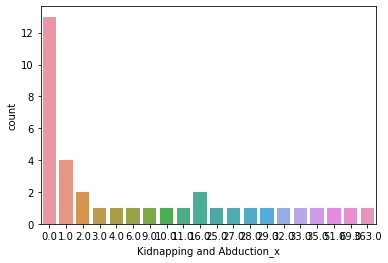

0.000    56.757
1.000    10.811
3.000     8.108
7.000     8.108
5.000     5.405
11.000    2.703
8.000     2.703
22.000    2.703
16.000    2.703
Name: Dacoity_x, dtype: float64


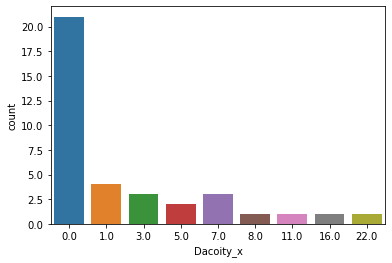

0.000    40.541
1.000    16.216
17.000    5.405
5.000     5.405
3.000     5.405
4.000     5.405
15.000    2.703
11.000    2.703
24.000    2.703
6.000     2.703
20.000    2.703
14.000    2.703
2.000     2.703
83.000    2.703
Name: Robbery_x, dtype: float64


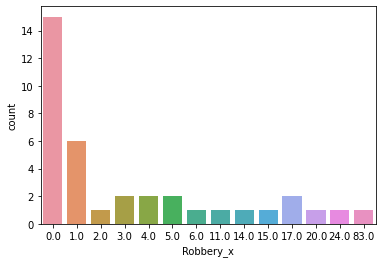

0.000     43.243
1.000     10.811
5.000      8.108
2.000      5.405
20.000     2.703
7.000      2.703
47.000     2.703
16.000     2.703
6.000      2.703
8.000      2.703
62.000     2.703
19.000     2.703
31.000     2.703
76.000     2.703
18.000     2.703
178.000    2.703
Name: Arson_x, dtype: float64


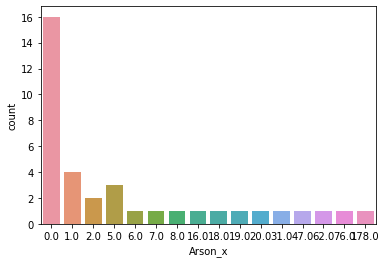

0.000      35.135
1252.000    2.703
48.000      2.703
821.000     2.703
36.000      2.703
422.000     2.703
10.000      2.703
636.000     2.703
27.000      2.703
4.000       2.703
390.000     2.703
97.000      2.703
293.000     2.703
722.000     2.703
262.000     2.703
171.000     2.703
5.000       2.703
3.000       2.703
76.000      2.703
340.000     2.703
1.000       2.703
102.000     2.703
539.000     2.703
114.000     2.703
7.000       2.703
Name: Hurt_x, dtype: float64


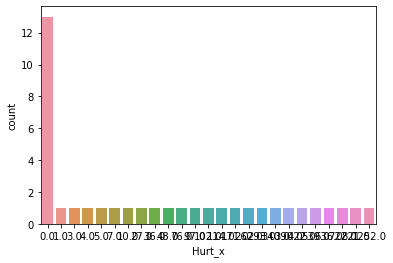

0.000      35.135
2.000       5.405
3.000       5.405
570.000     2.703
112.000     2.703
4885.000    2.703
1255.000    2.703
1.000       2.703
2965.000    2.703
99.000      2.703
1943.000    2.703
370.000     2.703
229.000     2.703
1737.000    2.703
1334.000    2.703
336.000     2.703
83.000      2.703
150.000     2.703
434.000     2.703
4.000       2.703
164.000     2.703
4436.000    2.703
37.000      2.703
Name: Prevention of atrocities (POA) Act_x, dtype: float64


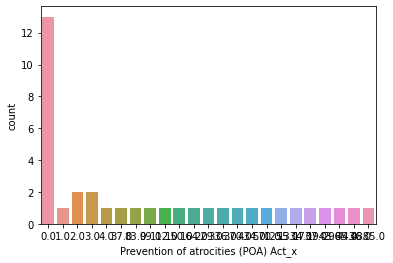

0.000     43.243
1.000      8.108
2.000      5.405
5.000      5.405
3.000      5.405
16.000     2.703
22.000     2.703
10.000     2.703
459.000    2.703
11.000     2.703
101.000    2.703
113.000    2.703
76.000     2.703
12.000     2.703
27.000     2.703
198.000    2.703
133.000    2.703
Name: Protection of Civil Rights (PCR) Act_x, dtype: float64


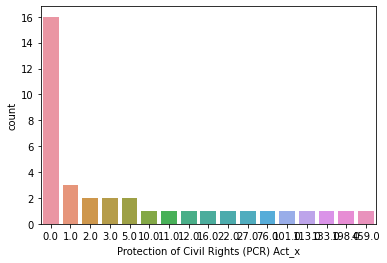

0.000      24.324
4.000       5.405
5.000       5.405
4771.000    2.703
45.000      2.703
4296.000    2.703
31.000      2.703
1105.000    2.703
4536.000    2.703
81.000      2.703
3.000       2.703
694.000     2.703
20.000      2.703
577.000     2.703
1013.000    2.703
348.000     2.703
1874.000    2.703
254.000     2.703
56.000      2.703
135.000     2.703
566.000     2.703
2.000       2.703
383.000     2.703
1.000       2.703
661.000     2.703
103.000     2.703
58.000      2.703
Name: Other Crimes Against SCs, dtype: float64


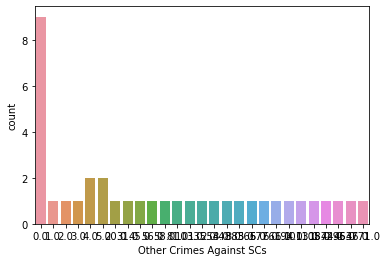

0.000    32.432
4.000    13.514
1.000    10.811
16.000    8.108
2.000     8.108
32.000    5.405
26.000    2.703
5.000     2.703
9.000     2.703
62.000    2.703
46.000    2.703
24.000    2.703
21.000    2.703
6.000     2.703
Name: Murder_y, dtype: float64


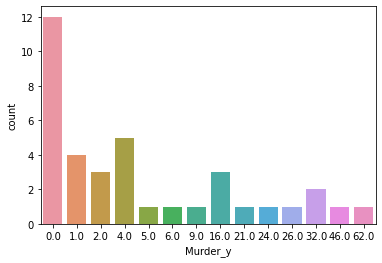

0.000     24.324
1.000     13.514
9.000      8.108
60.000     5.405
3.000      5.405
20.000     5.405
7.000      5.405
2.000      5.405
26.000     2.703
27.000     2.703
109.000    2.703
312.000    2.703
118.000    2.703
8.000      2.703
70.000     2.703
59.000     2.703
24.000     2.703
5.000      2.703
Name: Rape_y, dtype: float64


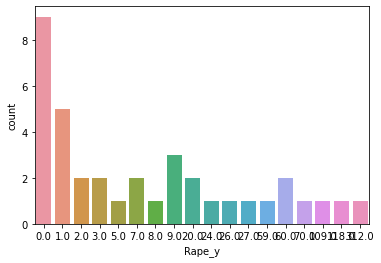

1.000    29.730
0.000    29.730
10.000    5.405
24.000    2.703
3.000     2.703
14.000    2.703
8.000     2.703
16.000    2.703
30.000    2.703
45.000    2.703
11.000    2.703
9.000     2.703
13.000    2.703
18.000    2.703
2.000     2.703
7.000     2.703
Name: Kidnapping Abduction, dtype: float64


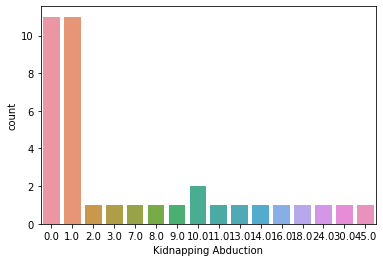

0.000    64.865
2.000    10.811
1.000     8.108
5.000     5.405
9.000     2.703
29.000    2.703
4.000     2.703
13.000    2.703
Name: Dacoity_y, dtype: float64


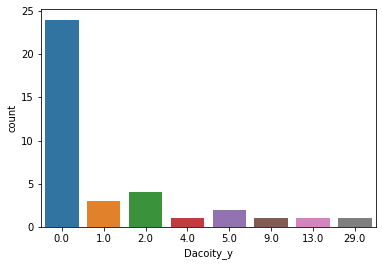

0.000    54.054
1.000    10.811
2.000     8.108
5.000     5.405
14.000    2.703
7.000     2.703
34.000    2.703
6.000     2.703
3.000     2.703
24.000    2.703
12.000    2.703
4.000     2.703
Name: Robbery_y, dtype: float64


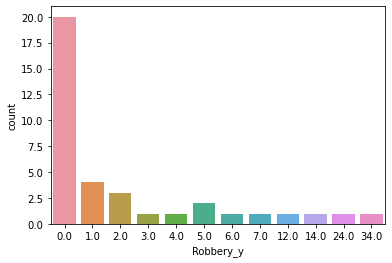

0.000    45.946
2.000    10.811
3.000    10.811
1.000     5.405
8.000     5.405
4.000     2.703
9.000     2.703
10.000    2.703
5.000     2.703
64.000    2.703
15.000    2.703
7.000     2.703
28.000    2.703
Name: Arson_y, dtype: float64


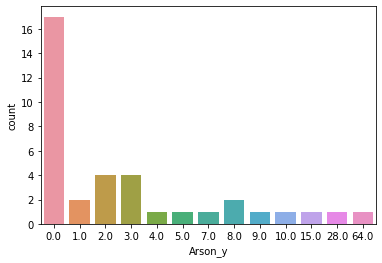

0.000     35.135
1.000      8.108
19.000     5.405
22.000     5.405
2.000      5.405
71.000     2.703
38.000     2.703
109.000    2.703
4.000      2.703
81.000     2.703
117.000    2.703
134.000    2.703
42.000     2.703
329.000    2.703
12.000     2.703
20.000     2.703
150.000    2.703
176.000    2.703
17.000     2.703
6.000      2.703
Name: Hurt_y, dtype: float64


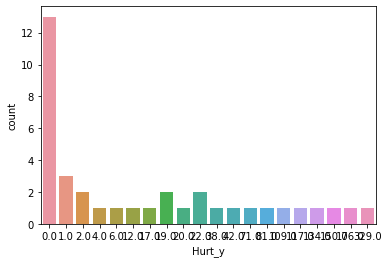

0.000     62.162
1.000     10.811
3.000      5.405
2.000      5.405
4.000      5.405
39.000     2.703
8.000      2.703
160.000    2.703
13.000     2.703
Name: Protection of Civil Rights (PCR) Act_y, dtype: float64


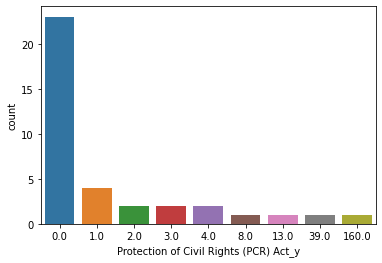

0.000     40.541
1.000     10.811
2.000      2.703
35.000     2.703
9.000      2.703
75.000     2.703
25.000     2.703
667.000    2.703
579.000    2.703
61.000     2.703
310.000    2.703
204.000    2.703
326.000    2.703
152.000    2.703
7.000      2.703
97.000     2.703
8.000      2.703
221.000    2.703
118.000    2.703
21.000     2.703
Name: Prevention of atrocities (POA) Act_y, dtype: float64


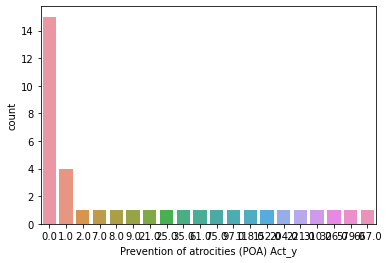

0.000      24.324
5.000       8.108
71.000      5.405
17.000      2.703
58.000      2.703
6.000       2.703
168.000     2.703
26.000      2.703
11.000      2.703
1111.000    2.703
409.000     2.703
277.000     2.703
155.000     2.703
1509.000    2.703
118.000     2.703
203.000     2.703
425.000     2.703
8.000       2.703
83.000      2.703
1.000       2.703
2.000       2.703
38.000      2.703
363.000     2.703
27.000      2.703
57.000      2.703
55.000      2.703
Name: Other Crimes Against STs, dtype: float64


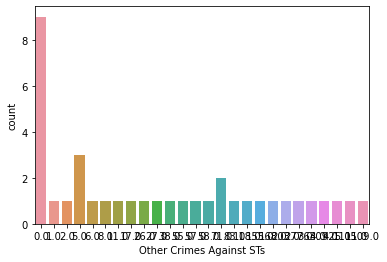

2.000     8.108
0.000     8.108
4.000     8.108
14.000    5.405
1.000     2.703
528.000   2.703
13.000    2.703
108.000   2.703
97.000    2.703
77.000    2.703
30.000    2.703
5.000     2.703
24.000    2.703
8.000     2.703
248.000   2.703
165.000   2.703
76.000    2.703
119.000   2.703
84.000    2.703
33.000    2.703
9.000     2.703
40.000    2.703
87.000    2.703
74.000    2.703
6.000     2.703
69.000    2.703
3.000     2.703
202.000   2.703
15.000    2.703
46.000    2.703
Name: Murder, dtype: float64


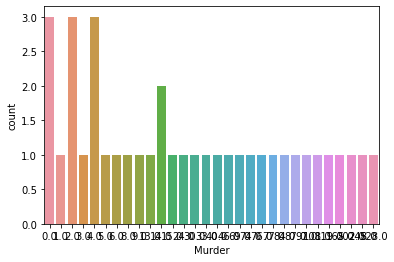

0.000      8.108
21.000     5.405
15.000     5.405
1088.000   2.703
107.000    2.703
34.000     2.703
292.000    2.703
572.000    2.703
455.000    2.703
8.000      2.703
192.000    2.703
73.000     2.703
91.000     2.703
22.000     2.703
917.000    2.703
1632.000   2.703
295.000    2.703
142.000    2.703
646.000    2.703
43.000     2.703
13.000     2.703
89.000     2.703
276.000    2.703
150.000    2.703
38.000     2.703
448.000    2.703
4.000      2.703
6.000      2.703
519.000    2.703
137.000    2.703
156.000    2.703
20.000     2.703
285.000    2.703
Name: Rape_x.1, dtype: float64


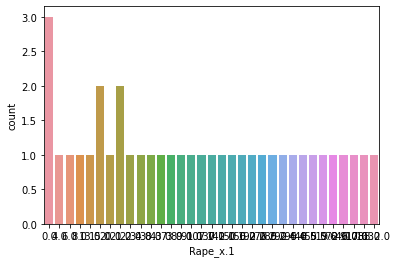

0.000      8.108
7.000      5.405
96.000     2.703
630.000    2.703
893.000    2.703
65.000     2.703
21.000     2.703
13.000     2.703
12.000     2.703
781.000    2.703
459.000    2.703
847.000    2.703
576.000    2.703
28.000     2.703
4239.000   2.703
53.000     2.703
18.000     2.703
147.000    2.703
471.000    2.703
32.000     2.703
72.000     2.703
108.000    2.703
535.000    2.703
834.000    2.703
24.000     2.703
3686.000   2.703
2.000      2.703
22.000     2.703
283.000    2.703
59.000     2.703
2546.000   2.703
68.000     2.703
27.000     2.703
767.000    2.703
Name: Kidnapping and Abduction_y, dtype: float64


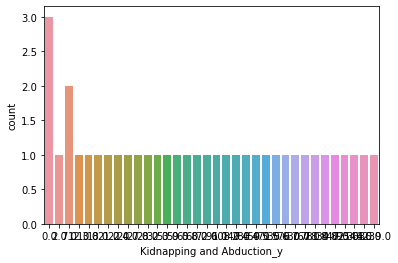

0.000    37.838
1.000    10.811
2.000    10.811
5.000     5.405
3.000     2.703
13.000    2.703
37.000    2.703
35.000    2.703
22.000    2.703
64.000    2.703
10.000    2.703
6.000     2.703
28.000    2.703
7.000     2.703
20.000    2.703
21.000    2.703
18.000    2.703
Name: Foeticide, dtype: float64


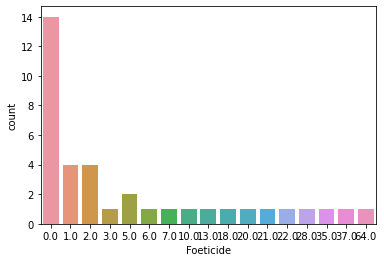

0.000    40.541
1.000    13.514
4.000    10.811
2.000     8.108
10.000    5.405
21.000    2.703
5.000     2.703
19.000    2.703
16.000    2.703
6.000     2.703
3.000     2.703
57.000    2.703
7.000     2.703
Name: Abetment of suicide, dtype: float64


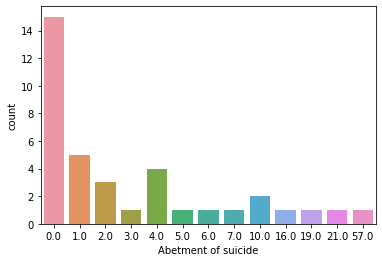

0.000     24.324
1.000     16.216
2.000      8.108
8.000      5.405
4.000      5.405
41.000     2.703
5.000      2.703
172.000    2.703
22.000     2.703
321.000    2.703
141.000    2.703
9.000      2.703
15.000     2.703
99.000     2.703
32.000     2.703
156.000    2.703
68.000     2.703
17.000     2.703
12.000     2.703
28.000     2.703
Name: Exposure and abandonment, dtype: float64


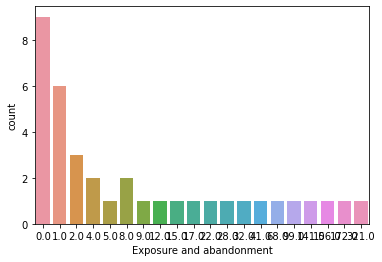

0.000     35.135
32.000     5.405
5.000      5.405
21.000     2.703
29.000     2.703
28.000     2.703
20.000     2.703
7.000      2.703
12.000     2.703
8.000      2.703
17.000     2.703
42.000     2.703
35.000     2.703
106.000    2.703
45.000     2.703
26.000     2.703
6.000      2.703
25.000     2.703
3.000      2.703
15.000     2.703
183.000    2.703
142.000    2.703
369.000    2.703
Name: Procuration of minor girls, dtype: float64


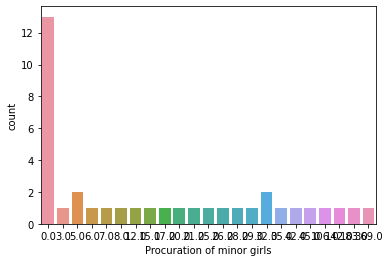

0.000    72.973
2.000     8.108
9.000     5.405
1.000     5.405
5.000     2.703
31.000    2.703
48.000    2.703
Name: Buying of girls for prostitution, dtype: float64


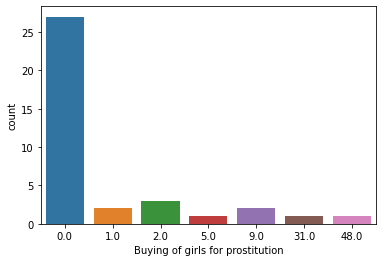

0.000     54.054
1.000     13.514
2.000      8.108
3.000      5.405
11.000     2.703
10.000     2.703
4.000      2.703
7.000      2.703
25.000     2.703
18.000     2.703
115.000    2.703
Name: Selling of girls for prostitution, dtype: float64


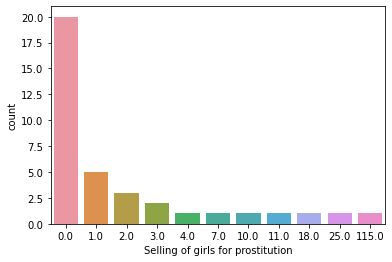

0.000    35.135
1.000    13.514
2.000     5.405
11.000    5.405
5.000     5.405
6.000     5.405
43.000    5.405
29.000    2.703
16.000    2.703
26.000    2.703
38.000    2.703
4.000     2.703
20.000    2.703
18.000    2.703
3.000     2.703
10.000    2.703
Name: Prohibition of child marriage act, dtype: float64


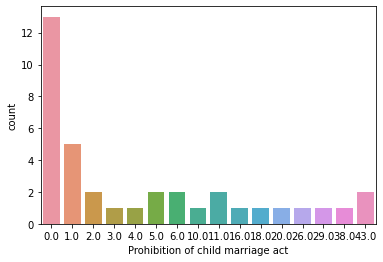

0.000      8.108
42.000     5.405
14.000     5.405
4.000      5.405
24.000     2.703
99.000     2.703
3004.000   2.703
1277.000   2.703
5.000      2.703
18.000     2.703
97.000     2.703
6.000      2.703
89.000     2.703
63.000     2.703
1440.000   2.703
23.000     2.703
1.000      2.703
835.000    2.703
633.000    2.703
96.000     2.703
46.000     2.703
7.000      2.703
69.000     2.703
107.000    2.703
304.000    2.703
61.000     2.703
489.000    2.703
978.000    2.703
13.000     2.703
147.000    2.703
3.000      2.703
122.000    2.703
Name: Other Crimes, dtype: float64


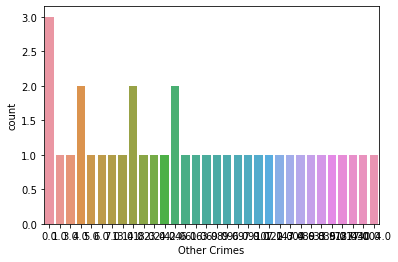

0.000     13.514
2.000      5.405
9.000      5.405
14.000     5.405
19.000     2.703
13.000     2.703
57.000     2.703
6.000      2.703
68.000     2.703
28.000     2.703
1.000      2.703
59.000     2.703
3.000      2.703
183.000    2.703
234.000    2.703
355.000    2.703
249.000    2.703
112.000    2.703
237.000    2.703
11.000     2.703
7.000      2.703
33.000     2.703
118.000    2.703
15.000     2.703
54.000     2.703
133.000    2.703
16.000     2.703
124.000    2.703
18.000     2.703
21.000     2.703
Name: Boys 7-12 Years, dtype: float64


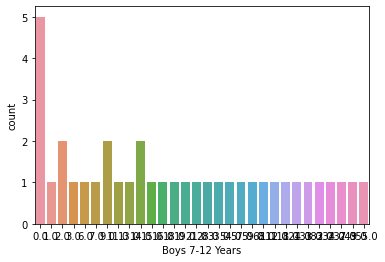

0.000    29.730
3.000    10.811
1.000     8.108
7.000     8.108
2.000     8.108
4.000     8.108
14.000    5.405
5.000     2.703
6.000     2.703
47.000    2.703
29.000    2.703
23.000    2.703
22.000    2.703
11.000    2.703
12.000    2.703
Name: Girls 7-12 Years, dtype: float64


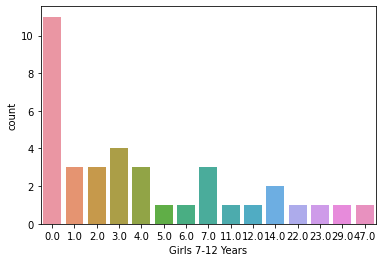

0.000      8.108
16.000     5.405
463.000    5.405
356.000    5.405
64.000     2.703
293.000    2.703
26.000     2.703
15.000     2.703
865.000    2.703
70.000     2.703
35.000     2.703
248.000    2.703
67.000     2.703
2340.000   2.703
2900.000   2.703
1.000      2.703
252.000    2.703
734.000    2.703
336.000    2.703
18.000     2.703
74.000     2.703
464.000    2.703
755.000    2.703
40.000     2.703
3.000      2.703
20.000     2.703
1317.000   2.703
78.000     2.703
258.000    2.703
396.000    2.703
88.000     2.703
66.000     2.703
Name: Boys 12-16 Years, dtype: float64


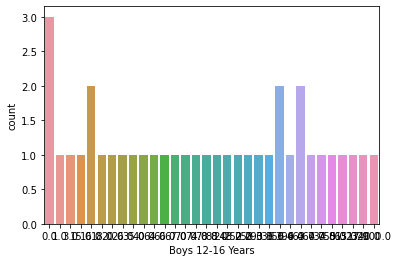

0.000     13.514
1.000      8.108
16.000     8.108
3.000      5.405
2.000      5.405
4.000      5.405
6.000      5.405
13.000     2.703
17.000     2.703
54.000     2.703
43.000     2.703
5.000      2.703
85.000     2.703
143.000    2.703
177.000    2.703
15.000     2.703
49.000     2.703
7.000      2.703
37.000     2.703
97.000     2.703
29.000     2.703
62.000     2.703
9.000      2.703
60.000     2.703
10.000     2.703
Name: Girls 12-16 Years, dtype: float64


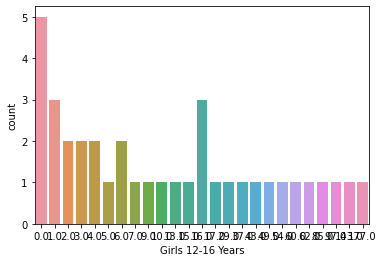

0.000      10.811
81.000      5.405
40.000      2.703
4017.000    2.703
4072.000    2.703
101.000     2.703
226.000     2.703
34.000      2.703
316.000     2.703
36.000      2.703
523.000     2.703
1891.000    2.703
959.000     2.703
42.000      2.703
469.000     2.703
124.000     2.703
117.000     2.703
290.000     2.703
1216.000    2.703
443.000     2.703
1.000       2.703
143.000     2.703
1294.000    2.703
1495.000    2.703
56.000      2.703
813.000     2.703
11.000      2.703
32.000      2.703
1456.000    2.703
1195.000    2.703
484.000     2.703
100.000     2.703
577.000     2.703
Name: Boys 16-18 Years, dtype: float64


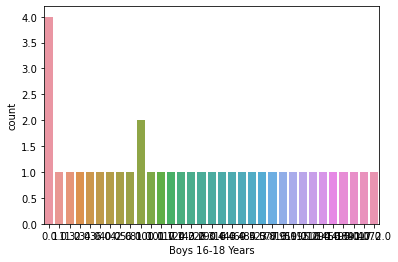

0.000     13.514
9.000      8.108
2.000      5.405
16.000     5.405
4.000      5.405
1.000      5.405
56.000     2.703
328.000    2.703
23.000     2.703
99.000     2.703
308.000    2.703
10.000     2.703
5.000      2.703
69.000     2.703
7.000      2.703
243.000    2.703
151.000    2.703
6.000      2.703
32.000     2.703
92.000     2.703
129.000    2.703
82.000     2.703
194.000    2.703
81.000     2.703
36.000     2.703
75.000     2.703
25.000     2.703
Name: Girls 16-18 Years, dtype: float64


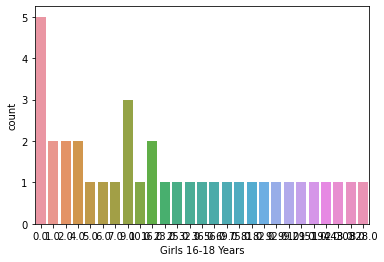

0.000      8.108
47.000     2.703
75.000     2.703
6670.000   2.703
6251.000   2.703
128.000    2.703
500.000    2.703
46.000     2.703
727.000    2.703
215.000    2.703
2560.000   2.703
81.000     2.703
1290.000   2.703
69.000     2.703
767.000    2.703
177.000    2.703
1.000      2.703
779.000    2.703
1806.000   2.703
14.000     2.703
195.000    2.703
1004.000   2.703
1349.000   2.703
166.000    2.703
2737.000   2.703
52.000     2.703
1232.000   2.703
641.000    2.703
83.000     2.703
2316.000   2.703
1762.000   2.703
196.000    2.703
20.000     2.703
791.000    2.703
651.000    2.703
Name: Total for boys all Age Groups, dtype: float64


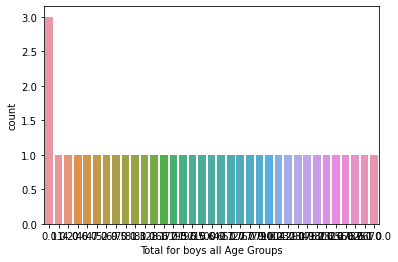

0.000       10.811
484.000      2.703
27960.000    2.703
47.000       2.703
331.000      2.703
1348.000     2.703
216.000      2.703
5927.000     2.703
5885.000     2.703
19848.000    2.703
8551.000     2.703
76.000       2.703
19263.000    2.703
307.000      2.703
9846.000     2.703
964.000      2.703
13504.000    2.703
12.000       2.703
4479.000     2.703
10293.000    2.703
2153.000     2.703
1522.000     2.703
658.000      2.703
8106.000     2.703
9316.000     2.703
434.000      2.703
10505.000    2.703
44.000       2.703
3792.000     2.703
849.000      2.703
3414.000     2.703
3857.000     2.703
401.000      2.703
4854.000     2.703
Name: Cases_Property_Recovered, dtype: float64


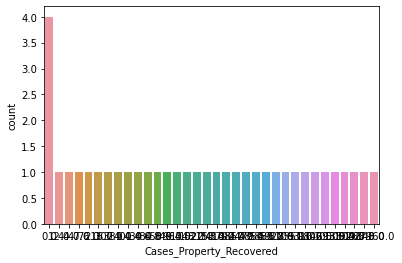

0.000       10.811
891.000      2.703
80663.000    2.703
910.000      2.703
1238.000     2.703
2063.000     2.703
785.000      2.703
12945.000    2.703
9873.000     2.703
36407.000    2.703
28152.000    2.703
222.000      2.703
25825.000    2.703
902.000      2.703
36711.000    2.703
2346.000     2.703
39064.000    2.703
58.000       2.703
12938.000    2.703
30575.000    2.703
10989.000    2.703
4341.000     2.703
2214.000     2.703
23549.000    2.703
29407.000    2.703
1483.000     2.703
28118.000    2.703
144.000      2.703
11111.000    2.703
2529.000     2.703
23314.000    2.703
17809.000    2.703
949.000      2.703
23759.000    2.703
Name: Cases_Property_Stolen, dtype: float64


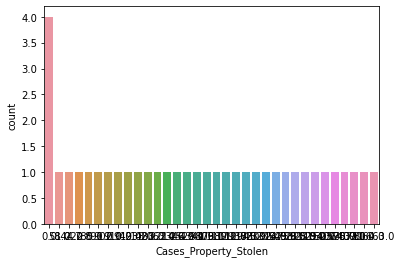

0.000            10.811
22257370.000      2.703
2337827896.000    2.703
48045570.000      2.703
14458164.000      2.703
42121387.000      2.703
35836810.000      2.703
311033656.000     2.703
646232099.000     2.703
725079668.000     2.703
854388626.000     2.703
4275311.000       2.703
660311804.000     2.703
7188915.000       2.703
1161786732.000    2.703
47135685.000      2.703
7470011363.000    2.703
300000.000        2.703
384303742.000     2.703
999646710.000     2.703
63504472.000      2.703
97683758.000      2.703
60928343.000      2.703
750221865.000     2.703
483489012.000     2.703
26756962.000      2.703
244579475.000     2.703
7758679.000       2.703
144046856.000     2.703
52203913.000      2.703
74962835.000      2.703
181939717.000     2.703
168882335.000     2.703
1168242161.000    2.703
Name: Value_of_Property_Recovered, dtype: float64


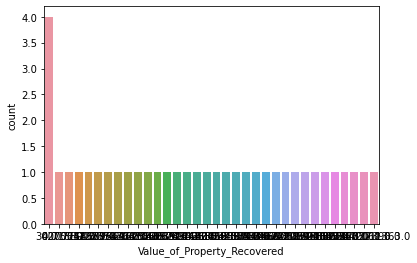

0.000             10.811
30249484.000       2.703
23776254525.000    2.703
119195331.000      2.703
268521456.000      2.703
151610184.000      2.703
736004694.000      2.703
2775976092.000     2.703
1102678622.000     2.703
1533054566.000     2.703
1475572408.000     2.703
164361102.000      2.703
1317919190.000     2.703
55631705.000       2.703
1820103969.000     2.703
123398840.000      2.703
8265789122.000     2.703
3077000.000        2.703
2812836460.000     2.703
2781334074.000     2.703
472956236.000      2.703
226297520.000      2.703
327419480.000      2.703
1247668627.000     2.703
6575355355.000     2.703
656580967.000      2.703
7785717012.000     2.703
46597505.000       2.703
472964216.000      2.703
120437559.000      2.703
547924668.000      2.703
525464095.000      2.703
246090594.000      2.703
5015168687.000     2.703
Name: Value_of_Property_Stolen, dtype: float64


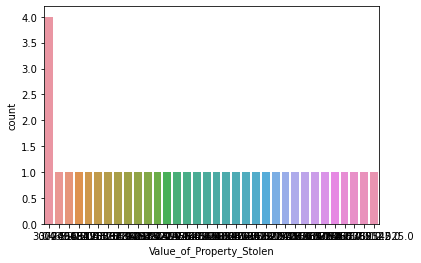

0.000     18.919
2.000      8.108
1.000      8.108
5.000      5.405
16.000     5.405
39.000     5.405
98.000     2.703
89.000     2.703
41.000     2.703
351.000    2.703
15.000     2.703
30.000     2.703
36.000     2.703
278.000    2.703
177.000    2.703
22.000     2.703
136.000    2.703
55.000     2.703
26.000     2.703
3.000      2.703
64.000     2.703
20.000     2.703
9.000      2.703
45.000     2.703
Name: Police_Injured_By_Criminals, dtype: float64


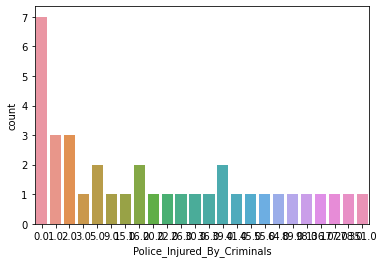

0.000      18.919
22.000      8.108
1.000       8.108
137.000     2.703
17.000      2.703
69.000      2.703
94.000      2.703
286.000     2.703
71.000      2.703
7.000       2.703
54.000      2.703
75.000      2.703
2.000       2.703
557.000     2.703
511.000     2.703
133.000     2.703
241.000     2.703
26.000      2.703
2930.000    2.703
40.000      2.703
344.000     2.703
59.000      2.703
104.000     2.703
37.000      2.703
50.000      2.703
10.000      2.703
398.000     2.703
Name: Police_Injured_By_Riotous_Mobs, dtype: float64


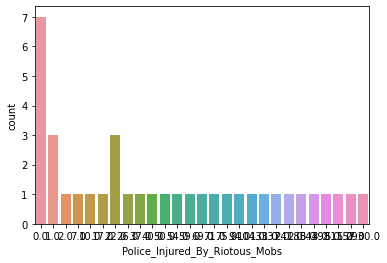

0.000     21.622
27.000     5.405
15.000     5.405
19.000     5.405
8.000      5.405
2.000      5.405
148.000    2.703
73.000     2.703
240.000    2.703
39.000     2.703
28.000     2.703
20.000     2.703
3.000      2.703
1.000      2.703
69.000     2.703
40.000     2.703
121.000    2.703
56.000     2.703
47.000     2.703
6.000      2.703
50.000     2.703
7.000      2.703
14.000     2.703
10.000     2.703
179.000    2.703
Name: Police_Injured_In_Accidents, dtype: float64


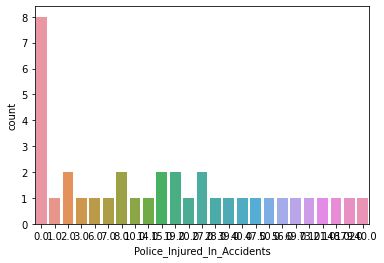

0.000     37.838
4.000     13.514
15.000     5.405
3.000      5.405
21.000     5.405
5.000      5.405
28.000     2.703
7.000      2.703
8.000      2.703
9.000      2.703
1.000      2.703
69.000     2.703
101.000    2.703
2.000      2.703
25.000     2.703
38.000     2.703
Name: Police_Injured_In_Dacoity_OperationsOther_raids, dtype: float64


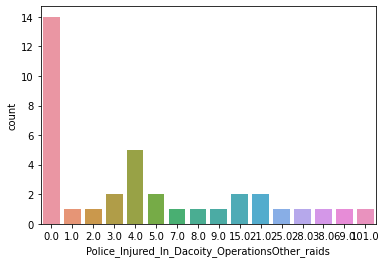

0.000     40.541
1.000      8.108
2.000      8.108
10.000     2.703
6.000      2.703
55.000     2.703
35.000     2.703
9.000      2.703
68.000     2.703
5.000      2.703
38.000     2.703
45.000     2.703
281.000    2.703
22.000     2.703
13.000     2.703
71.000     2.703
19.000     2.703
41.000     2.703
32.000     2.703
Name: Police_Injured_In_TerroristsExtremists_Operations, dtype: float64


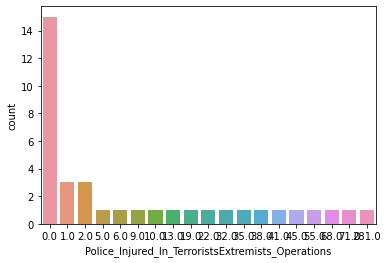

0.000     59.459
1.000     10.811
2.000      5.405
17.000     2.703
13.000     2.703
8.000      2.703
146.000    2.703
7.000      2.703
33.000     2.703
6.000      2.703
11.000     2.703
3.000      2.703
Name: Police_Injured_On_Border_Duties, dtype: float64


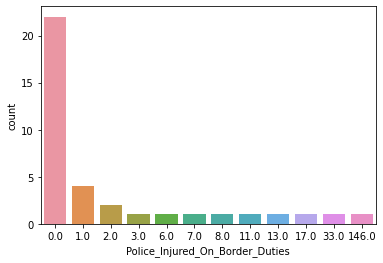

0.000      16.216
55.000      5.405
287.000     2.703
25.000      2.703
220.000     2.703
270.000     2.703
2.000       2.703
460.000     2.703
81.000      2.703
30.000      2.703
89.000      2.703
3.000       2.703
4.000       2.703
75.000      2.703
10.000      2.703
825.000     2.703
623.000     2.703
286.000     2.703
488.000     2.703
42.000      2.703
2957.000    2.703
48.000      2.703
61.000      2.703
425.000     2.703
64.000      2.703
240.000     2.703
143.000     2.703
62.000      2.703
50.000      2.703
16.000      2.703
500.000     2.703
Name: Police_Injured_Total_Policemen, dtype: float64


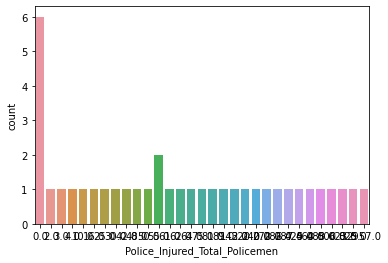

0.000    29.730
1.000    10.811
5.000     8.108
6.000     8.108
3.000     8.108
4.000     5.405
11.000    5.405
14.000    5.405
15.000    2.703
9.000     2.703
12.000    2.703
31.000    2.703
13.000    2.703
2.000     2.703
19.000    2.703
Name: Police_Killed_By_Criminals, dtype: float64


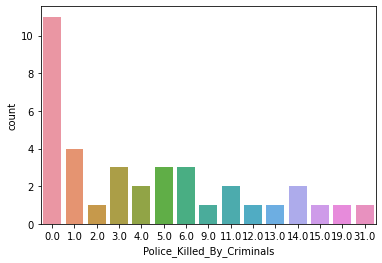

0.000    40.541
1.000    24.324
5.000     8.108
3.000     8.108
4.000     5.405
6.000     5.405
9.000     2.703
2.000     2.703
10.000    2.703
Name: Police_Killed_By_Riotous_Mobs, dtype: float64


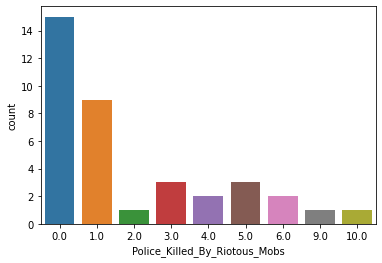

0.000     16.216
1.000     13.514
3.000      5.405
21.000     5.405
13.000     2.703
5.000      2.703
113.000    2.703
4.000      2.703
79.000     2.703
2.000      2.703
41.000     2.703
108.000    2.703
10.000     2.703
6.000      2.703
90.000     2.703
30.000     2.703
15.000     2.703
53.000     2.703
32.000     2.703
17.000     2.703
8.000      2.703
52.000     2.703
59.000     2.703
45.000     2.703
14.000     2.703
16.000     2.703
Name: Police_Killed_In_Accidents, dtype: float64


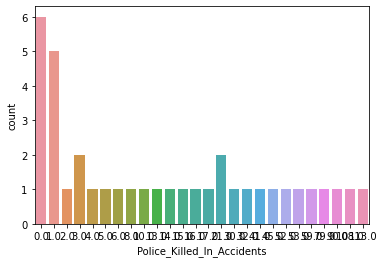

0.000    45.946
1.000    18.919
3.000    10.811
2.000    10.811
4.000     5.405
12.000    2.703
7.000     2.703
11.000    2.703
Name: Police_Killed_In_Dacoity_OperationsOther_raids, dtype: float64


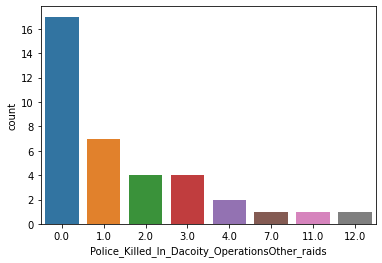

0.000     43.243
1.000      8.108
3.000      5.405
7.000      5.405
40.000     5.405
6.000      2.703
90.000     2.703
129.000    2.703
31.000     2.703
17.000     2.703
52.000     2.703
14.000     2.703
24.000     2.703
9.000      2.703
22.000     2.703
2.000      2.703
8.000      2.703
Name: Police_Killed_In_TerroristsExtremists_Operations, dtype: float64


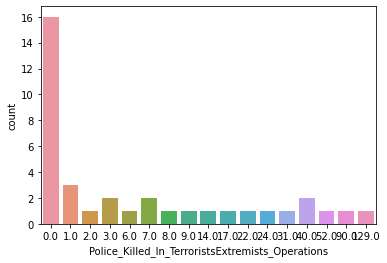

0.000    62.162
1.000    10.811
2.000     8.108
9.000     5.405
12.000    2.703
3.000     2.703
7.000     2.703
10.000    2.703
8.000     2.703
Name: Police_Killed_On_Border_Duties, dtype: float64


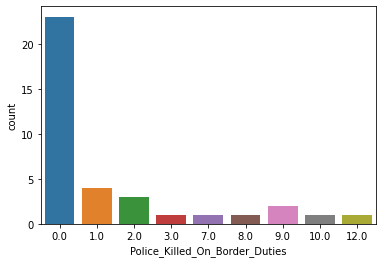

0.000     16.216
1.000      8.108
5.000      5.405
54.000     5.405
18.000     5.405
152.000    2.703
142.000    2.703
42.000     2.703
80.000     2.703
51.000     2.703
110.000    2.703
25.000     2.703
3.000      2.703
11.000     2.703
14.000     2.703
17.000     2.703
43.000     2.703
70.000     2.703
28.000     2.703
55.000     2.703
150.000    2.703
8.000      2.703
64.000     2.703
103.000    2.703
38.000     2.703
34.000     2.703
27.000     2.703
Name: Police_Killed_Total_Policemen, dtype: float64


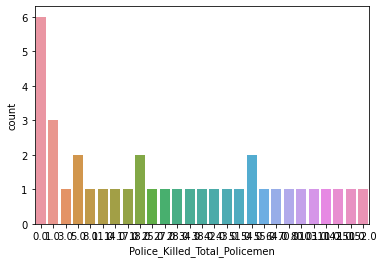

0.000     8.108
2.000     8.108
3.000     8.108
5.000     5.405
30.000    5.405
833.000   2.703
78.000    2.703
23.000    2.703
402.000   2.703
26.000    2.703
64.000    2.703
14.000    2.703
17.000    2.703
114.000   2.703
10.000    2.703
195.000   2.703
66.000    2.703
45.000    2.703
84.000    2.703
339.000   2.703
120.000   2.703
1.000     2.703
29.000    2.703
283.000   2.703
19.000    2.703
27.000    2.703
381.000   2.703
6.000     2.703
110.000   2.703
Name: RESIDENTIAL PREMISES - Dacoity, dtype: float64


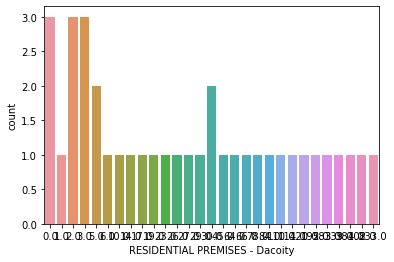

0.000     8.108
4.000     5.405
8.000     5.405
33.000    5.405
215.000   2.703
46.000    2.703
504.000   2.703
45.000    2.703
472.000   2.703
6.000     2.703
73.000    2.703
255.000   2.703
51.000    2.703
3.000     2.703
444.000   2.703
449.000   2.703
703.000   2.703
262.000   2.703
367.000   2.703
65.000    2.703
7.000     2.703
99.000    2.703
233.000   2.703
10.000    2.703
163.000   2.703
1.000     2.703
74.000    2.703
17.000    2.703
436.000   2.703
337.000   2.703
75.000    2.703
112.000   2.703
Name: RESIDENTIAL PREMISES - Robbery, dtype: float64


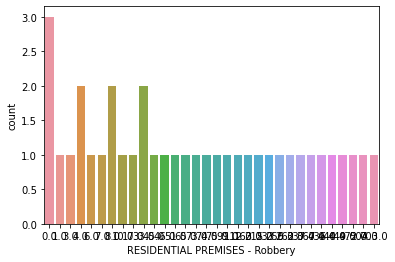

0.000       5.405
6504.000    2.703
10043.000   2.703
10557.000   2.703
36.000      2.703
112.000     2.703
375.000     2.703
89.000      2.703
2341.000    2.703
71.000      2.703
1454.000    2.703
4377.000    2.703
64.000      2.703
3680.000    2.703
161.000     2.703
6693.000    2.703
376.000     2.703
4.000       2.703
68.000      2.703
2600.000    2.703
34.000      2.703
195.000     2.703
2166.000    2.703
3077.000    2.703
239.000     2.703
3336.000    2.703
52.000      2.703
2175.000    2.703
4469.000    2.703
212.000     2.703
3774.000    2.703
3409.000    2.703
518.000     2.703
904.000     2.703
1374.000    2.703
341.000     2.703
Name: RESIDENTIAL PREMISES - Burglary, dtype: float64


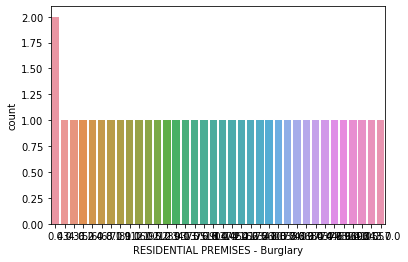

0.000       5.405
9766.000    2.703
9437.000    2.703
10930.000   2.703
247.000     2.703
276.000     2.703
630.000     2.703
266.000     2.703
2472.000    2.703
203.000     2.703
1624.000    2.703
3219.000    2.703
96.000      2.703
5555.000    2.703
315.000     2.703
6588.000    2.703
894.000     2.703
13.000      2.703
41.000      2.703
1876.000    2.703
14.000      2.703
297.000     2.703
4265.000    2.703
6740.000    2.703
832.000     2.703
1623.000    2.703
94.000      2.703
7076.000    2.703
5224.000    2.703
220.000     2.703
4407.000    2.703
5538.000    2.703
157.000     2.703
640.000     2.703
3554.000    2.703
7671.000    2.703
Name: RESIDENTIAL PREMISES - Theft, dtype: float64


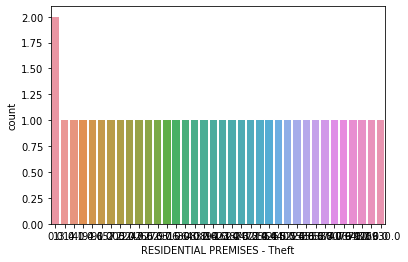

0.000     18.919
2.000      8.108
17.000     5.405
3.000      5.405
21.000     5.405
24.000     2.703
5.000      2.703
208.000    2.703
36.000     2.703
1.000      2.703
10.000     2.703
114.000    2.703
11.000     2.703
4.000      2.703
32.000     2.703
91.000     2.703
207.000    2.703
31.000     2.703
59.000     2.703
42.000     2.703
245.000    2.703
68.000     2.703
76.000     2.703
49.000     2.703
7.000      2.703
40.000     2.703
Name: HIGHWAYS - Dacoity, dtype: float64


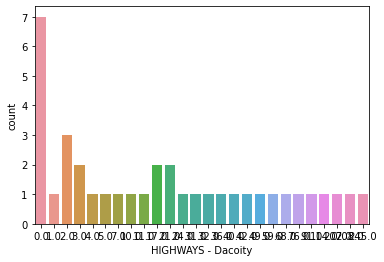

0.000      18.919
6.000       8.108
44.000      5.405
43.000      2.703
112.000     2.703
2015.000    2.703
279.000     2.703
3.000       2.703
87.000      2.703
48.000      2.703
511.000     2.703
17.000      2.703
443.000     2.703
300.000     2.703
121.000     2.703
172.000     2.703
475.000     2.703
5.000       2.703
155.000     2.703
134.000     2.703
12.000      2.703
203.000     2.703
8.000       2.703
115.000     2.703
1396.000    2.703
136.000     2.703
15.000      2.703
171.000     2.703
Name: HIGHWAYS - Robbery, dtype: float64


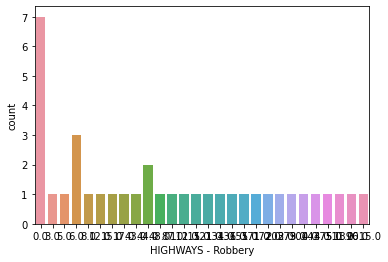

0.000     37.838
7.000      5.405
6.000      5.405
172.000    2.703
56.000     2.703
14.000     2.703
131.000    2.703
11.000     2.703
126.000    2.703
78.000     2.703
36.000     2.703
91.000     2.703
188.000    2.703
24.000     2.703
9.000      2.703
111.000    2.703
26.000     2.703
234.000    2.703
147.000    2.703
157.000    2.703
3.000      2.703
2.000      2.703
Name: HIGHWAYS - Burglary, dtype: float64


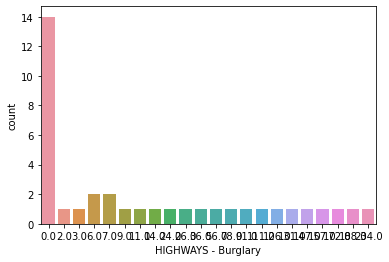

0.000       16.216
144.000      5.405
17.000       5.405
262.000      2.703
122.000      2.703
21662.000    2.703
15.000       2.703
1353.000     2.703
311.000      2.703
894.000      2.703
351.000      2.703
61.000       2.703
39.000       2.703
87.000       2.703
771.000      2.703
912.000      2.703
544.000      2.703
842.000      2.703
651.000      2.703
91.000       2.703
51.000       2.703
1081.000     2.703
227.000      2.703
318.000      2.703
1.000        2.703
20.000       2.703
650.000      2.703
385.000      2.703
23.000       2.703
256.000      2.703
Name: HIGHWAYS - Theft, dtype: float64


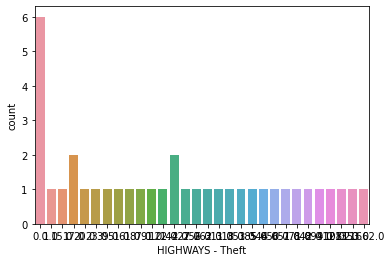

0.000   62.162
1.000   16.216
2.000   10.811
3.000    5.405
6.000    2.703
7.000    2.703
Name: RIVER and SEA - Dacoity, dtype: float64


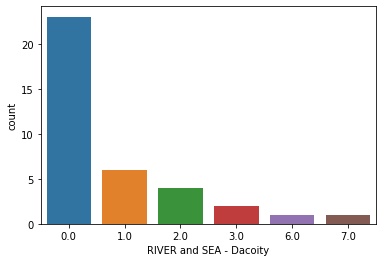

0.000    51.351
1.000    10.811
3.000     8.108
5.000     5.405
2.000     5.405
8.000     5.405
11.000    2.703
21.000    2.703
4.000     2.703
16.000    2.703
10.000    2.703
Name: RIVER and SEA - Robbery, dtype: float64


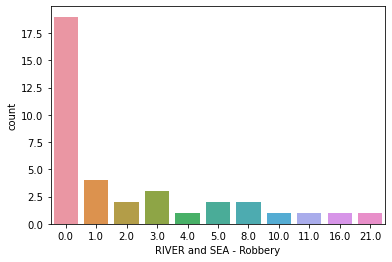

0.000     78.378
1.000      8.108
101.000    2.703
11.000     2.703
2.000      2.703
30.000     2.703
3.000      2.703
Name: RIVER and SEA - Burglary, dtype: float64


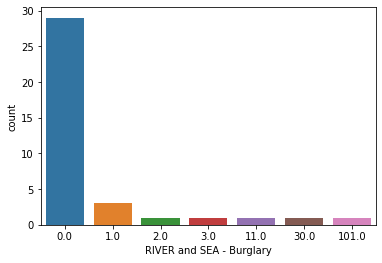

0.000     24.324
1.000     13.514
3.000     10.811
15.000     5.405
2.000      5.405
12.000     5.405
8.000      2.703
43.000     2.703
5.000      2.703
250.000    2.703
91.000     2.703
10.000     2.703
28.000     2.703
6.000      2.703
96.000     2.703
110.000    2.703
4.000      2.703
23.000     2.703
44.000     2.703
Name: RIVER and SEA - Theft, dtype: float64


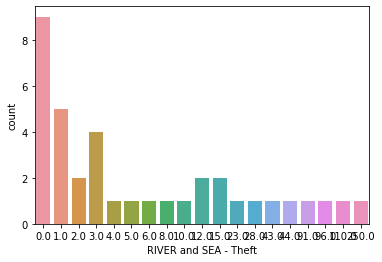

0.000    43.243
1.000    10.811
8.000     8.108
2.000     8.108
10.000    5.405
6.000     5.405
79.000    2.703
25.000    2.703
34.000    2.703
7.000     2.703
4.000     2.703
22.000    2.703
30.000    2.703
Name: RAILWAYS - Dacoity, dtype: float64


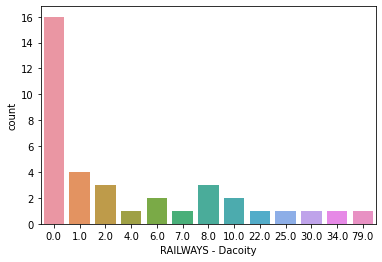

0.000     35.135
2.000      8.108
8.000      5.405
48.000     2.703
216.000    2.703
74.000     2.703
3.000      2.703
147.000    2.703
515.000    2.703
67.000     2.703
9.000      2.703
70.000     2.703
43.000     2.703
6.000      2.703
1.000      2.703
22.000     2.703
109.000    2.703
14.000     2.703
20.000     2.703
79.000     2.703
16.000     2.703
31.000     2.703
Name: RAILWAYS - Robbery, dtype: float64


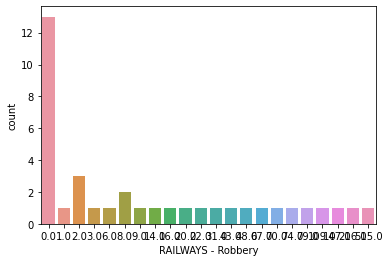

0.000    37.838
3.000    10.811
1.000     5.405
4.000     5.405
71.000    2.703
20.000    2.703
18.000    2.703
36.000    2.703
69.000    2.703
30.000    2.703
67.000    2.703
37.000    2.703
56.000    2.703
72.000    2.703
26.000    2.703
10.000    2.703
46.000    2.703
88.000    2.703
12.000    2.703
Name: RAILWAYS - Burglary, dtype: float64


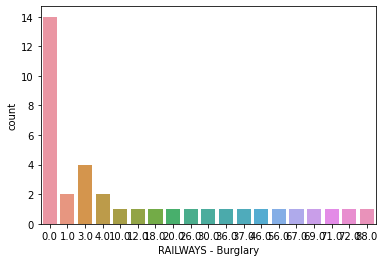

0.000      32.432
1685.000    2.703
65.000      2.703
3141.000    2.703
25.000      2.703
320.000     2.703
733.000     2.703
59.000      2.703
897.000     2.703
9.000       2.703
13.000      2.703
3604.000    2.703
2089.000    2.703
304.000     2.703
651.000     2.703
423.000     2.703
470.000     2.703
3.000       2.703
520.000     2.703
1178.000    2.703
26.000      2.703
1430.000    2.703
344.000     2.703
1447.000    2.703
603.000     2.703
1140.000    2.703
Name: RAILWAYS - Theft, dtype: float64


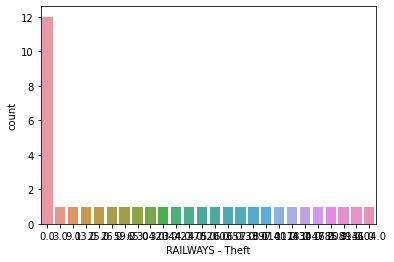

0.000    29.730
1.000    16.216
2.000    10.811
4.000     8.108
3.000     8.108
10.000    8.108
5.000     2.703
29.000    2.703
11.000    2.703
17.000    2.703
12.000    2.703
27.000    2.703
6.000     2.703
Name: BANKS - Dacoity, dtype: float64


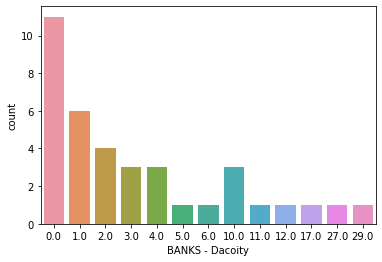

0.000     27.027
1.000      8.108
18.000     8.108
2.000      8.108
5.000      5.405
15.000     5.405
4.000      5.405
3.000      5.405
12.000     2.703
11.000     2.703
9.000      2.703
25.000     2.703
88.000     2.703
16.000     2.703
13.000     2.703
55.000     2.703
17.000     2.703
140.000    2.703
Name: BANKS - Robbery, dtype: float64


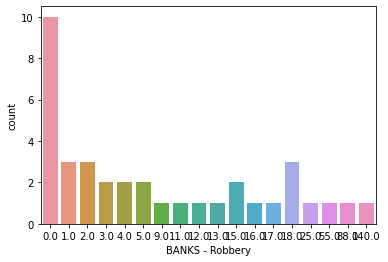

1.000     16.216
4.000      8.108
0.000      8.108
2.000      5.405
17.000     5.405
3.000      5.405
26.000     2.703
48.000     2.703
12.000     2.703
39.000     2.703
97.000     2.703
82.000     2.703
15.000     2.703
197.000    2.703
52.000     2.703
11.000     2.703
69.000     2.703
62.000     2.703
38.000     2.703
75.000     2.703
37.000     2.703
33.000     2.703
10.000     2.703
6.000      2.703
9.000      2.703
Name: BANKS - Burglary, dtype: float64


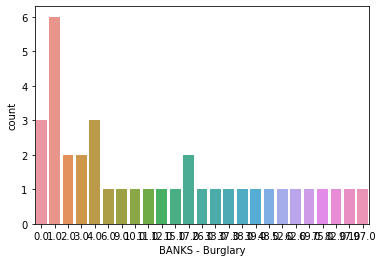

0.000     18.919
2.000      8.108
4.000      5.405
7.000      5.405
5.000      5.405
15.000     2.703
49.000     2.703
61.000     2.703
44.000     2.703
132.000    2.703
62.000     2.703
17.000     2.703
381.000    2.703
78.000     2.703
1.000      2.703
90.000     2.703
333.000    2.703
99.000     2.703
29.000     2.703
172.000    2.703
33.000     2.703
87.000     2.703
254.000    2.703
21.000     2.703
34.000     2.703
63.000     2.703
Name: BANKS - Theft, dtype: float64


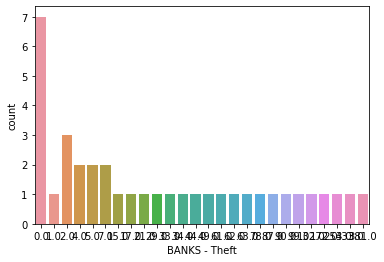

0.000     16.216
3.000      8.108
4.000      8.108
10.000     5.405
22.000     5.405
13.000     5.405
2.000      5.405
36.000     5.405
28.000     5.405
6.000      5.405
5.000      2.703
14.000     2.703
58.000     2.703
48.000     2.703
24.000     2.703
34.000     2.703
82.000     2.703
30.000     2.703
56.000     2.703
8.000      2.703
127.000    2.703
Name: COMMERCIAL ESTABLISHMENTS - Dacoity, dtype: float64


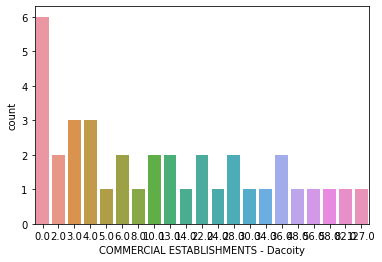

1.000     10.811
0.000     10.811
54.000     5.405
4.000      5.405
59.000     2.703
10.000     2.703
77.000     2.703
25.000     2.703
150.000    2.703
41.000     2.703
159.000    2.703
27.000     2.703
40.000     2.703
197.000    2.703
92.000     2.703
76.000     2.703
89.000     2.703
32.000     2.703
21.000     2.703
137.000    2.703
5.000      2.703
58.000     2.703
2.000      2.703
33.000     2.703
22.000     2.703
120.000    2.703
143.000    2.703
28.000     2.703
72.000     2.703
Name: COMMERCIAL ESTABLISHMENTS - Robbery, dtype: float64


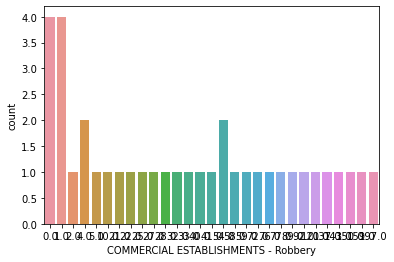

44.000     8.108
0.000      5.405
19.000     2.703
37.000     2.703
1774.000   2.703
3471.000   2.703
185.000    2.703
65.000     2.703
617.000    2.703
1875.000   2.703
661.000    2.703
15.000     2.703
609.000    2.703
66.000     2.703
688.000    2.703
136.000    2.703
4.000      2.703
844.000    2.703
1330.000   2.703
1342.000   2.703
188.000    2.703
432.000    2.703
235.000    2.703
1078.000   2.703
1109.000   2.703
130.000    2.703
624.000    2.703
34.000     2.703
511.000    2.703
119.000    2.703
330.000    2.703
674.000    2.703
84.000     2.703
53.000     2.703
Name: COMMERCIAL ESTABLISHMENTS - Burglary, dtype: float64


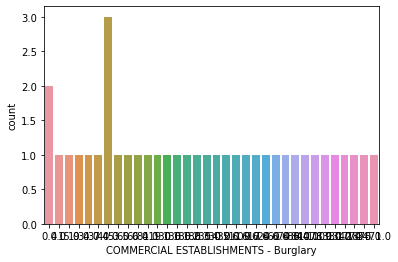

221.000    5.405
0.000      5.405
31.000     2.703
1576.000   2.703
3618.000   2.703
5545.000   2.703
181.000    2.703
351.000    2.703
112.000    2.703
68.000     2.703
1097.000   2.703
1743.000   2.703
29.000     2.703
2845.000   2.703
146.000    2.703
1342.000   2.703
16.000     2.703
595.000    2.703
3445.000   2.703
14.000     2.703
99.000     2.703
1257.000   2.703
1918.000   2.703
732.000    2.703
571.000    2.703
84.000     2.703
2981.000   2.703
2487.000   2.703
104.000    2.703
3021.000   2.703
3295.000   2.703
125.000    2.703
520.000    2.703
1501.000   2.703
2339.000   2.703
Name: COMMERCIAL ESTABLISHMENTS - Theft, dtype: float64


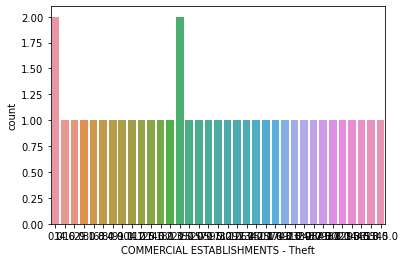

4.000     8.108
5.000     5.405
7.000     5.405
1.000     5.405
0.000     5.405
210.000   2.703
89.000    2.703
21.000    2.703
237.000   2.703
11.000    2.703
66.000    2.703
56.000    2.703
40.000    2.703
157.000   2.703
18.000    2.703
3.000     2.703
38.000    2.703
8.000     2.703
528.000   2.703
90.000    2.703
108.000   2.703
77.000    2.703
87.000    2.703
182.000   2.703
112.000   2.703
15.000    2.703
100.000   2.703
315.000   2.703
20.000    2.703
6.000     2.703
128.000   2.703
Name: OTHER PLACES - Dacoity, dtype: float64


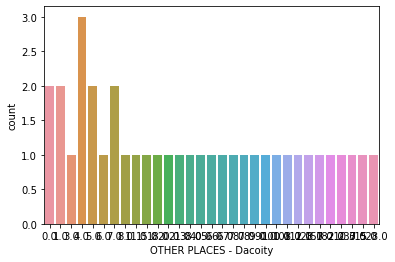

0.000      8.108
12.000     2.703
10.000     2.703
5510.000   2.703
11.000     2.703
72.000     2.703
16.000     2.703
63.000     2.703
757.000    2.703
130.000    2.703
780.000    2.703
7.000      2.703
1337.000   2.703
48.000     2.703
1461.000   2.703
141.000    2.703
1767.000   2.703
609.000    2.703
331.000    2.703
5.000      2.703
41.000     2.703
646.000    2.703
1084.000   2.703
62.000     2.703
403.000    2.703
6.000      2.703
474.000    2.703
1791.000   2.703
21.000     2.703
1142.000   2.703
459.000    2.703
23.000     2.703
100.000    2.703
202.000    2.703
507.000    2.703
Name: OTHER PLACES - Robbery, dtype: float64


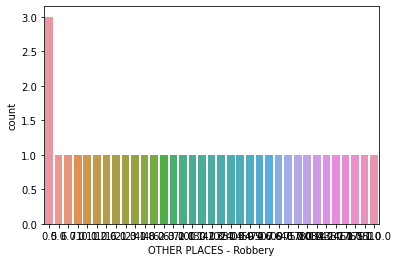

0.000      5.405
1762.000   2.703
2801.000   2.703
3464.000   2.703
29.000     2.703
85.000     2.703
442.000    2.703
65.000     2.703
1040.000   2.703
27.000     2.703
889.000    2.703
1228.000   2.703
23.000     2.703
1649.000   2.703
61.000     2.703
1804.000   2.703
188.000    2.703
5.000      2.703
31.000     2.703
1356.000   2.703
10.000     2.703
89.000     2.703
2105.000   2.703
753.000    2.703
44.000     2.703
604.000    2.703
26.000     2.703
632.000    2.703
2112.000   2.703
87.000     2.703
1474.000   2.703
687.000    2.703
283.000    2.703
582.000    2.703
186.000    2.703
375.000    2.703
Name: OTHER PLACES - Burglary, dtype: float64


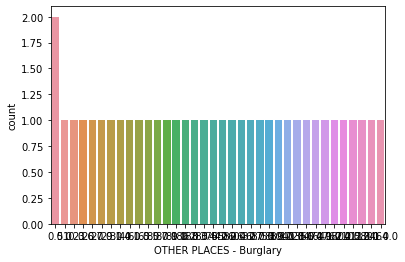

0.000       5.405
14693.000   2.703
12394.000   2.703
36345.000   2.703
433.000     2.703
397.000     2.703
777.000     2.703
191.000     2.703
5395.000    2.703
645.000     2.703
3127.000    2.703
18831.000   2.703
64.000      2.703
11335.000   2.703
212.000     2.703
11817.000   2.703
1804.000    2.703
7.000       2.703
91.000      2.703
3665.000    2.703
47.000      2.703
249.000     2.703
5401.000    2.703
7354.000    2.703
995.000     2.703
3985.000    2.703
72.000      2.703
15436.000   2.703
12918.000   2.703
767.000     2.703
13229.000   2.703
9610.000    2.703
904.000     2.703
1721.000    2.703
2683.000    2.703
14482.000   2.703
Name: OTHER PLACES - Theft, dtype: float64


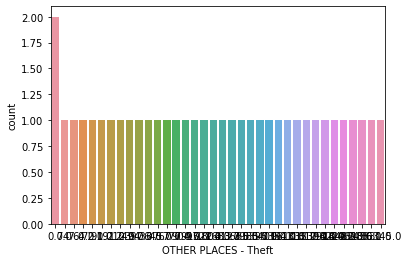

176.000    5.405
204.000    5.405
10.000     5.405
48.000     5.405
8.000      5.405
0.000      5.405
71.000     2.703
2.000      2.703
65.000     2.703
166.000    2.703
36.000     2.703
417.000    2.703
21.000     2.703
905.000    2.703
97.000     2.703
20.000     2.703
811.000    2.703
5.000      2.703
3.000      2.703
250.000    2.703
273.000    2.703
702.000    2.703
42.000     2.703
804.000    2.703
7.000      2.703
18.000     2.703
6.000      2.703
1319.000   2.703
532.000    2.703
37.000     2.703
288.000    2.703
Name: TOTAL - Dacoity, dtype: float64


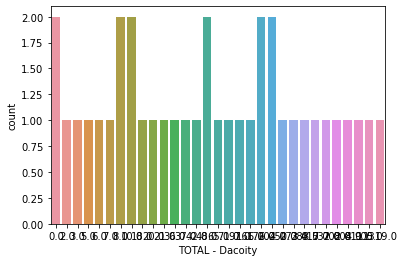

0.000      8.108
14.000     2.703
16.000     2.703
6949.000   2.703
19.000     2.703
133.000    2.703
23.000     2.703
129.000    2.703
1613.000   2.703
241.000    2.703
889.000    2.703
9.000      2.703
2066.000   2.703
95.000     2.703
3825.000   2.703
191.000    2.703
2270.000   2.703
869.000    2.703
794.000    2.703
6.000      2.703
96.000     2.703
907.000    2.703
2986.000   2.703
68.000     2.703
554.000    2.703
12.000     2.703
624.000    2.703
2207.000   2.703
39.000     2.703
1420.000   2.703
734.000    2.703
29.000     2.703
163.000    2.703
864.000    2.703
816.000    2.703
Name: TOTAL - Robbery, dtype: float64


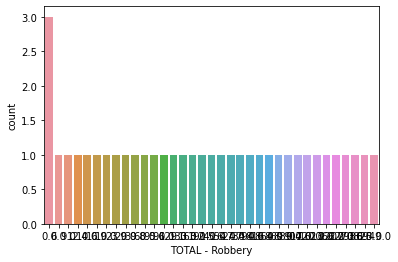

0.000       5.405
9050.000    2.703
13549.000   2.703
16617.000   2.703
76.000      2.703
203.000     2.703
487.000     2.703
163.000     2.703
3430.000    2.703
129.000     2.703
2828.000    2.703
7284.000    2.703
93.000      2.703
5965.000    2.703
239.000     2.703
8411.000    2.703
566.000     2.703
9.000       2.703
99.000      2.703
4624.000    2.703
60.000      2.703
263.000     2.703
3825.000    2.703
3758.000    2.703
364.000     2.703
4144.000    2.703
98.000      2.703
3029.000    2.703
6629.000    2.703
376.000     2.703
5844.000    2.703
5129.000    2.703
995.000     2.703
1566.000    2.703
1610.000    2.703
739.000     2.703
Name: TOTAL - Burglary, dtype: float64


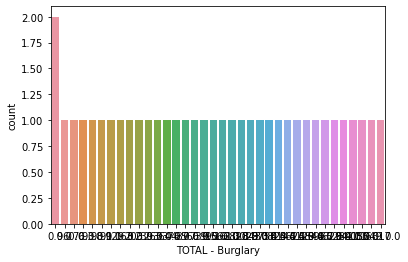

0.000       5.405
28267.000   2.703
24583.000   2.703
53449.000   2.703
903.000     2.703
696.000     2.703
1303.000    2.703
397.000     2.703
9630.000    2.703
787.000     2.703
5624.000    2.703
23314.000   2.703
127.000     2.703
18755.000   2.703
565.000     2.703
37376.000   2.703
2138.000    2.703
20.000      2.703
134.000     2.703
5818.000    2.703
63.000      2.703
531.000     2.703
9394.000    2.703
17667.000   2.703
1991.000    2.703
6079.000    2.703
174.000     2.703
23088.000   2.703
20576.000   2.703
1115.000    2.703
20715.000   2.703
17590.000   2.703
1152.000    2.703
2655.000    2.703
7716.000    2.703
22991.000   2.703
Name: TOTAL - Theft, dtype: float64


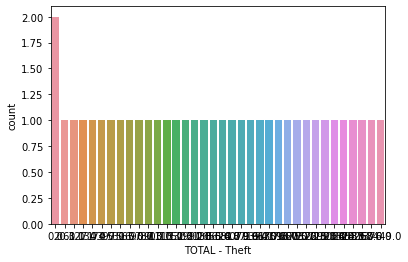

0.000     32.432
1.000     13.514
6.000     10.811
11.000     5.405
9.000      5.405
3.000      5.405
4.000      5.405
45.000     2.703
96.000     2.703
233.000    2.703
21.000     2.703
15.000     2.703
13.000     2.703
7.000      2.703
22.000     2.703
Name: Cases_Registered_under_Human_Rights_Violations, dtype: float64


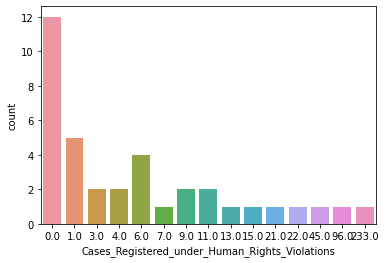

0.000    43.243
5.000    10.811
7.000     8.108
1.000     8.108
6.000     5.405
4.000     5.405
29.000    2.703
2.000     2.703
67.000    2.703
20.000    2.703
9.000     2.703
3.000     2.703
53.000    2.703
Name: Policemen_Chargesheeted, dtype: float64


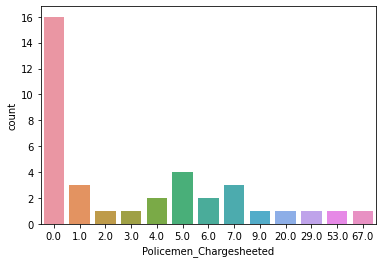

0.000    89.189
2.000     2.703
4.000     2.703
54.000    2.703
3.000     2.703
Name: Policemen_Convicted, dtype: float64


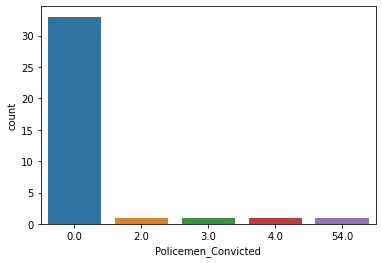

0.000      5.405
1442.000   2.703
3425.000   2.703
1839.000   2.703
63.000     2.703
164.000    2.703
103.000    2.703
23.000     2.703
1458.000   2.703
13.000     2.703
680.000    2.703
2049.000   2.703
34.000     2.703
737.000    2.703
238.000    2.703
2042.000   2.703
148.000    2.703
2.000      2.703
24.000     2.703
1132.000   2.703
5.000      2.703
59.000     2.703
1721.000   2.703
1555.000   2.703
33.000     2.703
1053.000   2.703
14.000     2.703
706.000    2.703
636.000    2.703
55.000     2.703
473.000    2.703
733.000    2.703
183.000    2.703
303.000    2.703
855.000    2.703
2363.000   2.703
Name: Rape_y.1, dtype: float64


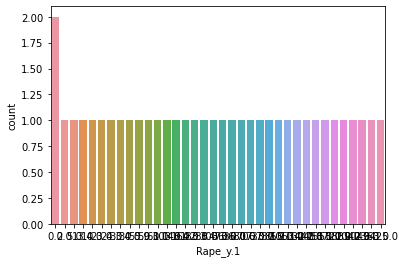

0.000      5.405
10.000     5.405
28.000     5.405
3.000      5.405
16.000     2.703
1127.000   2.703
1252.000   2.703
133.000    2.703
37.000     2.703
1364.000   2.703
14.000     2.703
1.000      2.703
2713.000   2.703
1743.000   2.703
116.000    2.703
7910.000   2.703
283.000    2.703
689.000    2.703
221.000    2.703
1612.000   2.703
1070.000   2.703
786.000    2.703
1041.000   2.703
191.000    2.703
900.000    2.703
1527.000   2.703
2160.000   2.703
365.000    2.703
66.000     2.703
3789.000   2.703
3360.000   2.703
60.000     2.703
4168.000   2.703
Name: Kidnapping and Abduction, dtype: float64


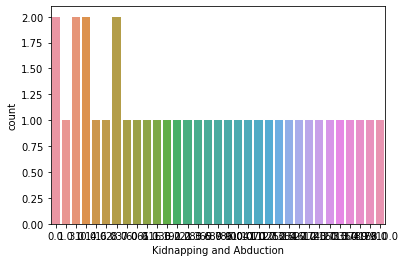

0.000      10.811
1.000      10.811
2.000       5.405
10.000      5.405
6.000       5.405
94.000      2.703
2322.000    2.703
37.000      2.703
243.000     2.703
514.000     2.703
166.000     2.703
525.000     2.703
4.000       2.703
436.000     2.703
892.000     2.703
33.000      2.703
613.000     2.703
267.000     2.703
303.000     2.703
21.000      2.703
302.000     2.703
67.000      2.703
3.000       2.703
143.000     2.703
128.000     2.703
1413.000    2.703
175.000     2.703
593.000     2.703
Name: Dowry Deaths, dtype: float64


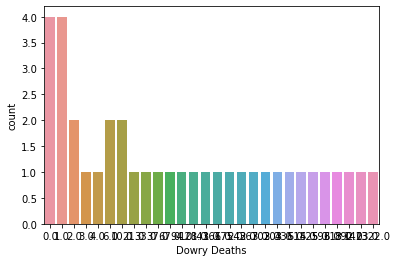

0.000      5.405
5147.000   2.703
7118.000   2.703
3935.000   2.703
70.000     2.703
74.000     2.703
88.000     2.703
16.000     2.703
4187.000   2.703
89.000     2.703
427.000    2.703
2878.000   2.703
40.000     2.703
2022.000   2.703
384.000    2.703
3455.000   2.703
153.000    2.703
2.000      2.703
31.000     2.703
3756.000   2.703
4.000      2.703
84.000     2.703
1840.000   2.703
999.000    2.703
45.000     2.703
1763.000   2.703
22.000     2.703
868.000    2.703
2978.000   2.703
49.000     2.703
828.000    2.703
525.000    2.703
350.000    2.703
1322.000   2.703
424.000    2.703
3345.000   2.703
Name: Assault on women with intent to outrage her modesty, dtype: float64


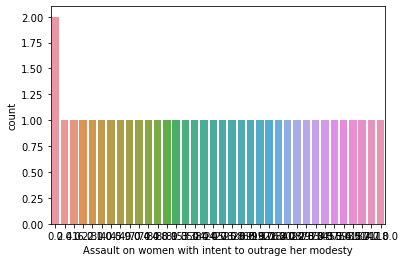

0.000      8.108
4.000      8.108
199.000    2.703
918.000    2.703
1294.000   2.703
2.000      2.703
3.000      2.703
458.000    2.703
39.000     2.703
10.000     2.703
573.000    2.703
14.000     2.703
1718.000   2.703
9.000      2.703
4970.000   2.703
306.000    2.703
56.000     2.703
100.000    2.703
4562.000   2.703
83.000     2.703
376.000    2.703
78.000     2.703
1424.000   2.703
164.000    2.703
16.000     2.703
225.000    2.703
1.000      2.703
182.000    2.703
28.000     2.703
53.000     2.703
20.000     2.703
6.000      2.703
556.000    2.703
Name: Insult to modesty of Women, dtype: float64


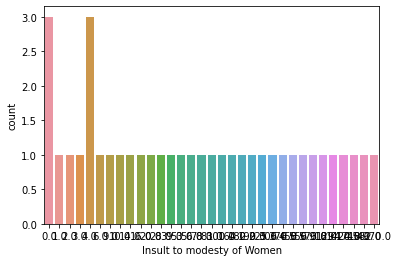

26.000      5.405
0.000       5.405
6407.000    2.703
3988.000    2.703
463.000     2.703
8566.000    2.703
937.000     2.703
1976.000    2.703
7.000       2.703
13312.000   2.703
1293.000    2.703
19.000      2.703
2638.000    2.703
4.000       2.703
16.000      2.703
32.000      2.703
43.000      2.703
7829.000    2.703
2.000       2.703
3686.000    2.703
13389.000   2.703
5377.000    2.703
3712.000    2.703
1261.000    2.703
301.000     2.703
343.000     2.703
3137.000    2.703
6658.000    2.703
24.000      2.703
1985.000    2.703
5.000       2.703
10.000      2.703
980.000     2.703
112.000     2.703
19865.000   2.703
Name: Cruelty by Husband or his Relatives, dtype: float64


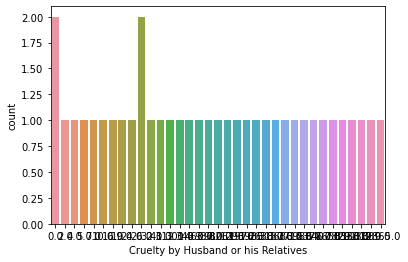

0.000    48.649
3.000    13.514
1.000    10.811
2.000     5.405
7.000     2.703
83.000    2.703
39.000    2.703
32.000    2.703
45.000    2.703
12.000    2.703
14.000    2.703
61.000    2.703
Name: Importation of Girls, dtype: float64


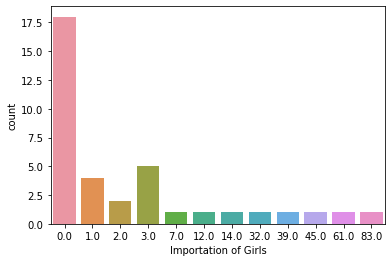

In [18]:
# Catplot:

for i in crimes_data.columns[1:128]:
    
    sns.countplot(crimes_data[i])
    print(crimes_data[i].value_counts(normalize=True)*100)
    plt.show()

In [19]:
crimes_data.columns

Index(['State/UT', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS',
       ...
       'Cases_Registered_under_Human_Rights_Violations',
       'Policemen_Chargesheeted', 'Policemen_Convicted', 'Rape_y.1',
       'Kidnapping and Abduction', 'Dowry Deaths',
       'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives',
       'Importation of Girls'],
      dtype='object', length=128)

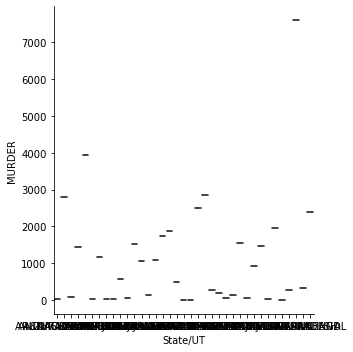

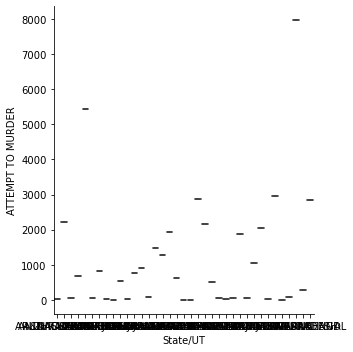

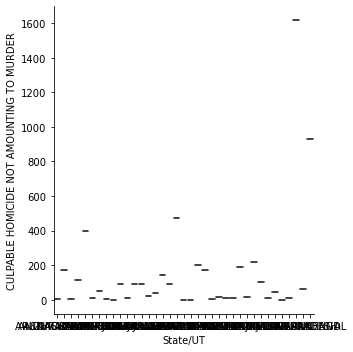

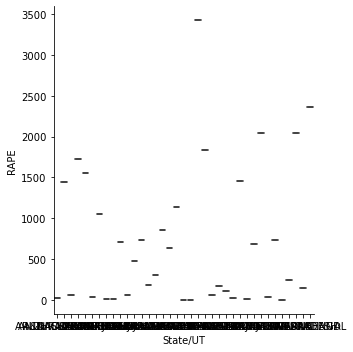

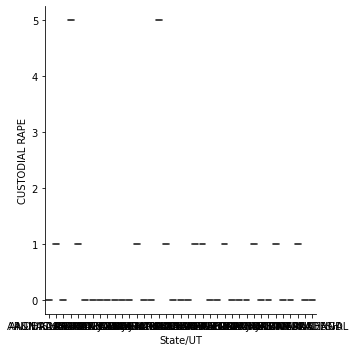

...

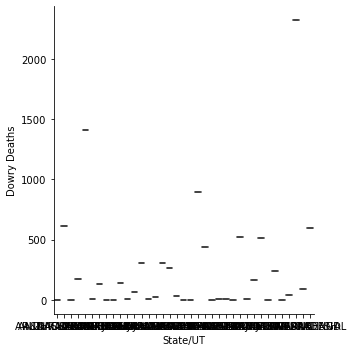

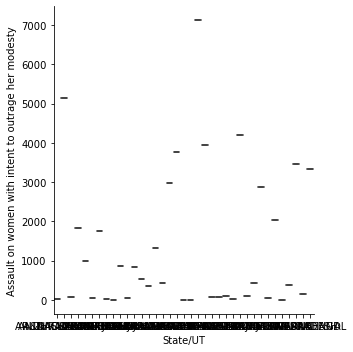

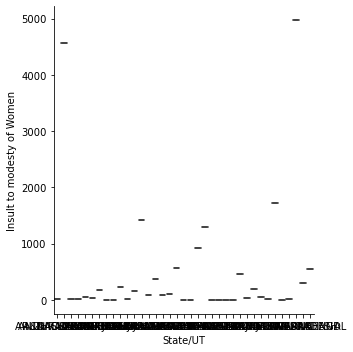

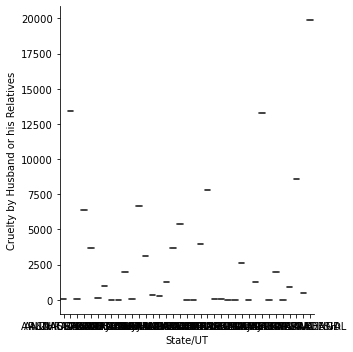

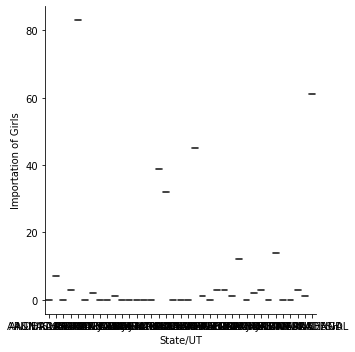

In [20]:
# categorical box plots:

for i in crimes_data.columns[1:128]:
    sns.catplot(x=crimes_data.columns[0], y=i, kind="box", data=crimes_data)